In [ ]:
import pandas as pd
import numpy as np
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer

df = pd.read_excel("/content/drive/MyDrive/tnew.xlsx")
df = df.loc[:, ~df.columns.duplicated()]

# Time transformation
time_cols = ["Inbound Handle Time","Outbound Handle Time","Talk Time","Hold Time","Wait Time","Login Time","ACW Time"]
for col in time_cols:
    df[col] = pd.to_timedelta(df[col], errors="coerce").dt.total_seconds()

# Call volumes
df["Inbound Handled"] = df["Inbound Handled"].fillna(0)
df["Outbound Handled"] = df["Outbound Handled"].fillna(0)
df["Total Calls"] = df["Inbound Handled"] + df["Outbound Handled"]

# Performance metrics
df["AHT"] = (df["Inbound Handle Time"] + df["Outbound Handle Time"]) / df["Total Calls"].replace(0, np.nan)
df["Occupancy %"] = ((df["Talk Time"] + df["Hold Time"] + df["ACW Time"]) / df["Login Time"]) * 100
df["ACW %"] = (df["ACW Time"] / df["Handle Time"].replace(0, np.nan)) * 100
df["SLA %"] = (df["In SLA"] / df["Total Calls"].replace(0, np.nan)) * 100
df["Complaint_Flag"] = np.where(df["Complaint"].notnull(), 1, 0)

# Transcript sentiment (numeric score)
df["Transcript_Sentiment"] = df["Transcript"].dropna().apply(lambda x: TextBlob(str(x)).sentiment.polarity)

# Normalize Sentiment Class
df["Sentiment_Class"] = df["Sentiment"].str.lower().map({
    "positive":"Positive","negative":"Negative","neutral":"Neutral"
})

# Disposition normalization
df["Disposition_Clean"] = df["Disposition"].str.strip().str.title()

# Extract top keywords globally
vectorizer = CountVectorizer(stop_words="english", max_features=20)
X = vectorizer.fit_transform(df["Transcript"].dropna())
keywords = vectorizer.get_feature_names_out()
df["Top_Keywords"] = ",".join(keywords)

df.to_csv("clean_agent_transcripts.csv", index=False)


In [ ]:
import pandas as pd
import numpy as np
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer

# ===============================
# 1. Load and Basic Cleaning
# ===============================
df = pd.read_excel("/content/drive/MyDrive/tnew.xlsx")

# Drop duplicate columns (Handled.1, etc.)
df = df.loc[:, ~df.columns.duplicated()]

# ===============================
# 2. Date Conversion
# ===============================
# Ensure Date column is proper datetime
df["Date"] = pd.to_datetime(df["Date"], errors="coerce")

# Create derived time features
df["YearMonth"] = df["Date"].dt.to_period("M").astype(str)   # e.g., 2025-09
df["Week"] = df["Date"].dt.to_period("W").astype(str)        # e.g., 2025-09-22/2025-09-28

# ===============================
# 3. Ensure Numeric for Time Metrics
# (values already in SECONDS, no timedelta conversion needed)
# ===============================
time_cols = [
    "Inbound Handle Time", "Outbound Handle Time", "Talk Time",
    "Hold Time", "Wait Time", "Login Time", "ACW Time"
]

for col in time_cols:
    df[col] = pd.to_numeric(df[col], errors="coerce")

# ===============================
# 4. Call Volumes
# ===============================
df["Inbound Handled"] = df["Inbound Handled"].fillna(0)
df["Outbound Handled"] = df["Outbound Handled"].fillna(0)
df["Total Calls"] = df["Inbound Handled"] + df["Outbound Handled"]

# ===============================
# 5. Agent Performance KPIs
# ===============================
df["AHT"] = (df["Inbound Handle Time"] + df["Outbound Handle Time"]) / df["Total Calls"].replace(0, np.nan)
df["Occupancy %"] = ((df["Talk Time"] + df["Hold Time"] + df["ACW Time"]) / df["Login Time"]) * 100
df["ACW %"] = (df["ACW Time"] / df["Handle Time"].replace(0, np.nan)) * 100
df["SLA %"] = (df["In SLA"] / df["Total Calls"].replace(0, np.nan)) * 100

# ===============================
# 6. Complaint Handling (Simple Flag)
# ===============================
df["Complaint_Flag"] = np.where(df["Complaint"].notnull(), 1, 0)

# ===============================
# 7. Transcript-Based Features
# ===============================

# Numeric Sentiment Score (-1 to +1)
df["Transcript_Sentiment"] = df["Transcript"].dropna().apply(
    lambda x: TextBlob(str(x)).sentiment.polarity
)

# Standardize Sentiment Labels (already in your file)
df["Sentiment_Class"] = df["Sentiment"].astype(str).str.lower().map({
    "positive": "Positive",
    "negative": "Negative",
    "neutral": "Neutral"
})

# Normalize Disposition text
df["Disposition_Clean"] = df["Disposition"].astype(str).str.strip().str.title()

# Keyword Extraction (Top 20 words across transcripts)
vectorizer = CountVectorizer(stop_words="english", max_features=20)
X = vectorizer.fit_transform(df["Transcript"].dropna())
keywords = vectorizer.get_feature_names_out()
df["Top_Keywords"] = ",".join(keywords)

# ===============================
# 8. Export Clean Dataset
# ===============================
df.to_csv("clean_agent_transcripts.csv", index=False)

print("✅ Preprocessing complete. File saved as 'clean_agent_transcripts.csv'")


✅ Preprocessing complete. File saved as 'clean_agent_transcripts.csv'


/tmp/ipython-input-917817395.py:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agent_kpis, x="Agent Name", y="Total Calls", palette="Blues_d")


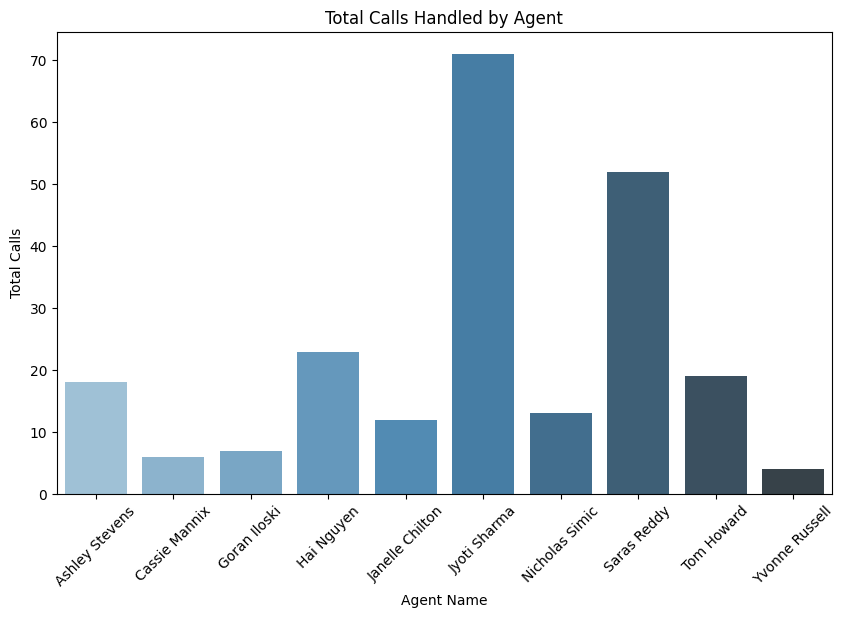

/tmp/ipython-input-917817395.py:49: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agent_kpis, x="Agent Name", y="AHT", palette="viridis")


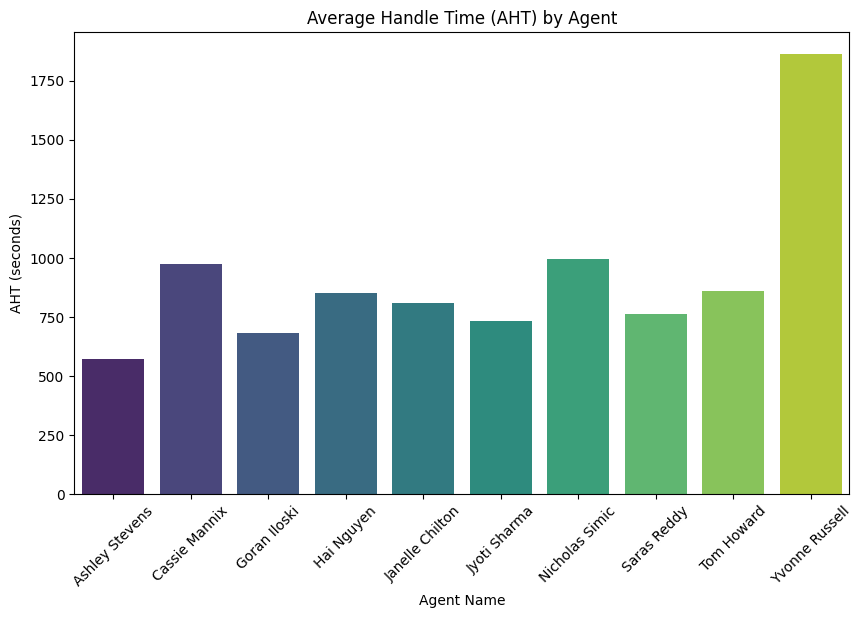

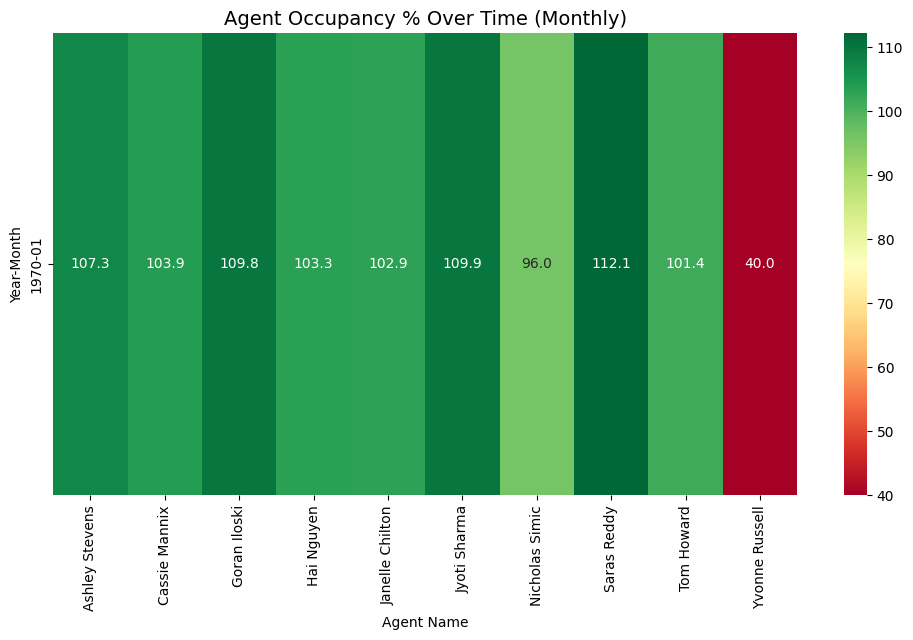

/tmp/ipython-input-917817395.py:70: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agent_kpis, x="Agent Name", y="Complaint Rate", palette="Reds")


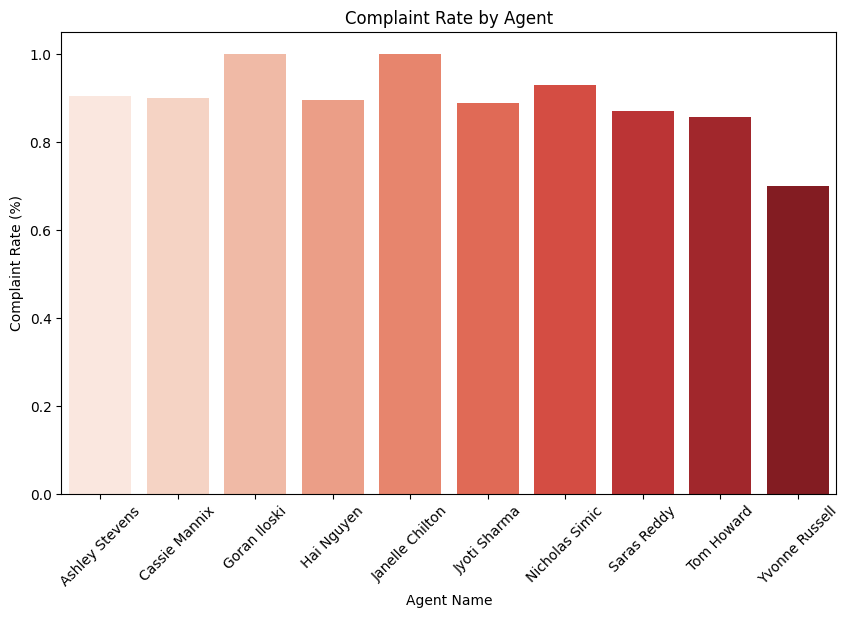

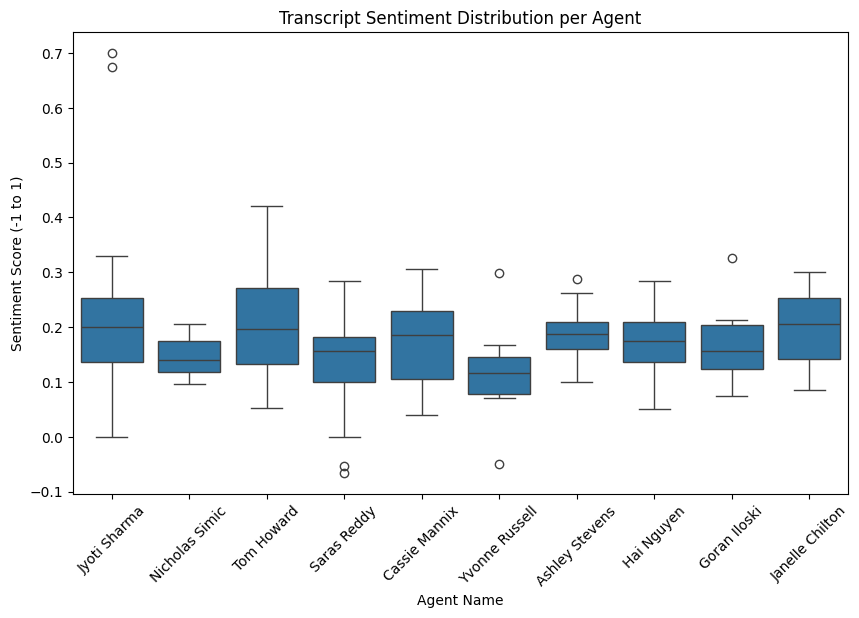

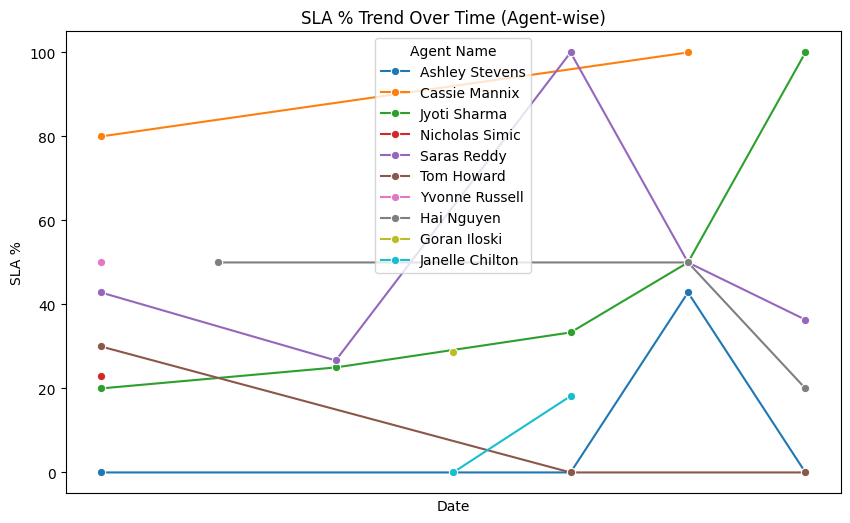

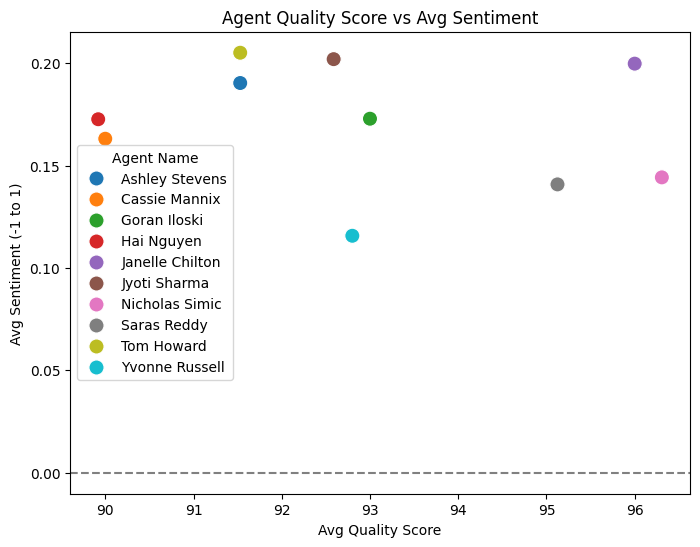

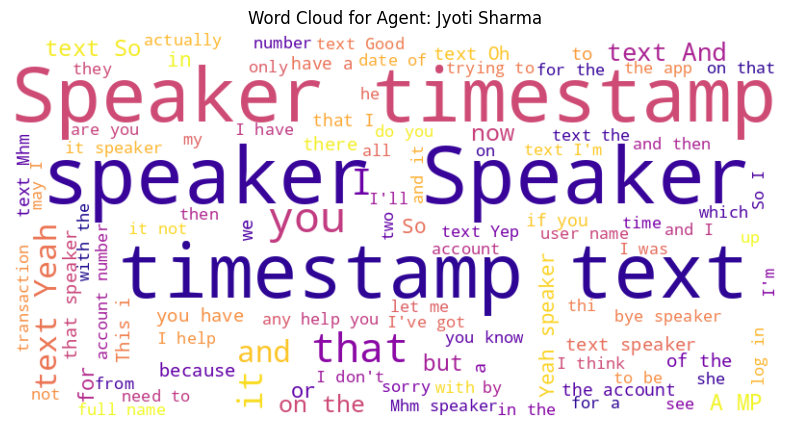

...

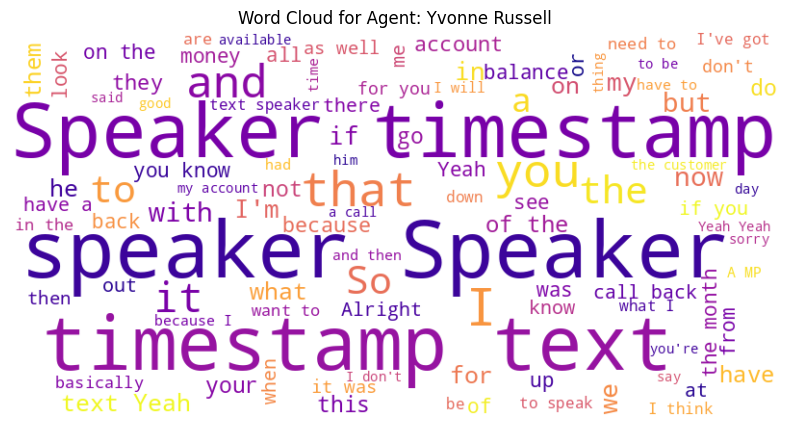

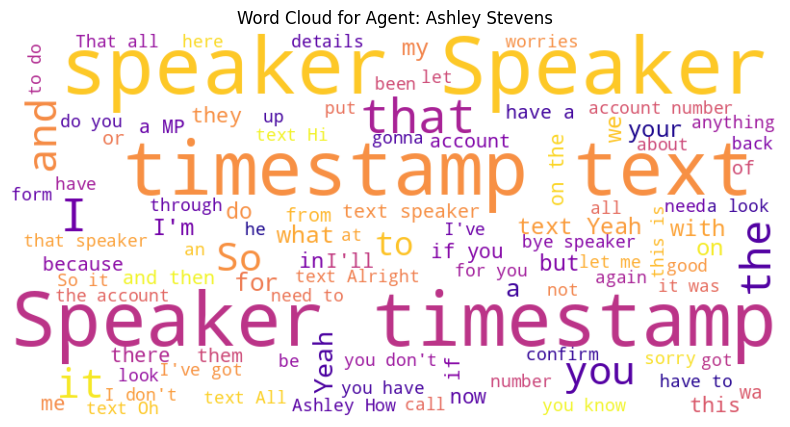

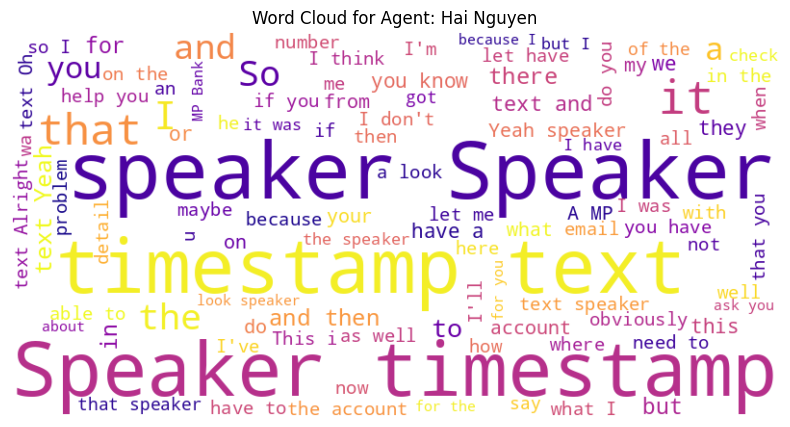

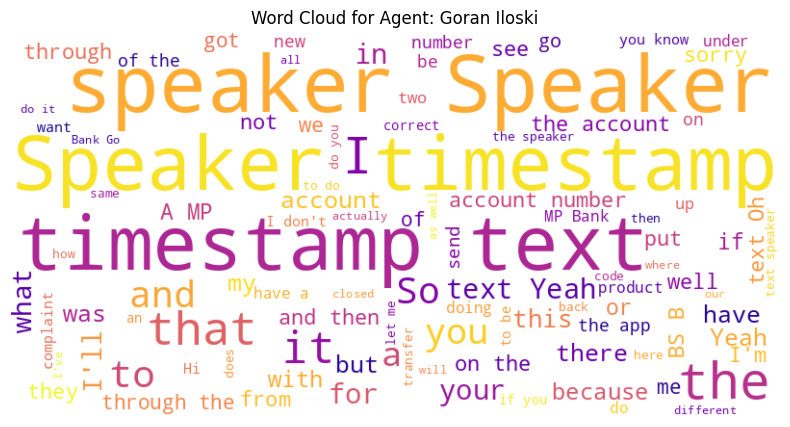

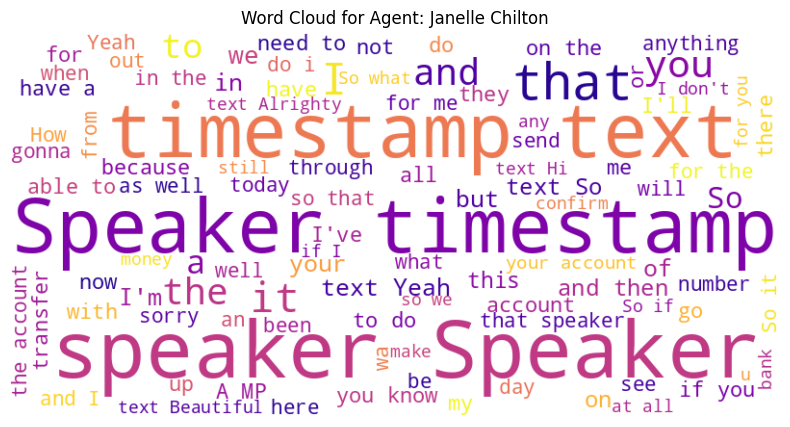

ValueError: could not convert string to float: 'Ashley Stevens'

<Figure size 800x600 with 0 Axes>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# ===================================
# 1. Load Data
# ===================================
# Cleaned transcripts data
#df = pd.read_csv("/content/clean_agent_transcripts_v1.csv")

# KPI Reference Table (for documentation, not used directly in calcs)
#kpi_table = pd.read_excel("Transformation_KPI_Table.xlsx")

# Ensure Date is datetime
df["Date"] = pd.to_datetime(df["Date"], errors="coerce")

# ===================================
# 2. Aggregate Agent KPIs
# ===================================
agent_kpis = df.groupby("Agent Name").agg({
    "Total Calls": "sum",
    "AHT": "mean",
    "Occupancy %": "mean",
    "ACW %": "mean",
    "SLA %": "mean",
    "Quality Score": "mean",
    "Complaint_Flag": "mean",
    "Transcript_Sentiment": "mean"
}).reset_index()

agent_kpis.rename(columns={"Complaint_Flag": "Complaint Rate",
                           "Transcript_Sentiment": "Avg Sentiment"}, inplace=True)

# ===================================
# 3. Visualizations
# ===================================

# ----- 3.1 Calls handled per agent -----
plt.figure(figsize=(10,6))
sns.barplot(data=agent_kpis, x="Agent Name", y="Total Calls", palette="Blues_d")
plt.title("Total Calls Handled by Agent")
plt.xticks(rotation=45)
plt.show()

# ----- 3.2 AHT comparison -----
plt.figure(figsize=(10,6))
sns.barplot(data=agent_kpis, x="Agent Name", y="AHT", palette="viridis")
plt.title("Average Handle Time (AHT) by Agent")
plt.xticks(rotation=45)
plt.ylabel("AHT (seconds)")
plt.show()
# Use weekly or monthly aggregation for Occupancy %
df_occ = df.groupby(["YearMonth", "Agent Name"])["Occupancy %"].mean().reset_index()

# Pivot: rows = YearMonth, cols = Agent Name, values = Occupancy %
occ_pivot = df_occ.pivot(index="YearMonth", columns="Agent Name", values="Occupancy %")

plt.figure(figsize=(12,6))
sns.heatmap(occ_pivot, cmap="RdYlGn", annot=True, fmt=".1f")
plt.title("Agent Occupancy % Over Time (Monthly)", fontsize=14)
plt.ylabel("Year-Month")
plt.xlabel("Agent Name")
plt.show()


# ----- 3.4 Complaint rate -----
plt.figure(figsize=(10,6))
sns.barplot(data=agent_kpis, x="Agent Name", y="Complaint Rate", palette="Reds")
plt.title("Complaint Rate by Agent")
plt.xticks(rotation=45)
plt.ylabel("Complaint Rate (%)")
plt.show()

# ----- 3.5 Sentiment distribution -----
plt.figure(figsize=(10,6))
sns.boxplot(data=df, x="Agent Name", y="Transcript_Sentiment")
plt.title("Transcript Sentiment Distribution per Agent")
plt.xticks(rotation=45)
plt.ylabel("Sentiment Score (-1 to 1)")
plt.show()

# ----- 3.6 SLA performance -----
plt.figure(figsize=(10,6))
sns.lineplot(data=df.groupby(["Date","Agent Name"])["SLA %"].mean().reset_index(),
             x="Date", y="SLA %", hue="Agent Name", marker="o")
plt.title("SLA % Trend Over Time (Agent-wise)")
plt.xticks(rotation=45)
plt.show()

# ----- 3.7 Quality Score vs Sentiment (scatter) -----
plt.figure(figsize=(8,6))
sns.scatterplot(data=agent_kpis, x="Quality Score", y="Avg Sentiment", hue="Agent Name", s=120)
plt.title("Agent Quality Score vs Avg Sentiment")
plt.xlabel("Avg Quality Score")
plt.ylabel("Avg Sentiment (-1 to 1)")
plt.axhline(0, color="gray", linestyle="--")
plt.show()

# ----- 3.8 Word Cloud (Agent-wise) -----
stopwords = set(["um","uh","yes","no","okay","ok","thank","thanks",
                 "please","hello","right","just","like","can","would","also","one","get"])

for agent in df["Agent Name"].unique():
    text = " ".join(df[df["Agent Name"]==agent]["Transcript"].dropna().astype(str).tolist())
    if text.strip() == "":
        continue
    wc = WordCloud(width=800, height=400, background_color="white",
                   stopwords=stopwords, max_words=100, colormap="plasma").generate(text)
    plt.figure(figsize=(10,5))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Word Cloud for Agent: {agent}")
    plt.show()

# ----- 3.9 Correlation Heatmap -----
plt.figure(figsize=(8,6))
sns.heatmap(agent_kpis.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation between Agent KPIs")
plt.show()

# ===================================
# 4. Export Agent KPI Summary
# ===================================
agent_kpis.to_excel("Agent_KPI_Summary.xlsx", index=False)
print("✅ KPI visualizations generated and Agent KPI summary exported as Agent_KPI_Summary.xlsx")


In [ ]:
# ======================================
# 1. Load Clean Data (from preprocessing)
# ======================================
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

df = pd.read_csv("/content/clean_agent_transcripts_v1.csv")

# Set plot style
sns.set(style="whitegrid", palette="muted", font_scale=1.1)


/tmp/ipython-input-485187912.py:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=df, x="Agent Name", y="AHT", ci=None)


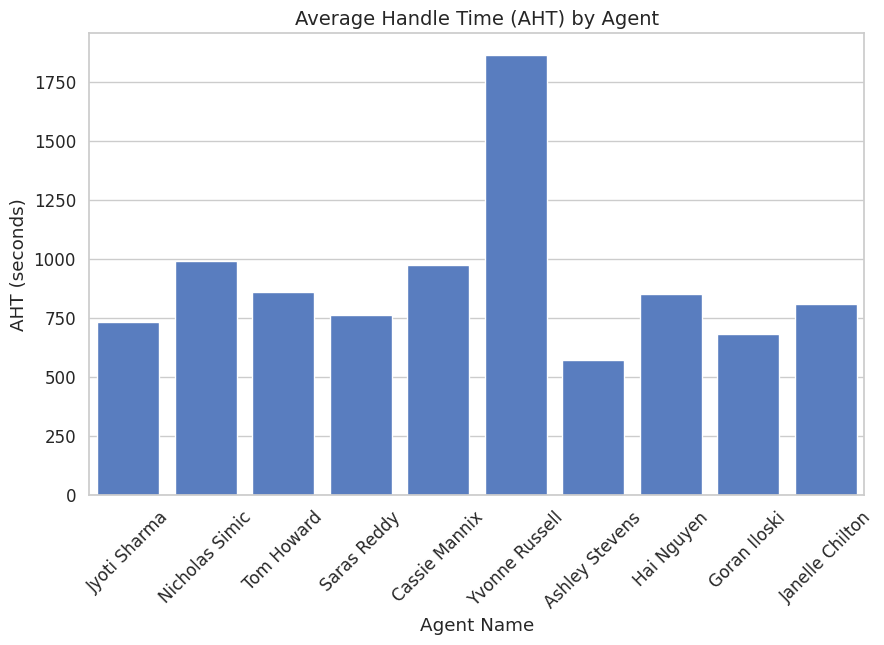

In [ ]:
# ======================================
# 2. Agent Performance – AHT by Agent
# ======================================
plt.figure(figsize=(10,6))
sns.barplot(data=df, x="Agent Name", y="AHT", ci=None)
plt.title("Average Handle Time (AHT) by Agent", fontsize=14)
plt.xticks(rotation=45)
plt.ylabel("AHT (seconds)")
plt.show()


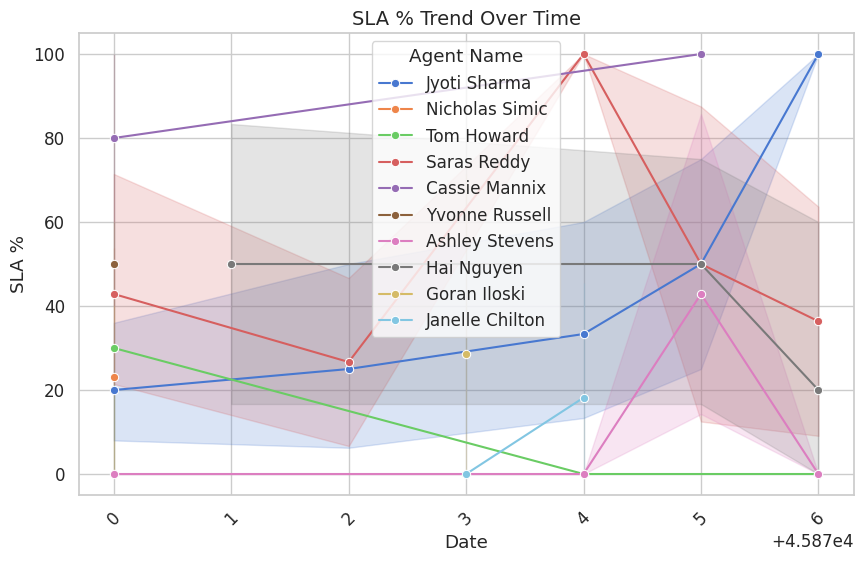

In [ ]:
# ======================================
# 3. SLA % Trend Over Time
# ======================================
plt.figure(figsize=(10,6))
sns.lineplot(data=df, x="Date", y="SLA %", hue="Agent Name", marker="o")
plt.title("SLA % Trend Over Time", fontsize=14)
plt.ylabel("SLA %")
plt.xticks(rotation=45)
plt.show()


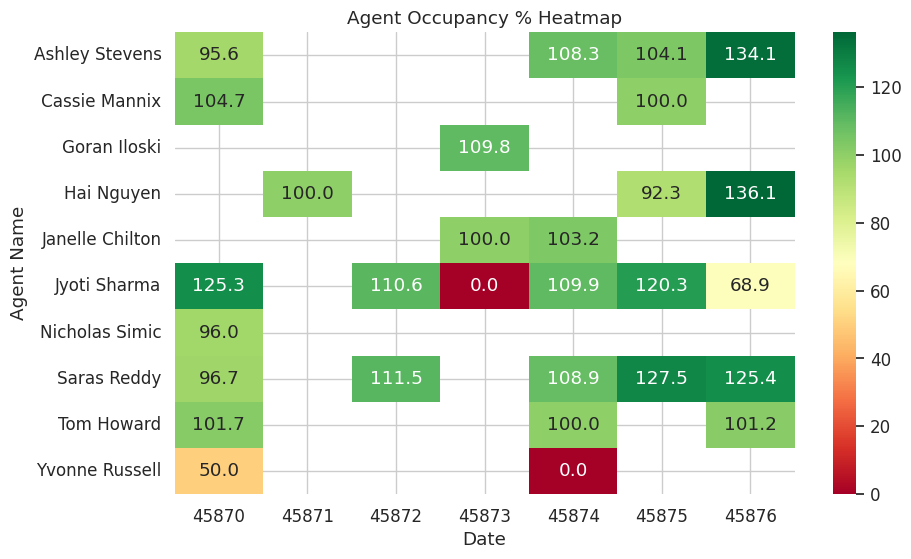

In [ ]:
# ======================================
# 4. Occupancy % by Agent
# ======================================
plt.figure(figsize=(10,6))
sns.heatmap(df.pivot_table(values="Occupancy %", index="Agent Name", columns="Date"),
            cmap="RdYlGn", annot=True, fmt=".1f")
plt.title("Agent Occupancy % Heatmap")
plt.show()


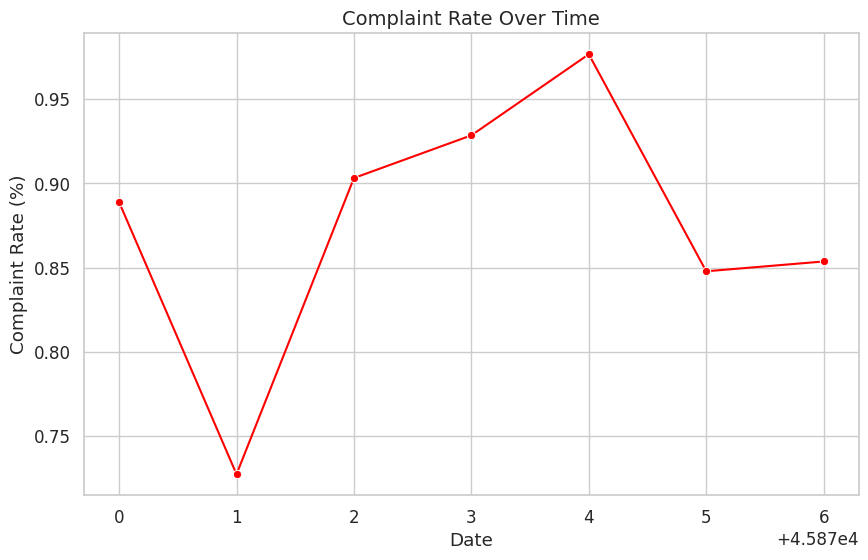

In [ ]:
# ======================================
# 5. Complaint Rate Over Time
# ======================================
complaint_trend = df.groupby("Date")["Complaint_Flag"].mean().reset_index()

plt.figure(figsize=(10,6))
sns.lineplot(data=complaint_trend, x="Date", y="Complaint_Flag", marker="o", color="red")
plt.title("Complaint Rate Over Time", fontsize=14)
plt.ylabel("Complaint Rate (%)")
plt.show()


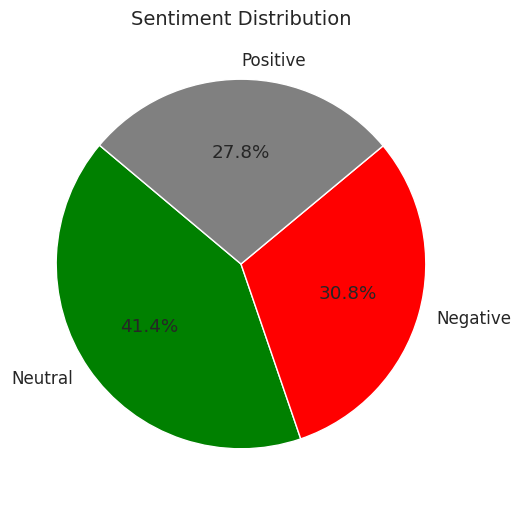

In [ ]:
# ======================================
# 6. Sentiment Distribution (Pie Chart)
# ======================================
sentiment_counts = df["Sentiment_Class"].value_counts()

plt.figure(figsize=(6,6))
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct="%1.1f%%", startangle=140,
        colors=["green","red","gray"])
plt.title("Sentiment Distribution", fontsize=14)
plt.show()


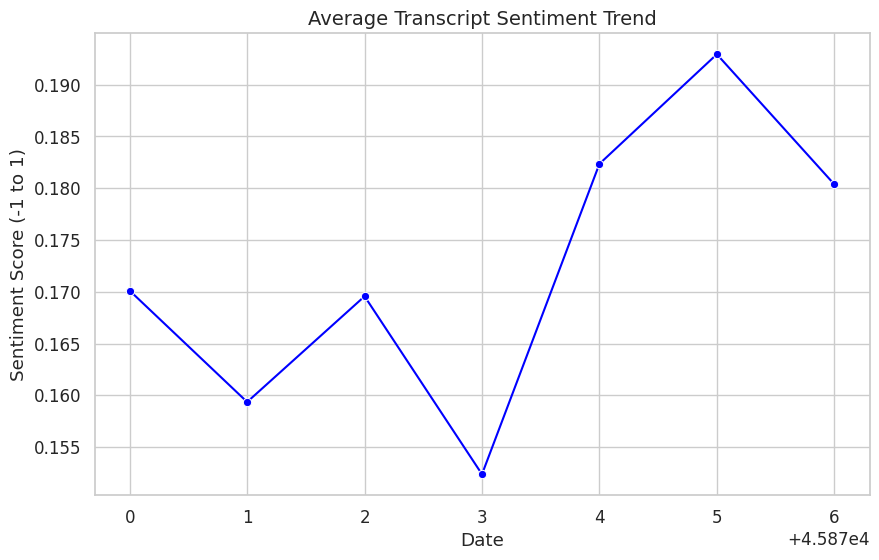

In [ ]:
# ======================================
# 7. Average Transcript Sentiment Trend
# ======================================
sentiment_trend = df.groupby("Date")["Transcript_Sentiment"].mean().reset_index()

plt.figure(figsize=(10,6))
sns.lineplot(data=sentiment_trend, x="Date", y="Transcript_Sentiment", marker="o", color="blue")
plt.title("Average Transcript Sentiment Trend", fontsize=14)
plt.ylabel("Sentiment Score (-1 to 1)")
plt.show()


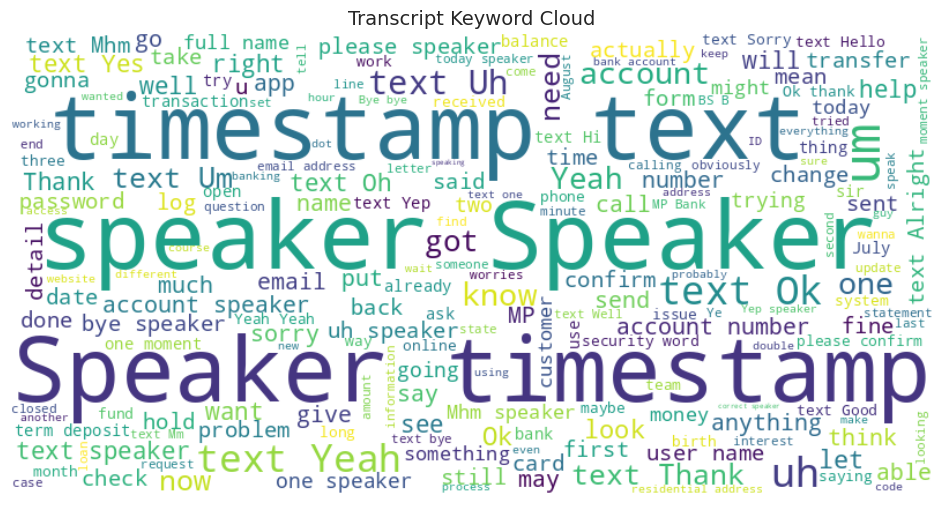

In [ ]:
# ======================================
# 8. Word Cloud – Top Keywords in Transcripts
# ======================================
text = " ".join(df["Transcript"].dropna().astype(str))

wordcloud = WordCloud(width=800, height=400, background_color="white", colormap="viridis").generate(text)

plt.figure(figsize=(12,6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title("Transcript Keyword Cloud", fontsize=14)
plt.show()


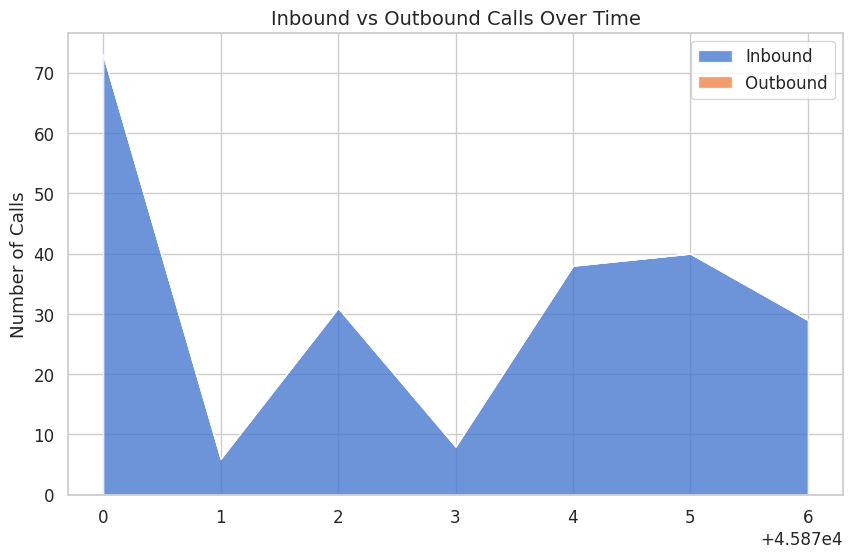

In [ ]:
# ======================================
# 9. Inbound vs Outbound Calls
# ======================================
df_grouped = df.groupby("Date")[["Inbound Handled","Outbound Handled"]].sum().reset_index()

plt.figure(figsize=(10,6))
plt.stackplot(df_grouped["Date"], df_grouped["Inbound Handled"], df_grouped["Outbound Handled"],
              labels=["Inbound","Outbound"], alpha=0.8)
plt.title("Inbound vs Outbound Calls Over Time", fontsize=14)
plt.ylabel("Number of Calls")
plt.legend()
plt.show()


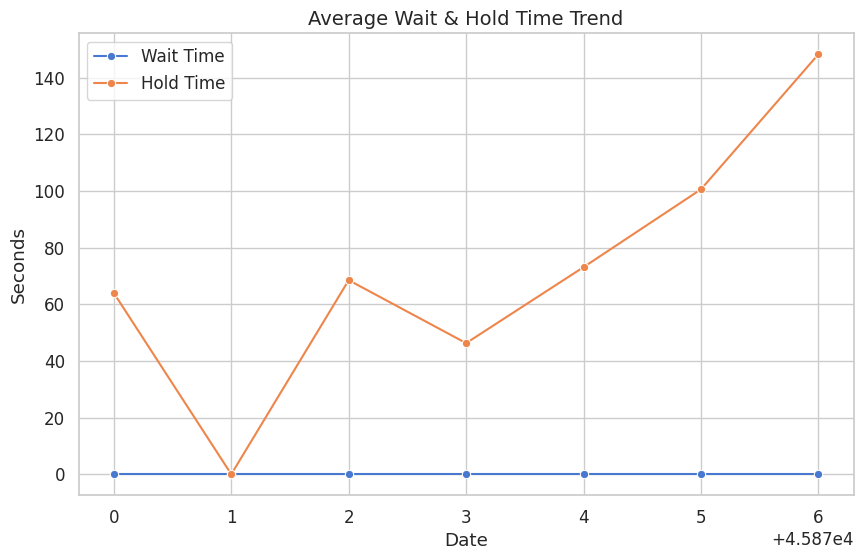

In [ ]:
# ======================================
# 10. Wait and Hold Time Trend
# ======================================
time_trend = df.groupby("Date")[["Wait Time","Hold Time"]].mean().reset_index()

plt.figure(figsize=(10,6))
sns.lineplot(data=time_trend, x="Date", y="Wait Time", marker="o", label="Wait Time")
sns.lineplot(data=time_trend, x="Date", y="Hold Time", marker="o", label="Hold Time")
plt.title("Average Wait & Hold Time Trend", fontsize=14)
plt.ylabel("Seconds")
plt.legend()
plt.show()


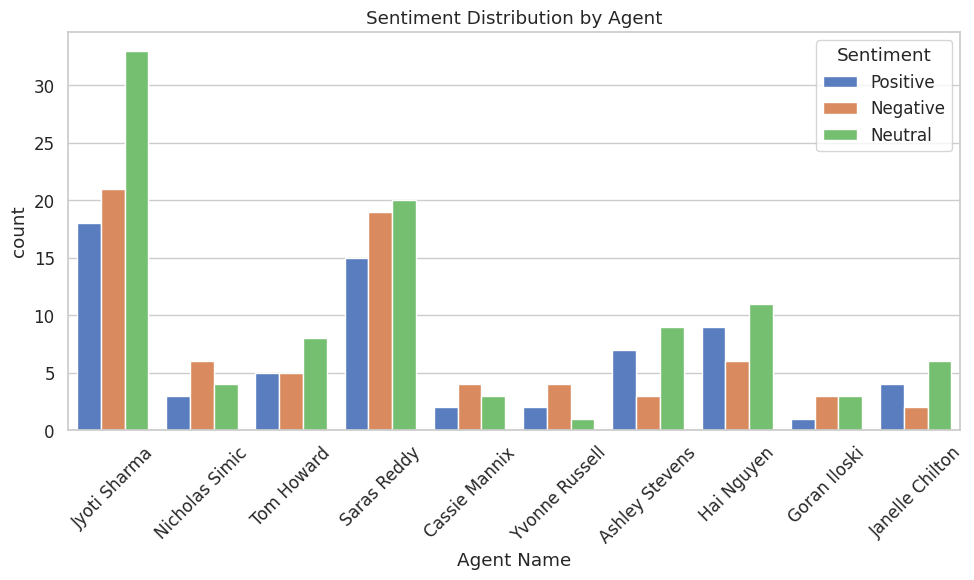

/tmp/ipython-input-1160698347.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agent_sent, x="Transcript_Sentiment", y="Agent Name", palette="viridis")


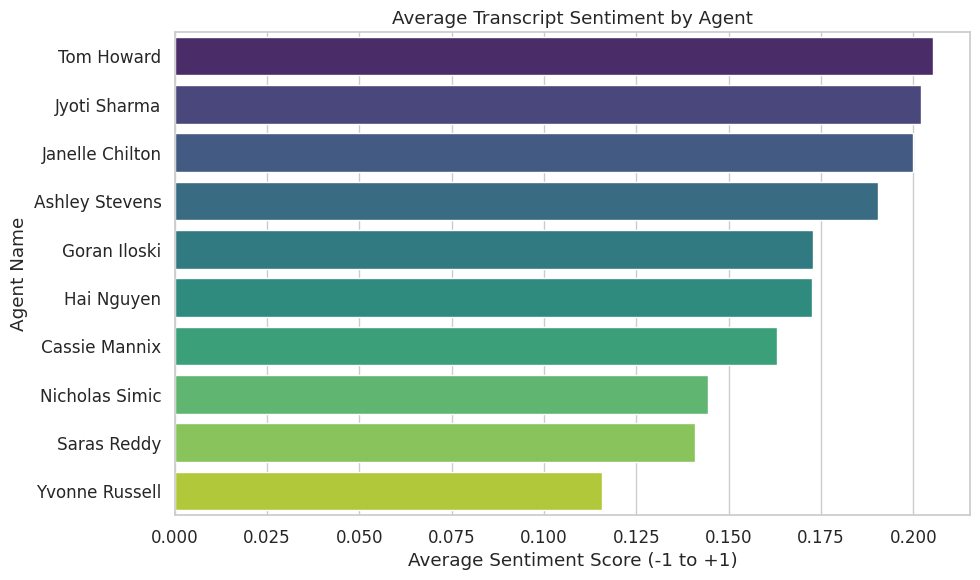

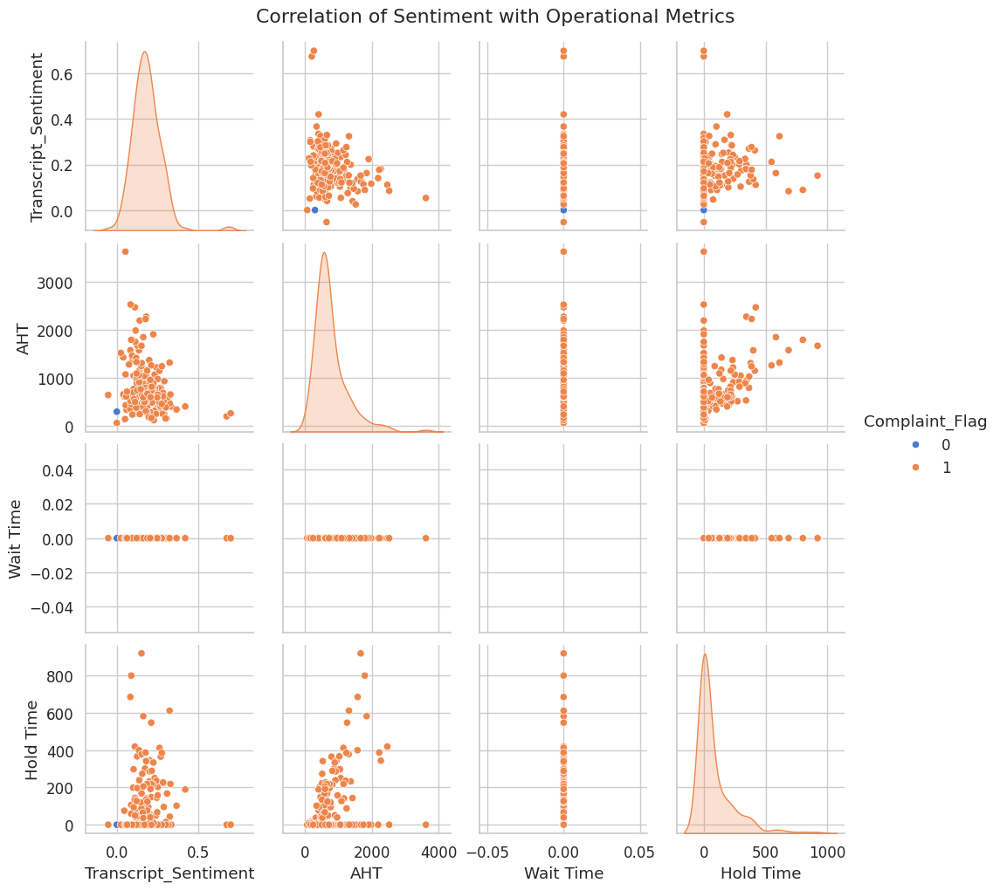

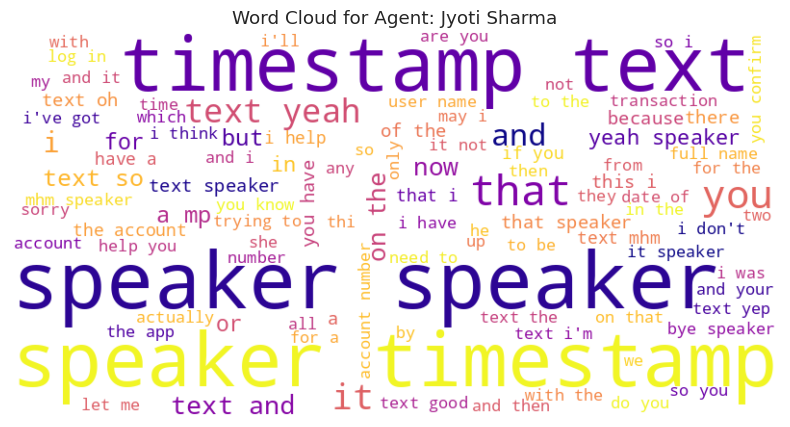

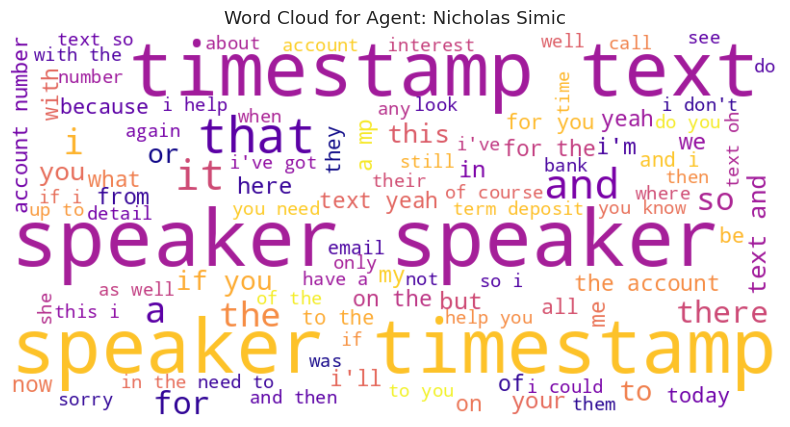

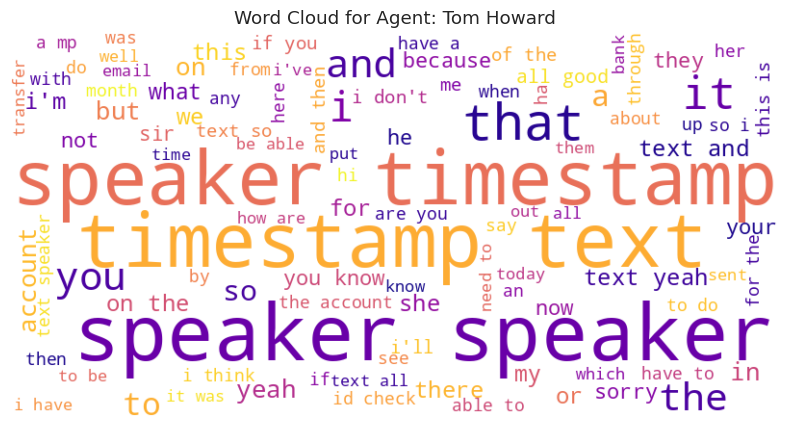

...

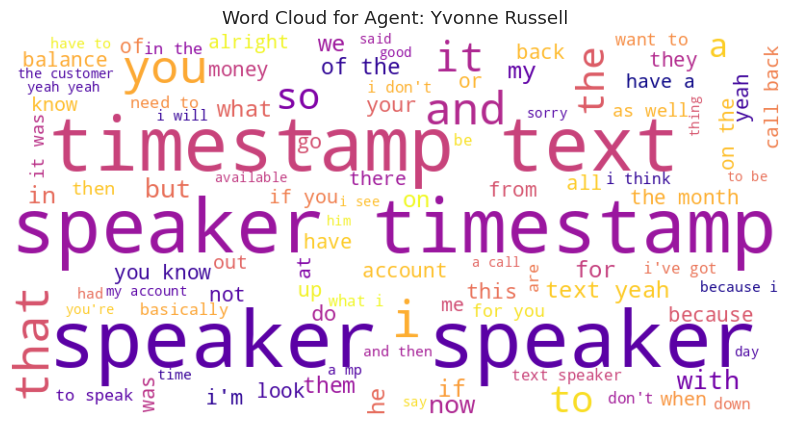

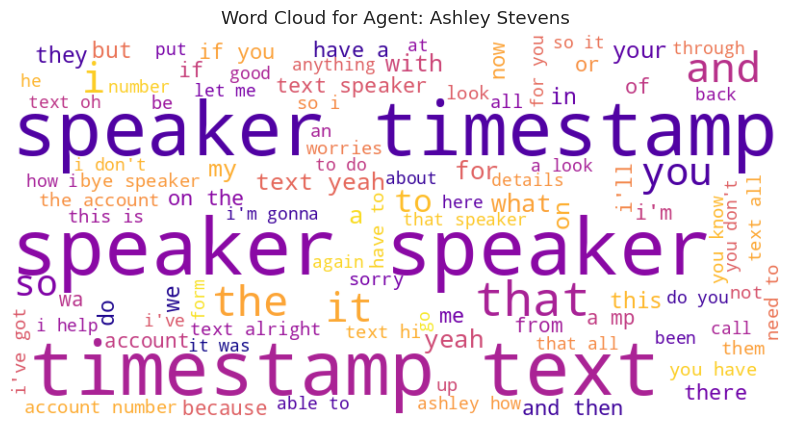

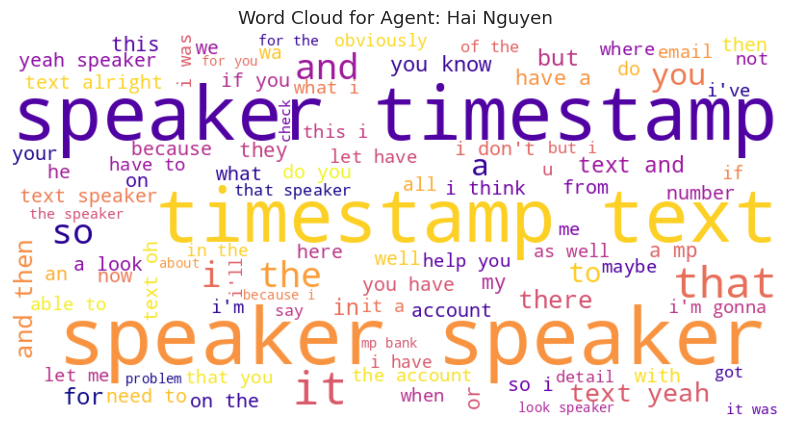

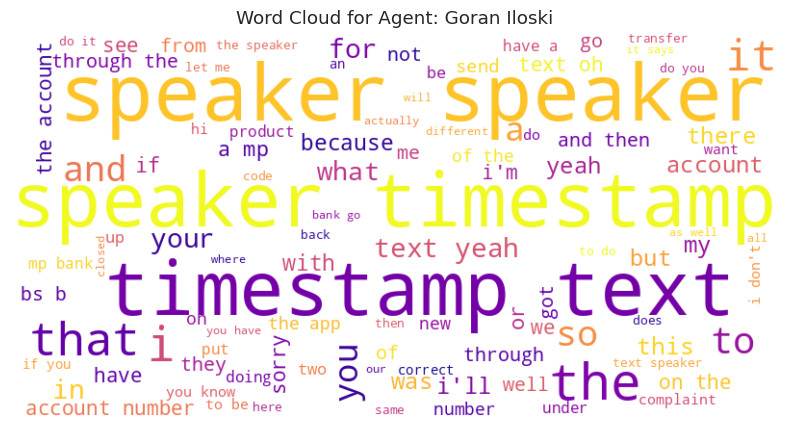

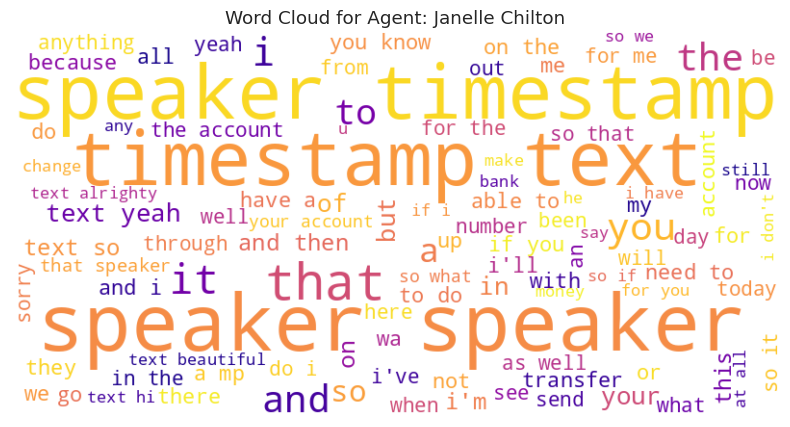

Topic 1: got, user, oh, log, number, yes, mp, app, ve, password
Topic 2: balance, need, transfer, month, let, got, yes, know, ve, like
Topic 3: look, think, number, mp, bank, got, like, don, ve, know
Topic 4: send, mp, address, know, form, yes, ve, need, email, number
Topic 5: sorry, bye, ve, got, yes, like, number, good, transaction, card


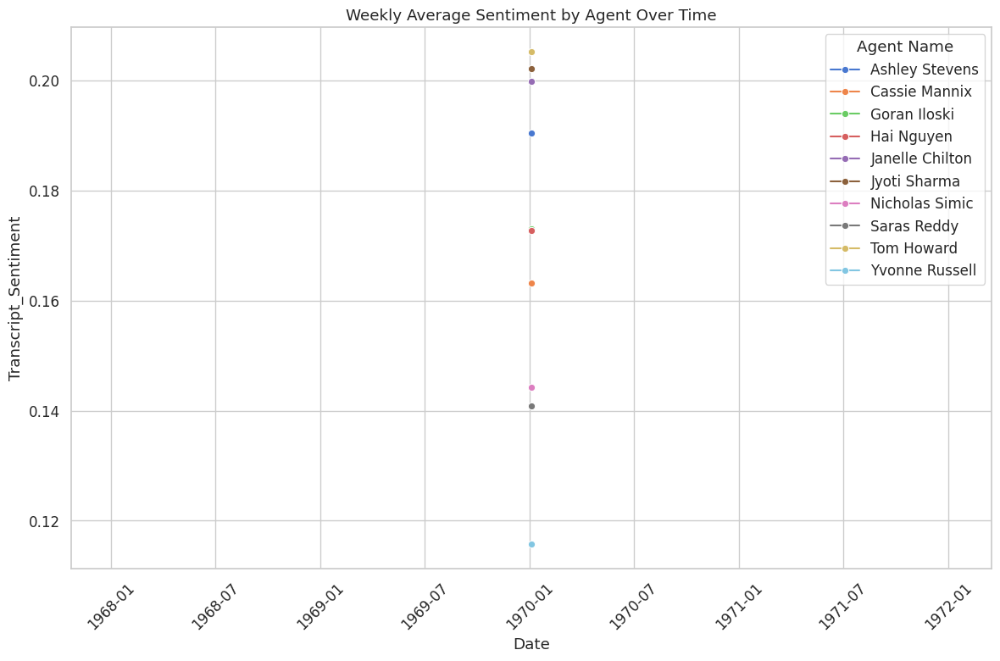

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

# Load cleaned data
#df = pd.read_csv("clean_agent_transcripts.csv")

# Optional: restrict to non-null transcripts
df_trans = df.dropna(subset=["Transcript"])

# List of stop / unwanted words for word cloud
unwanted = set(["um", "uh", "yes", "no", "okay", "ok", "thank", "thanks",
                "please", "hello", "right", "just", "like", "can", "would", "also", "one", "get"])

# ================
# Agent-wise Sentiment Distribution
# ================
plt.figure(figsize=(10,6))
sns.countplot(data=df, x="Agent Name", hue="Sentiment_Class")
plt.title("Sentiment Distribution by Agent")
plt.xticks(rotation=45)
plt.legend(title="Sentiment")
plt.tight_layout()
plt.show()

# ================
# Agent-wise Average Transcript Sentiment
# ================
agent_sent = df.groupby("Agent Name")["Transcript_Sentiment"].mean().reset_index().sort_values("Transcript_Sentiment", ascending=False)
plt.figure(figsize=(10,6))
sns.barplot(data=agent_sent, x="Transcript_Sentiment", y="Agent Name", palette="viridis")
plt.title("Average Transcript Sentiment by Agent")
plt.xlabel("Average Sentiment Score (-1 to +1)")
plt.tight_layout()
plt.show()

# ================
# Correlation: Sentiment vs AHT, WaitTime, etc.
# ================
# select a subset
corr_df = df[["Transcript_Sentiment", "AHT", "Wait Time", "Hold Time", "Complaint_Flag"]].dropna()
sns.pairplot(corr_df, vars=["Transcript_Sentiment", "AHT", "Wait Time", "Hold Time"], hue="Complaint_Flag", diag_kind="kde")
plt.suptitle("Correlation of Sentiment with Operational Metrics", y=1.02)
plt.show()

# ================
# Word Cloud per Agent (interactive or loop)
# ================
agents = df["Agent Name"].unique()
for agent in agents:
    texts = " ".join(df_trans[df_trans["Agent Name"] == agent]["Transcript"].astype(str).tolist())
    if not texts.strip():
        continue
    # filter unwanted words
    # lower-case and simple cleaning
    words = [w for w in texts.lower().split() if w not in unwanted]
    filtered_text = " ".join(words)
    wc = WordCloud(width=800, height=400, background_color="white",
                   stopwords=unwanted, max_words=100, colormap="plasma").generate(filtered_text)
    plt.figure(figsize=(10,5))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Word Cloud for Agent: {agent}")
    plt.show()

# ================
# Topic Modeling (optional) — to find common themes
# ================
# Prepare corpus
vectorizer = CountVectorizer(stop_words="english", max_df=0.9, min_df=10)
X = vectorizer.fit_transform(df_trans["Transcript"])
lda = LatentDirichletAllocation(n_components=5, random_state=42)
lda.fit(X)

# show top words per topic
terms = vectorizer.get_feature_names_out()
for idx, topic in enumerate(lda.components_):
    top = [terms[i] for i in topic.argsort()[-10:]]
    print(f"Topic {idx+1}: {', '.join(top)}")

# ================
# Trend of Agent-wise Sentiment Over Time
# ================
df_time = df.copy()
df_time["Date"] = pd.to_datetime(df_time["Date"])
agent_time = df_time.groupby(["Agent Name", pd.Grouper(key="Date", freq="W")])["Transcript_Sentiment"].mean().reset_index()

plt.figure(figsize=(12,8))
sns.lineplot(data=agent_time, x="Date", y="Transcript_Sentiment", hue="Agent Name", marker="o")
plt.title("Weekly Average Sentiment by Agent Over Time")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import ast

# ===============================
# 1. Load Data
# ===============================
df = pd.read_excel("/content/drive/MyDrive/tnew.xlsx")

# ===============================
# 2. Parse Complaint Column
# ===============================
def parse_complaint(val):
    """Safely convert stringified dict/JSON to Python dict"""
    if pd.isna(val):
        return {}
    try:
        if isinstance(val, dict):   # already a dict
            return val
        return ast.literal_eval(str(val))  # convert string to dict
    except:
        return {}

df["Complaint_dict"] = df["Complaint"].apply(parse_complaint)

# ===============================
# 3. Expand Dictionary into Columns
# ===============================
complaint_expanded = pd.json_normalize(df["Complaint_dict"])

# Add prefix to avoid clashes with other fields
complaint_expanded = complaint_expanded.add_prefix("Complaint_")

# ===============================
# 4. Merge Back into DataFrame
# ===============================
df_final = pd.concat([df.drop(columns=["Complaint_dict"]), complaint_expanded], axis=1)

# ===============================
# 5. Export
# ===============================
df_final.to_csv("complaint_preprocessed.csv", index=False)

print("✅ Complaint preprocessing complete. File saved as 'complaint_preprocessed.csv'")


✅ Complaint preprocessing complete. File saved as 'complaint_preprocessed.csv'


In [ ]:
import pandas as pd
import ast

# 1. Load file
#df = pd.read_excel("tnew.xlsx")

# 2. Safely parse the complaint column into dict
def parse_complaint(val):
    if pd.isna(val):
        return {}
    try:
        return ast.literal_eval(str(val))  # convert stringified dict to Python dict
    except:
        return {}

df["Complaint_dict"] = df["Complaint"].apply(parse_complaint)

# 3. Expand keys into separate columns
complaint_expanded = pd.json_normalize(df["Complaint_dict"])

# Prefix columns with "Complaint_" to avoid clashes
complaint_expanded = complaint_expanded.add_prefix("Complaint_")

# 4. Merge back into the original dataframe
df_final = pd.concat([df.drop(columns=["Complaint_dict"]), complaint_expanded], axis=1)

# 5. Save final file
df_final.to_csv("complaint_expanded.csv", index=False)

print("✅ Complaint column expanded into multiple columns. Saved as 'complaint_expanded.csv'")


✅ Complaint column expanded into multiple columns. Saved as 'complaint_expanded.csv'


In [ ]:
import pandas as pd
import ast

# 1. Load your file
df = pd.read_csv("/content/complaint_preprocessed.csv")

# 2. Parse Complaint column into a dictionary
def parse_complaint(val):
    if pd.isna(val):
        return {}
    try:
        # Convert lowercase true/false/null to Python-friendly True/False/None
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        return ast.literal_eval(fixed_val)
    except:
        return {}

df["Complaint_dict"] = df["Complaint"].apply(parse_complaint)

# 3. Expand dictionary into multiple columns
complaint_expanded = pd.json_normalize(df["Complaint_dict"])

# 4. Prefix for clarity
complaint_expanded = complaint_expanded.add_prefix("Complaint_")

# 5. Merge back into dataframe
df_final = pd.concat([df.drop(columns=["Complaint_dict"]), complaint_expanded], axis=1)

# 6. Save to new file
df_final.to_csv("complaint_expanded.csv", index=False)

print("✅ Complaint column expanded. File saved as 'complaint_expanded.csv'")


✅ Complaint column expanded. File saved as 'complaint_expanded.csv'


In [ ]:
import pandas as pd
import ast

# 1. Load your file
df = pd.read_excel("/content/drive/MyDrive/tnew.xlsx")

# -------------------------------
# 2. Helper function to parse JSON safely
# -------------------------------
def parse_json(val):
    if pd.isna(val):
        return {}
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        parsed = ast.literal_eval(fixed_val)
        # If it's a list of dicts, return first element
        if isinstance(parsed, list) and len(parsed) > 0 and isinstance(parsed[0], dict):
            return parsed[0]
        elif isinstance(parsed, dict):
            return parsed
        else:
            return {}
    except:
        return {}

# -------------------------------
# 3. Process Complaint column
# -------------------------------
df["Complaint_dict"] = df["Complaint"].apply(parse_json)
complaint_expanded = pd.json_normalize(df["Complaint_dict"]).add_prefix("Complaint_")

# -------------------------------
# 4. Process Call Flag column
# -------------------------------
df["CallFlag_dict"] = df["Call Flag"].apply(parse_json)
callflag_expanded = pd.json_normalize(df["CallFlag_dict"]).add_prefix("CallFlag_")

# -------------------------------
# 5. Merge into final dataset
# -------------------------------
df_final = pd.concat([df.drop(columns=["Complaint_dict","CallFlag_dict"]),
                      complaint_expanded, callflag_expanded], axis=1)

# -------------------------------
# 6. Export
# -------------------------------
df_final.to_csv("complaint_callflag_expanded.csv", index=False)

print("✅ Complaint and Call Flag expanded into separate columns. File saved as 'complaint_callflag_expanded.csv'")


KeyError: 'Call Flag'

In [ ]:
# --- Flags Column ---
def parse_flags(val):
    if pd.isna(val):
        return {}
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        parsed = ast.literal_eval(fixed_val)
        if isinstance(parsed, list) and len(parsed) > 0 and isinstance(parsed[0], dict):
            return parsed[0]  # Take first flag only
        return {}
    except:
        return {}

df["Flags_dict"] = df["Call Flags"].apply(parse_flags)
flags_expanded = pd.json_normalize(df["Flags_dict"]).add_prefix("Flags_")

df_flags = pd.concat([df.drop(columns=["Flags_dict"]), flags_expanded], axis=1)
df_flags.to_csv("flags_expanded.csv", index=False)

print("✅ Flags expanded and saved as flags_expanded.csv")


✅ Flags expanded and saved as flags_expanded.csv


In [ ]:
import pandas as pd
import ast

# 1. Load dataset
df = pd.read_excel("tnew.xlsx")

# 2. Parse Flags column safely
def parse_flags(val):
    if pd.isna(val) or val in ["", "[]"]:
        return []
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        parsed = ast.literal_eval(fixed_val)
        if isinstance(parsed, list):
            return parsed
        elif isinstance(parsed, dict):
            return [parsed]  # wrap single dict
        else:
            return []
    except:
        return []

df["Flags_list"] = df["Flags"].apply(parse_flags)

# 3. Find max number of flag dicts across all rows
max_flags = df["Flags_list"].apply(len).max()

# 4. Expand into FlagX_title, FlagX_message columns
expanded_flags = pd.DataFrame()

for i in range(max_flags):
    temp = df["Flags_list"].apply(lambda x: x[i] if i < len(x) else {})
    temp_df = pd.json_normalize(temp)
    temp_df = temp_df.rename(columns={"title": f"Flag{i+1}_title", "message": f"Flag{i+1}_message"})
    expanded_flags = pd.concat([expanded_flags, temp_df], axis=1)

# 5. Merge back to original dataset
df_final = pd.concat([df.drop(columns=["Flags_list"]), expanded_flags], axis=1)

# 6. Export
df_final.to_csv("flags_expanded.csv", index=False)

print("✅ Flags expanded into columns (FlagX_title, FlagX_message). File saved as 'flags_expanded.csv'")


In [ ]:
import pandas as pd
import ast

# 1. Load dataset
df = pd.read_excel("/content/drive/MyDrive/tnew.xlsx")

# ================================
# --- Complaint Column Preprocessing ---
# ================================
def parse_complaint(val):
    if pd.isna(val) or val == "":
        return {}
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        return ast.literal_eval(fixed_val)
    except:
        return {}

df["Complaint_dict"] = df["Complaint"].apply(parse_complaint)

complaint_expanded = pd.json_normalize(df["Complaint_dict"]).add_prefix("Complaint_")

# ================================
# --- Flags Column Preprocessing ---
# ================================
def parse_flags(val):
    if pd.isna(val) or val in ["", "[]"]:
        return []
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        parsed = ast.literal_eval(fixed_val)
        if isinstance(parsed, list):
            return parsed
        elif isinstance(parsed, dict):
            return [parsed]  # wrap single dict
        else:
            return []
    except:
        return []

df["Flags_list"] = df["Call Flags"].apply(parse_flags)

# Find maximum number of flag dictionaries across rows
max_flags = df["Flags_list"].apply(len).max()

expanded_flags = pd.DataFrame()

for i in range(max_flags):
    temp = df["Flags_list"].apply(lambda x: x[i] if i < len(x) else {})
    temp_df = pd.json_normalize(temp)
    # Rename dynamically: Flag1_title, Flag1_message, Flag2_title, etc.
    temp_df = temp_df.rename(columns={
        "title": f"Flag{i+1}_title",
        "message": f"Flag{i+1}_message"
    })
    expanded_flags = pd.concat([expanded_flags, temp_df], axis=1)

# ================================
# --- Merge All Expansions ---
# ================================
df_final = pd.concat([df.drop(columns=["Complaint_dict","Flags_list"]), complaint_expanded, expanded_flags], axis=1)

# ================================
# --- Save Final Output ---
# ================================
df_final.to_csv("complaint_flags_expanded.csv", index=False)

print("✅ Final dataset created with Complaint + Flags expanded. Saved as 'complaint_flags_expanded.csv'")


✅ Final dataset created with Complaint + Flags expanded. Saved as 'complaint_flags_expanded.csv'


In [ ]:
import pandas as pd

# 1. Load your file
df = pd.read_csv("/content/complaint_flags_expanded.csv")

# 2. Convert Excel serial number to datetime
# Excel serial date: day 0 = 1899-12-30
df["Date"] = pd.to_datetime("1899-12-30") + pd.to_timedelta(df["Date"], unit="D")

# 3. Clean Timestamp column (ensure numeric)
df["Timestamp"] = pd.to_numeric(df["Timestamp"], errors="coerce")

# 4. Save the cleaned file
df.to_csv("complaint_flags_expanded_clean.csv", index=False)

print("✅ Date converted to datetime, Timestamp cleaned. File saved as complaint_flags_expanded_clean.csv")


✅ Date converted to datetime, Timestamp cleaned. File saved as complaint_flags_expanded_clean.csv


In [ ]:
import pandas as pd

# 1. Load your file
df = pd.read_csv("/content/complaint_flags_expanded.csv")

# 2. Convert Date column (Excel serial -> datetime)
df["Date"] = pd.to_datetime("1899-12-30") + pd.to_timedelta(df["Date"], unit="D")

# 3. Convert Timestamp column (Excel serial -> full datetime with time)
df["Timestamp"] = pd.to_datetime("1899-12-30") + pd.to_timedelta(df["Timestamp"], unit="D")

# 4. Save cleaned file
df.to_csv("complaint_flags_expanded_clean.csv", index=False)

print("✅ Date converted to datetime (YYYY-MM-DD), Timestamp converted to full datetime (YYYY-MM-DD HH:MM:SS)")


✅ Date converted to datetime (YYYY-MM-DD), Timestamp converted to full datetime (YYYY-MM-DD HH:MM:SS)


In [ ]:
import pandas as pd
import numpy as np
import ast

# ================================
# 1. Load dataset
# ================================
df = pd.read_excel("/content/drive/MyDrive/tnew.xlsx")

# ================================
# 2. Date & Timestamp Conversion
# ================================
# Convert Date column (Excel serial -> datetime)
df["Date"] = pd.to_datetime("1899-12-30") + pd.to_timedelta(df["Date"], unit="D")

# Convert Timestamp column (Excel serial -> full datetime with time)
df["Timestamp"] = pd.to_datetime("1899-12-30") + pd.to_timedelta(df["Timestamp"], unit="D")

# Derive YearMonth & Week for trend analysis
df["YearMonth"] = df["Date"].dt.to_period("M").astype(str)
df["Week"] = df["Date"].dt.to_period("W").astype(str)

# ================================
# 3. Complaint Column Expansion
# ================================
def parse_complaint(val):
    if pd.isna(val) or val == "":
        return {}
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        return ast.literal_eval(fixed_val)
    except:
        return {}

df["Complaint_dict"] = df["Complaint"].apply(parse_complaint)
complaint_expanded = pd.json_normalize(df["Complaint_dict"]).add_prefix("Complaint_")

# ================================
# 4. Flags Column Expansion
# ================================
def parse_flags(val):
    if pd.isna(val) or val in ["", "[]"]:
        return []
    try:
        fixed_val = str(val).replace("true", "True").replace("false", "False").replace("null", "None")
        parsed = ast.literal_eval(fixed_val)
        if isinstance(parsed, list):
            return parsed
        elif isinstance(parsed, dict):
            return [parsed]  # wrap single dict
        else:
            return []
    except:
        return []

df["Flags_list"] = df["Call Flags"].apply(parse_flags)

# Find maximum number of flags across dataset
max_flags = df["Flags_list"].apply(len).max()

expanded_flags = pd.DataFrame()
for i in range(max_flags):
    temp = df["Flags_list"].apply(lambda x: x[i] if i < len(x) else {})
    temp_df = pd.json_normalize(temp)
    # Rename keys to FlagX_<key>
    temp_df = temp_df.rename(columns={k: f"Flag{i+1}_{k}" for k in temp_df.columns})
    expanded_flags = pd.concat([expanded_flags, temp_df], axis=1)

# ================================
# 5. Core Metrics (Agent KPIs)
# ================================
# Replace NaN with 0 for handled calls
df["Inbound Handled"] = df["Inbound Handled"].fillna(0)
df["Outbound Handled"] = df["Outbound Handled"].fillna(0)

# Total Calls
df["Total_Calls"] = df["Inbound Handled"] + df["Outbound Handled"]

# Average Handle Time (AHT)
df["AHT"] = (df["Inbound Handle Time"] + df["Outbound Handle Time"]) / df["Total_Calls"].replace(0, np.nan)

# Average Talk Time
df["Avg_Talk_Time"] = df["Talk Time"] / df["Total_Calls"].replace(0, np.nan)

# Average ACW Time
df["Avg_ACW_Time"] = df["ACW Time"] / df["Total_Calls"].replace(0, np.nan)

# Occupancy % = Handle Time / Login Time
df["Occupancy_Pct"] = (df["Handle Time"] / df["Login Time"].replace(0, np.nan)) * 100

# Availability % = Available Time / Login Time
df["Availability_Pct"] = (df["Available Time"] / df["Login Time"].replace(0, np.nan)) * 100

# SLA %
df["SLA_Pct"] = df["In SLA"] / (df["In SLA"] + df["Out SLA"]).replace(0, np.nan)

# Complaint Rate
df["Complaint_Flag"] = df["Complaint_detected"].astype(int) if "Complaint_detected" in df.columns else 0

# ================================
# 6. Merge All Expansions
# ================================
df_final = pd.concat([df.drop(columns=["Complaint_dict","Flags_list"]), complaint_expanded, expanded_flags], axis=1)

# ================================
# 7. Save Final Clean Dataset
# ================================
df_final.to_csv("final_preprocessed_dataset.csv", index=False)

print("✅ Final dataset created with Date, Timestamp, Complaint, Flags, and KPIs. Saved as 'final_preprocessed_dataset.csv'")


✅ Final dataset created with Date, Timestamp, Complaint, Flags, and KPIs. Saved as 'final_preprocessed_dataset.csv'


/tmp/ipython-input-159267327.py:15: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)


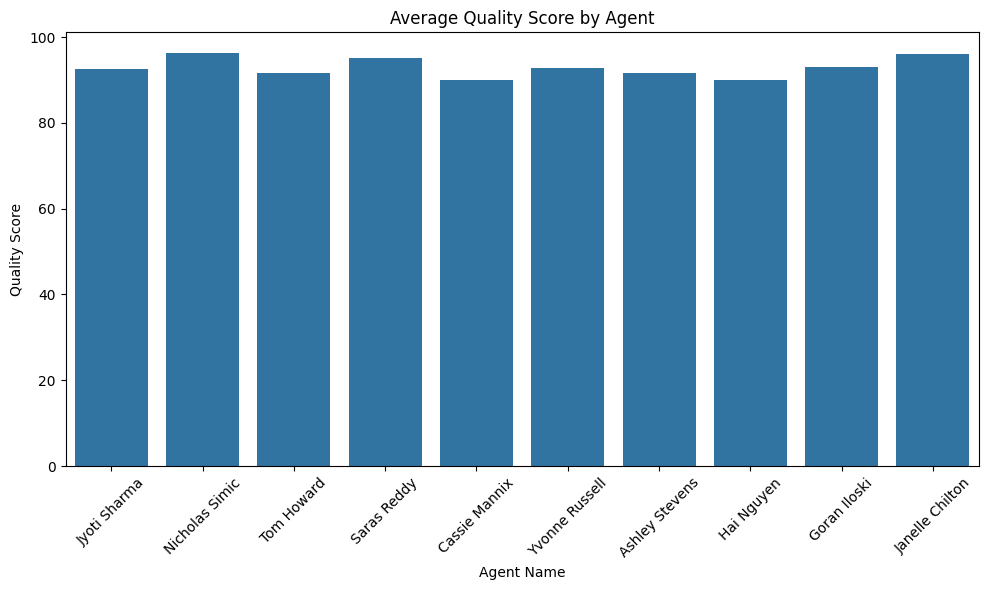

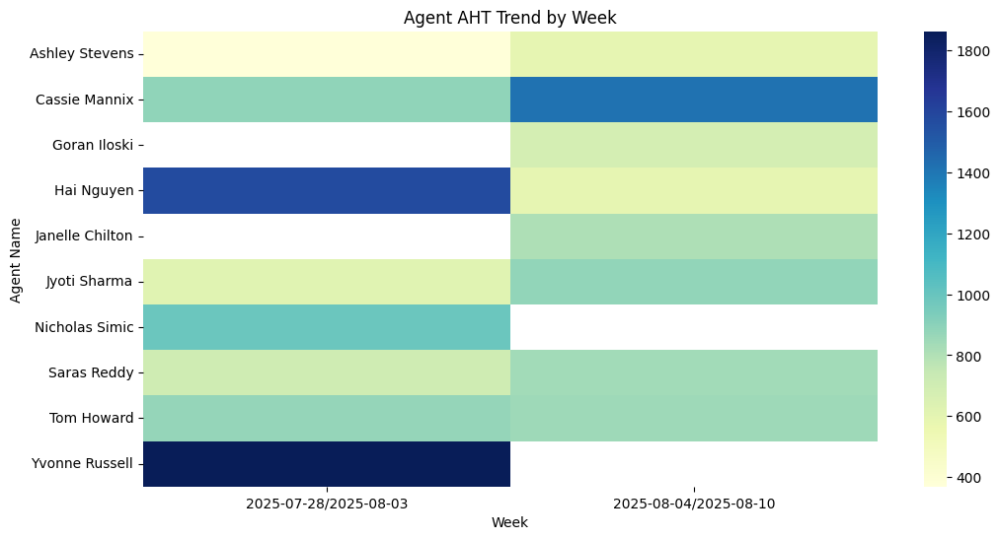

/tmp/ipython-input-159267327.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="Caller Type", data=df, palette="Set2")


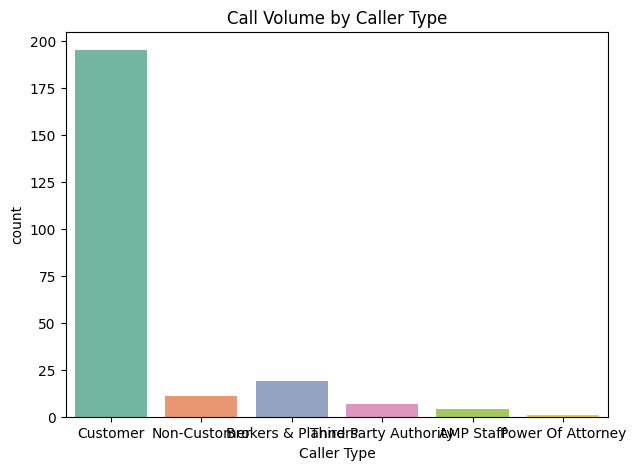

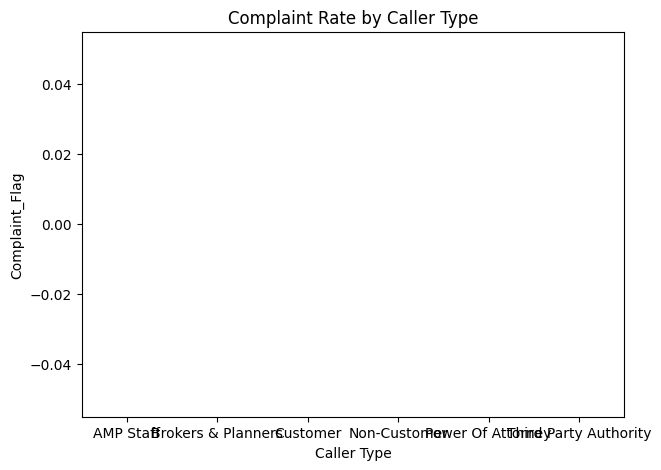

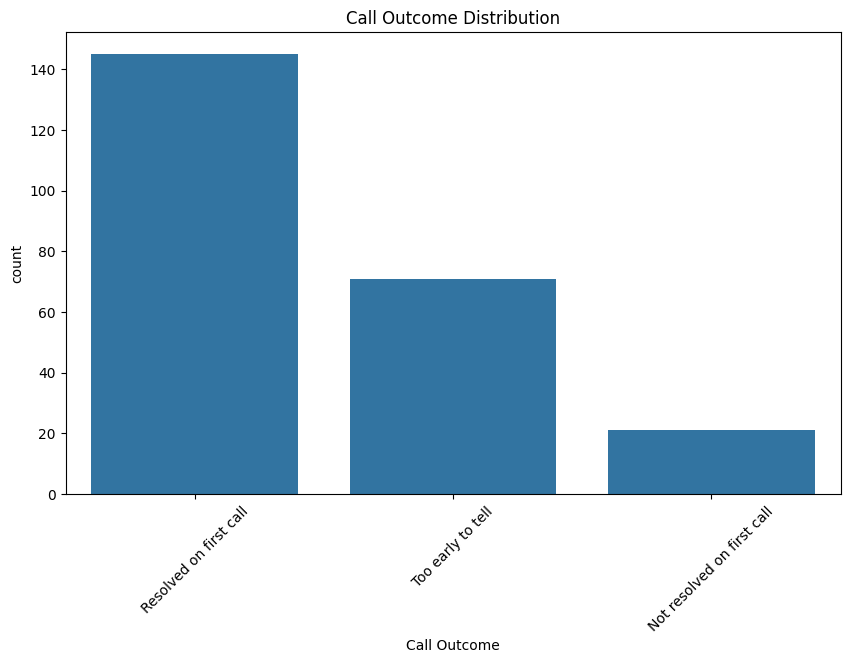

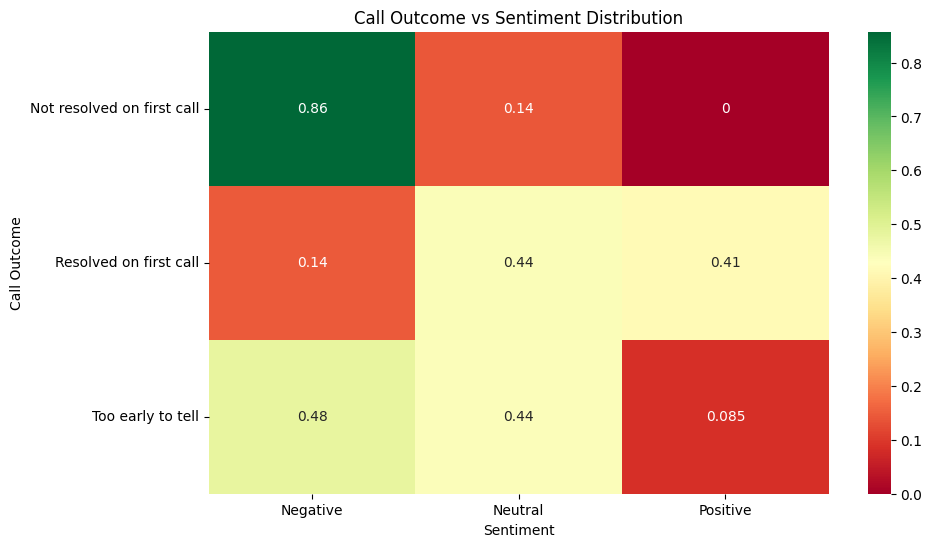

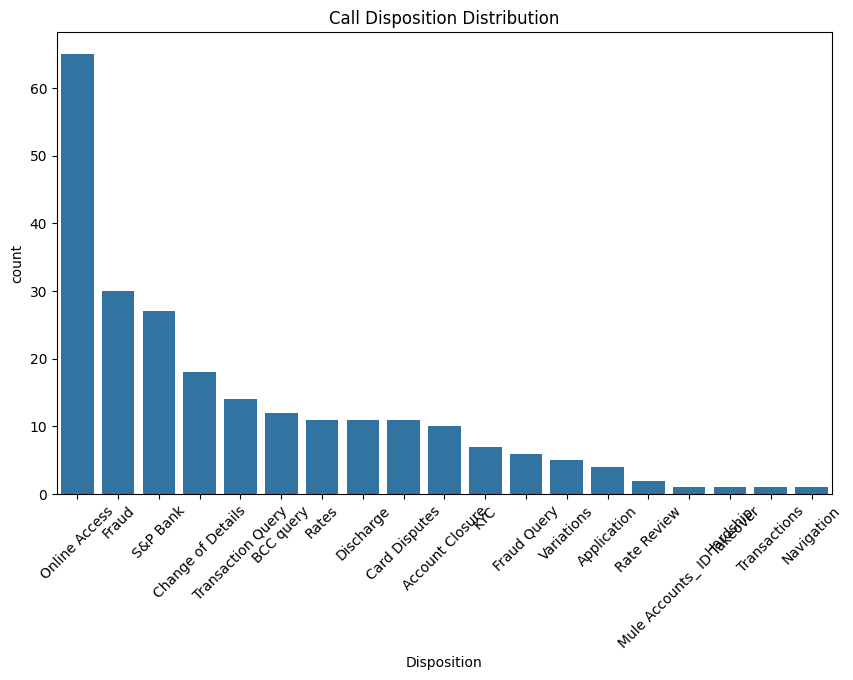

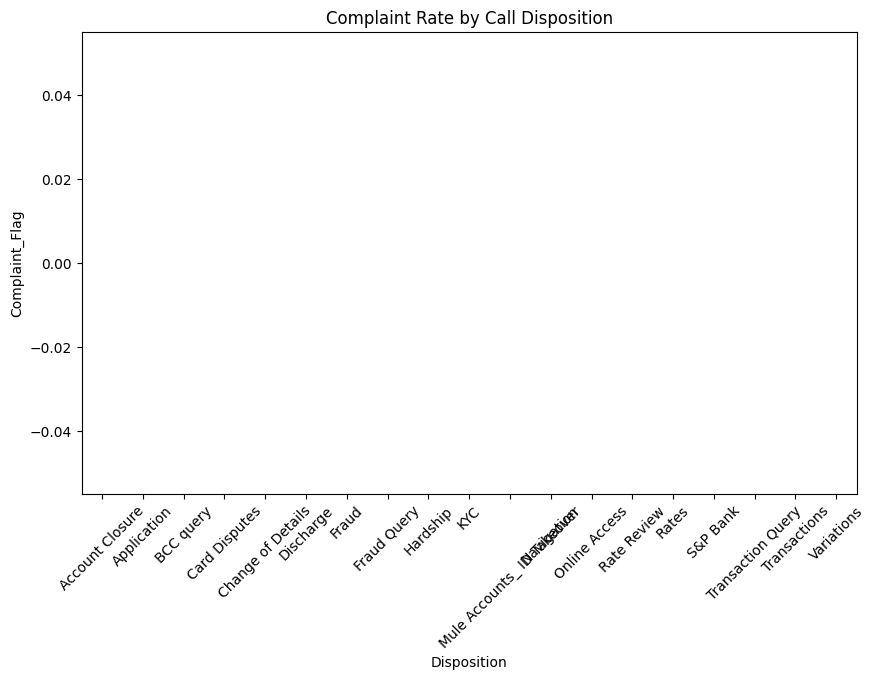

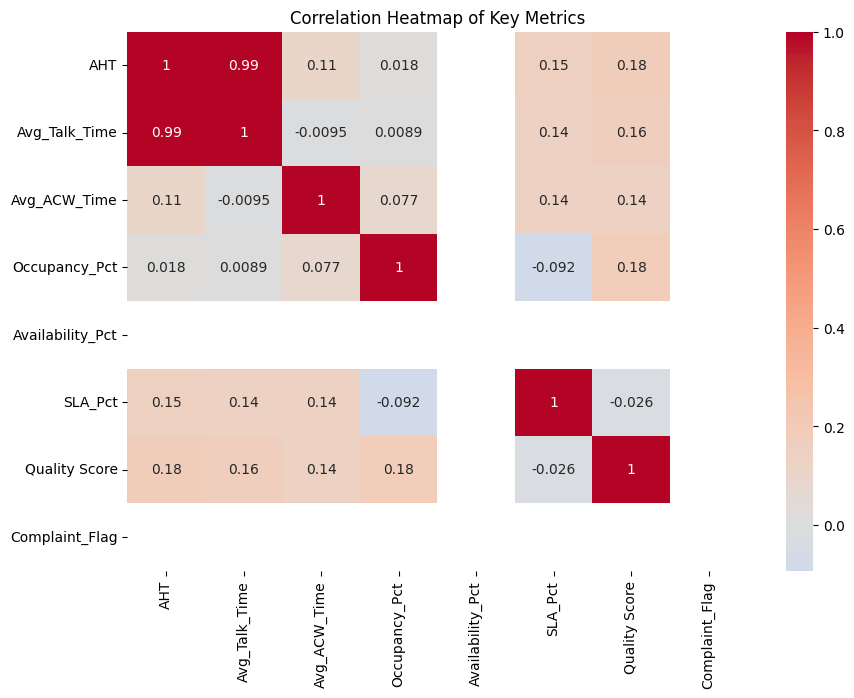

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load preprocessed dataset
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# --- Ensure numeric Quality Score ---
df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# ---------------------------
# 1. Agent-wise Quality Score
# ---------------------------
plt.figure(figsize=(10,6))
sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Quality Score by Agent")
plt.tight_layout()
plt.show()

# ---------------------------
# 2. AHT vs Quality Score Heatmap (Agent × Week)
# ---------------------------
pivot_aht_qs = df.pivot_table(index="Agent Name", columns="Week", values="AHT", aggfunc="mean")
plt.figure(figsize=(12,6))
sns.heatmap(pivot_aht_qs, cmap="YlGnBu", annot=False)
plt.title("Agent AHT Trend by Week")
plt.show()

# ---------------------------
# 3. Caller Type – Call Volume
# ---------------------------
plt.figure(figsize=(7,5))
sns.countplot(x="Caller Type", data=df, palette="Set2")
plt.title("Call Volume by Caller Type")
plt.show()

# ---------------------------
# 4. Caller Type vs Complaints
# ---------------------------
complaints_by_type = df.groupby("Caller Type")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(7,5))
sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type)
plt.title("Complaint Rate by Caller Type")
plt.show()

# ---------------------------
# 5. Call Outcomes Distribution
# ---------------------------
plt.figure(figsize=(10,6))
sns.countplot(x="Call Outcome", data=df, order=df["Call Outcome"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Outcome Distribution")
plt.show()

# ---------------------------
# 6. Call Outcome vs Sentiment Heatmap
# ---------------------------
outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

# ---------------------------
# 7. Disposition Distribution
# ---------------------------
plt.figure(figsize=(10,6))
sns.countplot(x="Disposition", data=df, order=df["Disposition"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Disposition Distribution")
plt.show()

# ---------------------------
# 8. Disposition vs Complaint Rate
# ---------------------------
disposition_complaints = df.groupby("Disposition")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(10,6))
sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints)
plt.xticks(rotation=45)
plt.title("Complaint Rate by Call Disposition")
plt.show()

# ---------------------------
# 9. Correlation Heatmap of Metrics
# ---------------------------
num_cols = ["AHT", "Avg_Talk_Time", "Avg_ACW_Time", "Occupancy_Pct", "Availability_Pct", "SLA_Pct", "Quality Score", "Complaint_Flag"]
corr = df[num_cols].corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Heatmap of Key Metrics")
plt.show()


In [ ]:
# If Complaint_detected exists, convert it to 1/0
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})


/tmp/ipython-input-3415539275.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set2")


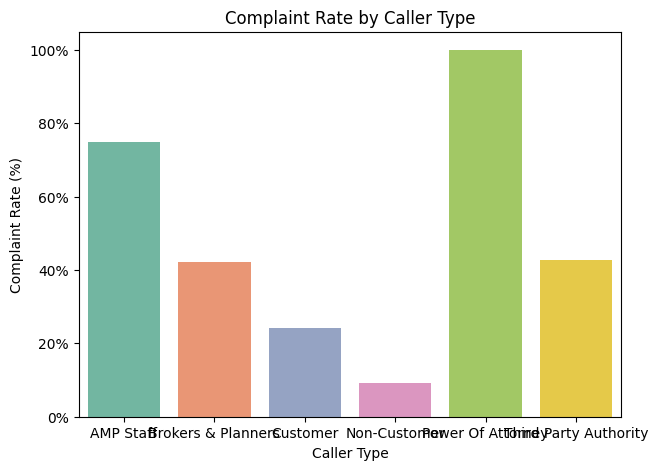

In [ ]:
# Complaint Rate by Caller Type
complaints_by_type = df.groupby("Caller Type")["Complaint_Flag"].mean().reset_index()

plt.figure(figsize=(7,5))
sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set2")
plt.title("Complaint Rate by Caller Type")
plt.ylabel("Complaint Rate (%)")
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.show()


/tmp/ipython-input-923719642.py:24: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)


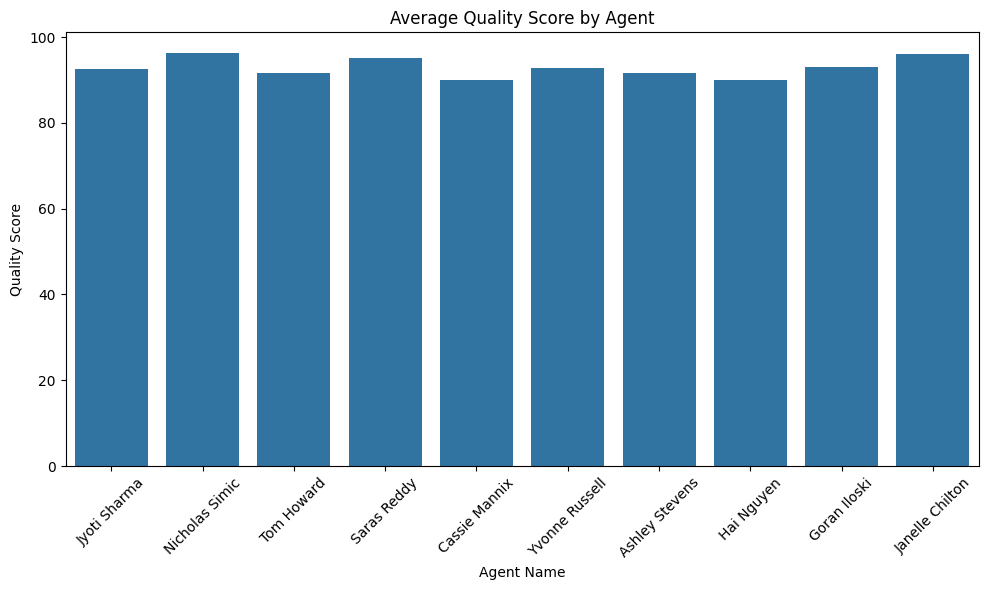

/tmp/ipython-input-923719642.py:31: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)


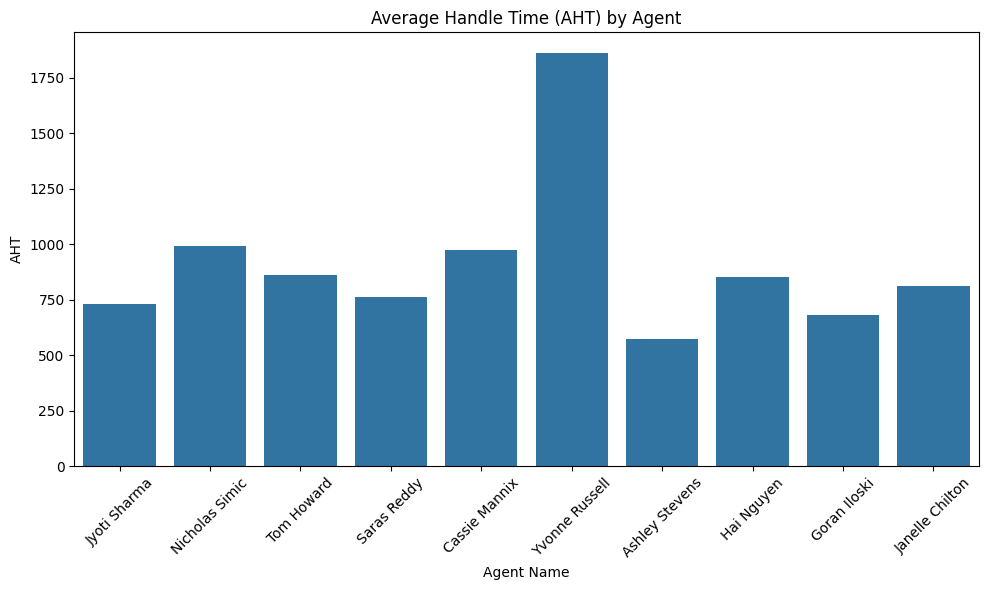

/tmp/ipython-input-923719642.py:38: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)


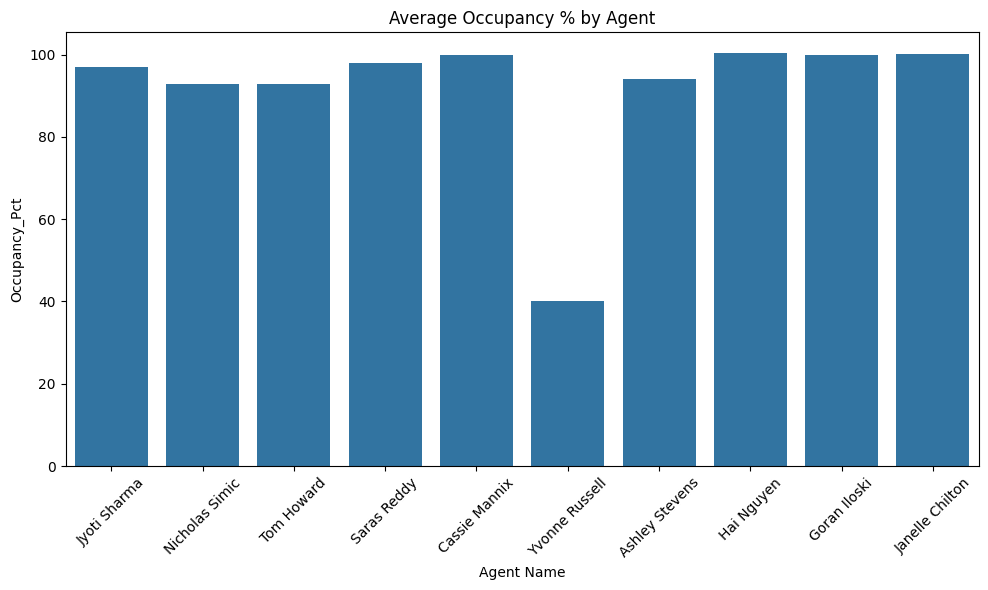

/tmp/ipython-input-923719642.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="Caller Type", data=df, palette="Set2")


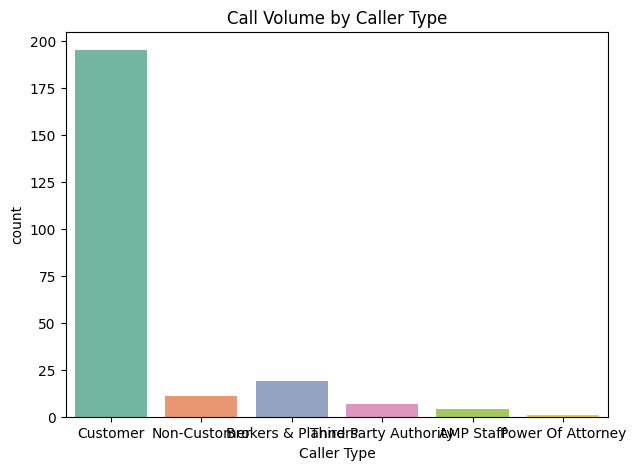

/tmp/ipython-input-923719642.py:54: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set1")


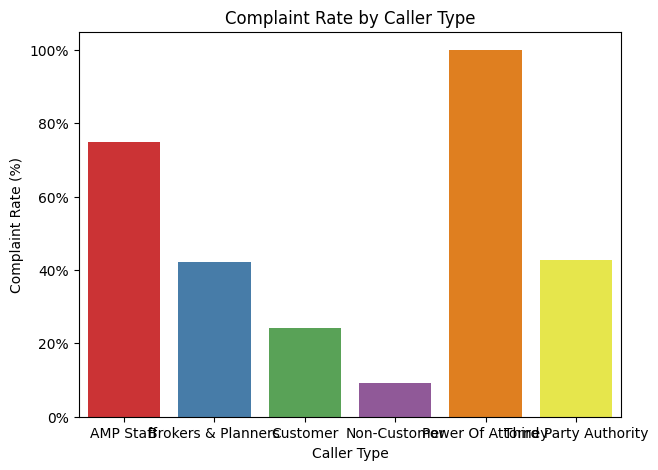

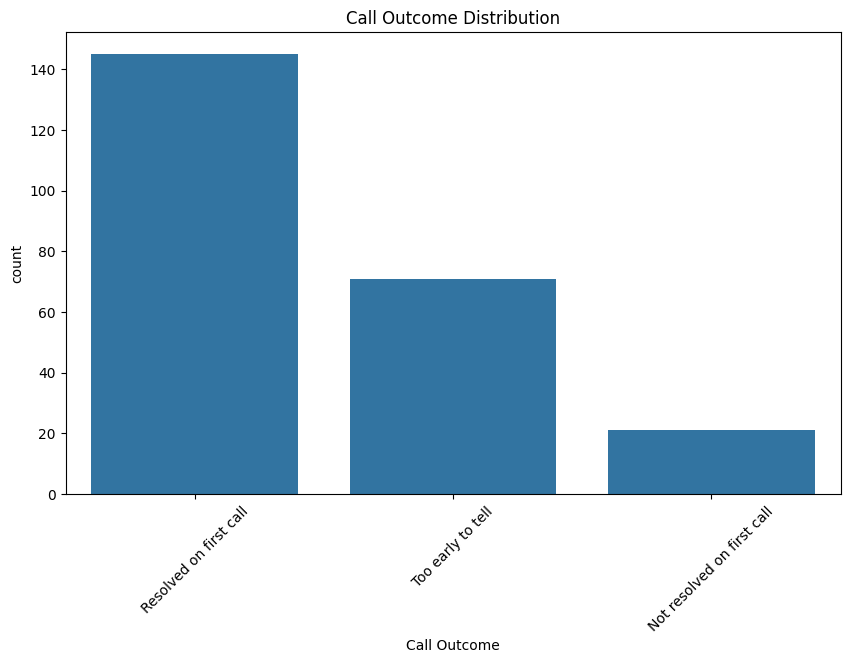

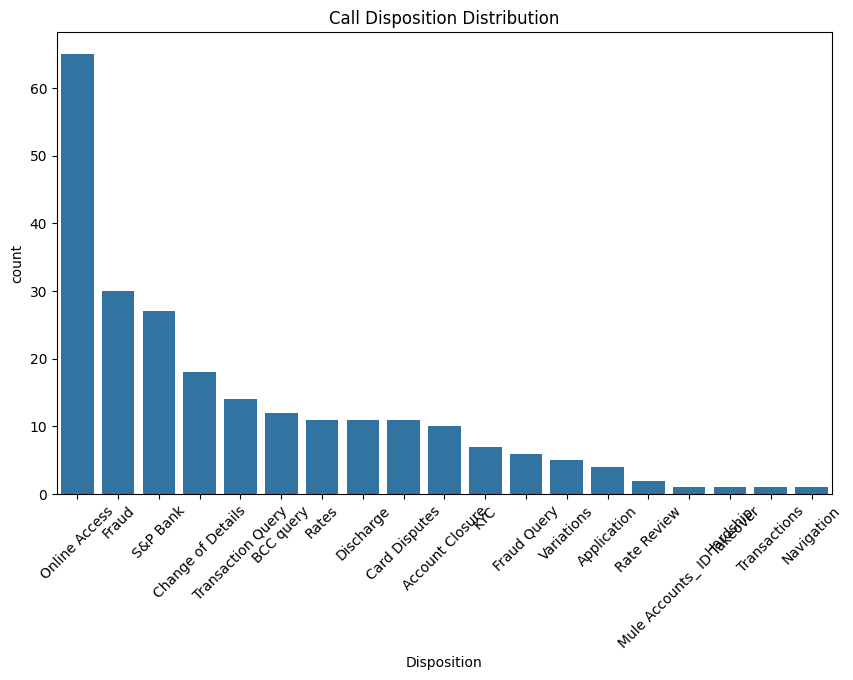

/tmp/ipython-input-923719642.py:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints, palette="coolwarm")


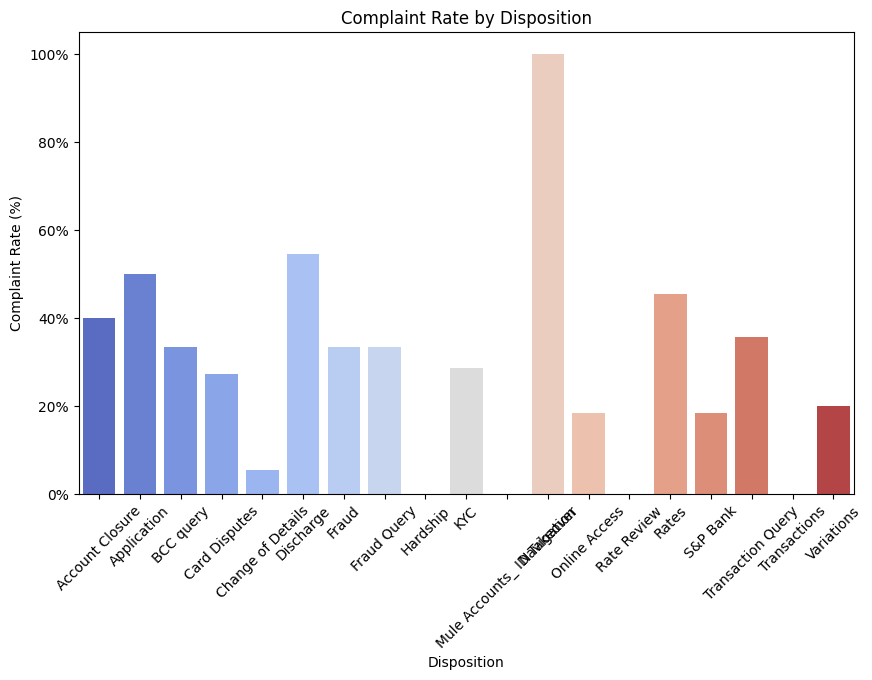

/tmp/ipython-input-923719642.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="Sentiment", data=df, palette="muted")


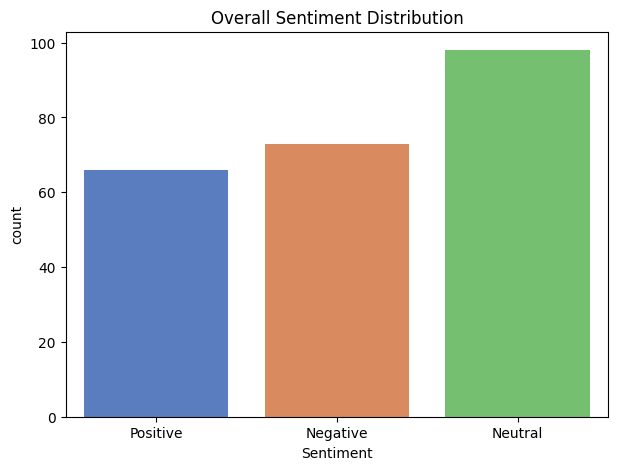

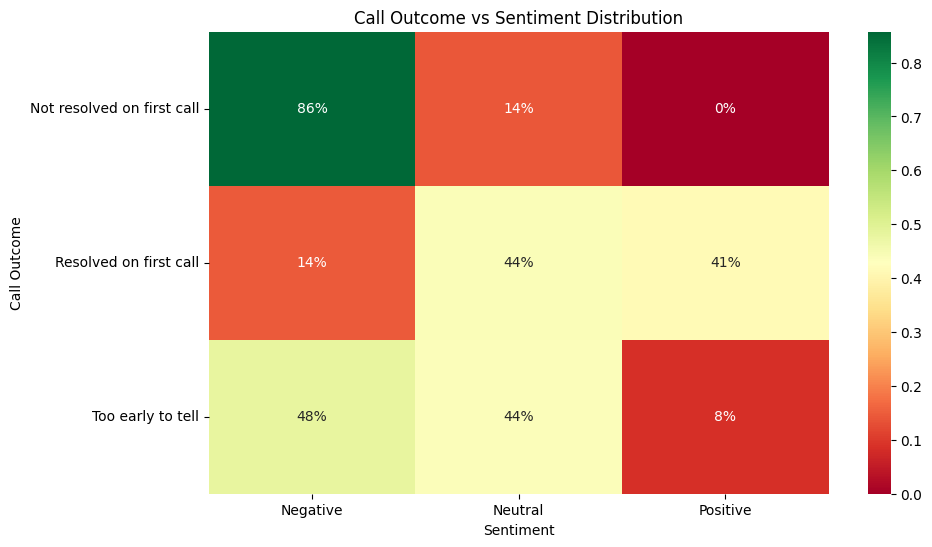

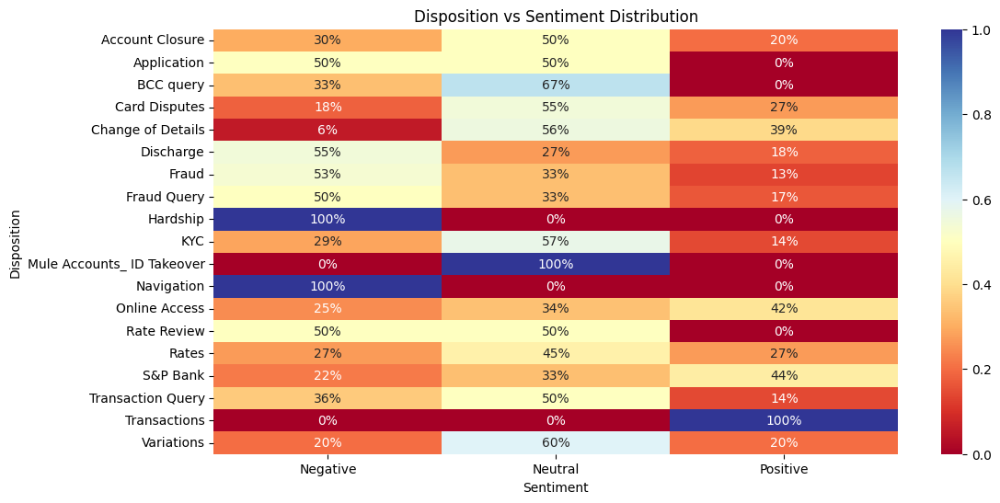

/tmp/ipython-input-923719642.py:108: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)


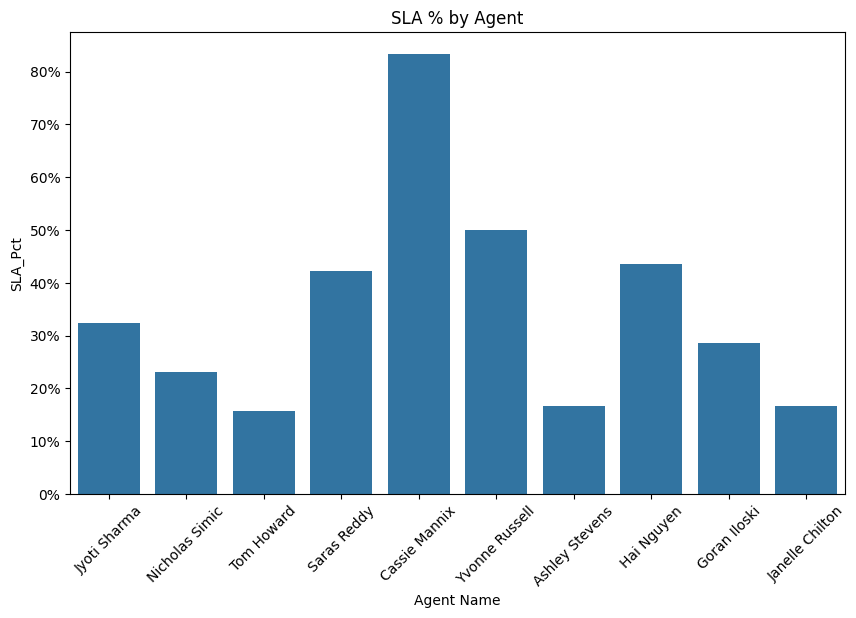

/tmp/ipython-input-923719642.py:115: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)


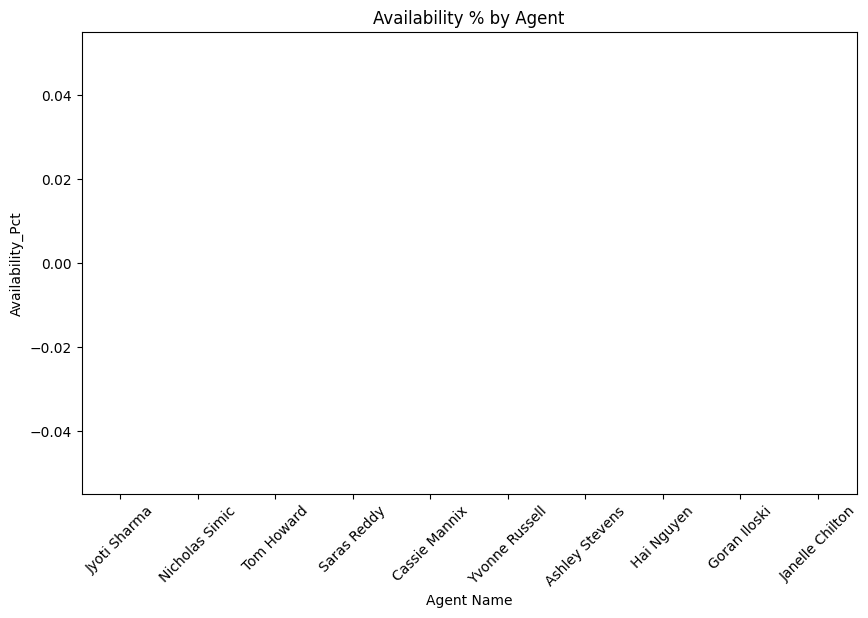

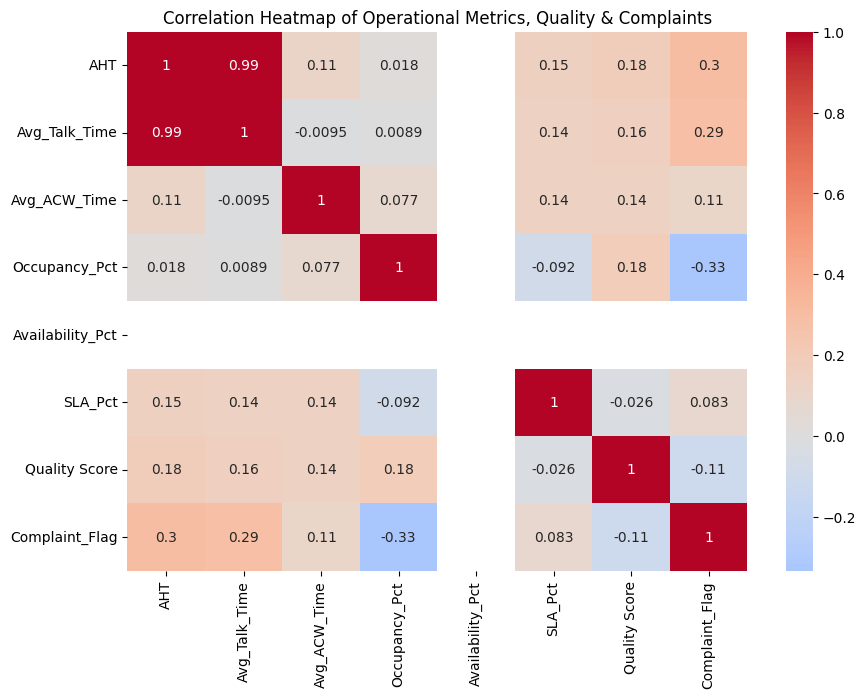

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# ==============================
# 1. Data Cleaning / Conversion
# ==============================
# Complaint flag ensure numeric 0/1
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})
else:
    df["Complaint_Flag"] = 0

# Quality Score numeric
df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# ==============================
# 2. Agent-Level KPIs
# ==============================
plt.figure(figsize=(10,6))
sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Quality Score by Agent")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Handle Time (AHT) by Agent")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Occupancy % by Agent")
plt.tight_layout()
plt.show()

# ==============================
# 3. Caller Type Insights
# ==============================
plt.figure(figsize=(7,5))
sns.countplot(x="Caller Type", data=df, palette="Set2")
plt.title("Call Volume by Caller Type")
plt.show()

complaints_by_type = df.groupby("Caller Type")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(7,5))
sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set1")
plt.title("Complaint Rate by Caller Type")
plt.ylabel("Complaint Rate (%)")
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.show()

# ==============================
# 4. Call Outcome & Disposition
# ==============================
plt.figure(figsize=(10,6))
sns.countplot(x="Call Outcome", data=df, order=df["Call Outcome"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Outcome Distribution")
plt.show()

plt.figure(figsize=(10,6))
sns.countplot(x="Disposition", data=df, order=df["Disposition"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Disposition Distribution")
plt.show()

disposition_complaints = df.groupby("Disposition")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(10,6))
sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints, palette="coolwarm")
plt.xticks(rotation=45)
plt.title("Complaint Rate by Disposition")
plt.ylabel("Complaint Rate (%)")
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.show()

# ==============================
# 5. Sentiment Analysis
# ==============================
plt.figure(figsize=(7,5))
sns.countplot(x="Sentiment", data=df, palette="muted")
plt.title("Overall Sentiment Distribution")
plt.show()

outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn", fmt=".0%")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

disposition_sentiment = pd.crosstab(df["Disposition"], df["Sentiment"], normalize="index")
plt.figure(figsize=(12,6))
sns.heatmap(disposition_sentiment, annot=True, cmap="RdYlBu", fmt=".0%")
plt.title("Disposition vs Sentiment Distribution")
plt.show()

# ==============================
# 6. SLA & Utilization
# ==============================
plt.figure(figsize=(10,6))
sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("SLA % by Agent")
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.show()

plt.figure(figsize=(10,6))
sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Availability % by Agent")
plt.show()

# ==============================
# 7. Correlations of KPIs
# ==============================
num_cols = [
    "AHT", "Avg_Talk_Time", "Avg_ACW_Time",
    "Occupancy_Pct", "Availability_Pct", "SLA_Pct",
    "Quality Score", "Complaint_Flag"
]

corr = df[num_cols].corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Heatmap of Operational Metrics, Quality & Complaints")
plt.show()


/tmp/ipython-input-4020443478.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)


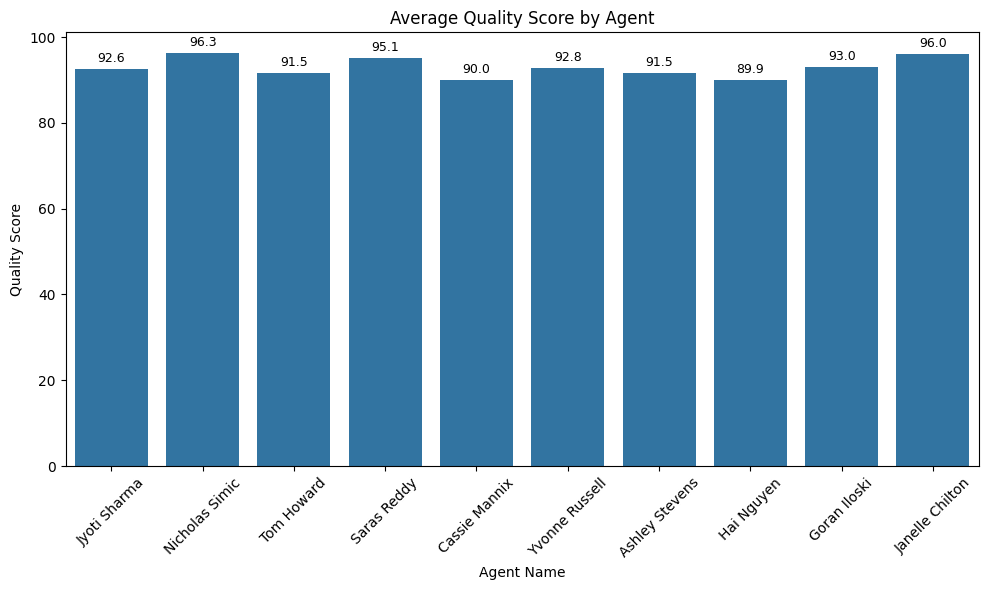

/tmp/ipython-input-4020443478.py:52: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)


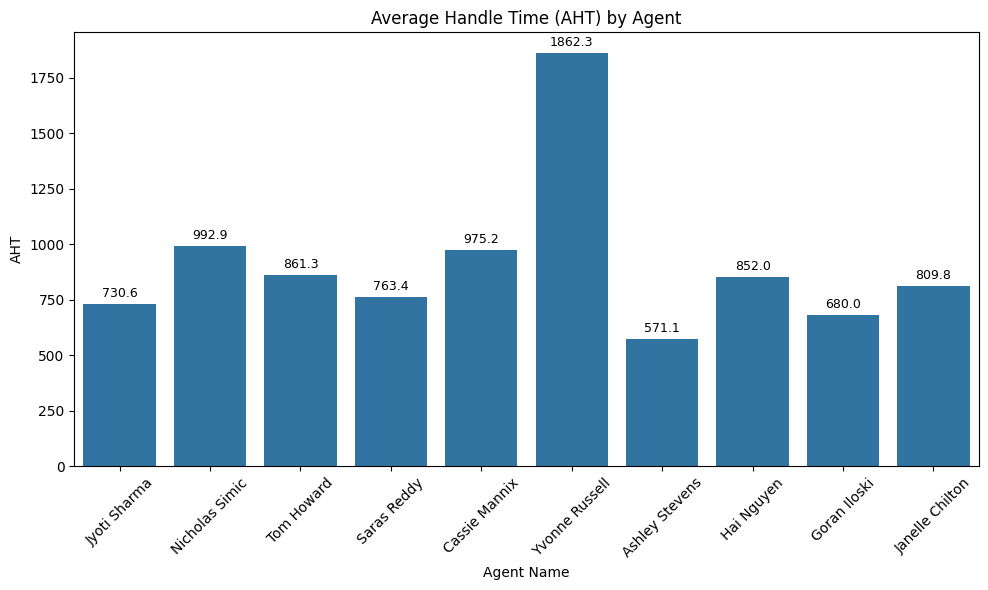

/tmp/ipython-input-4020443478.py:60: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)


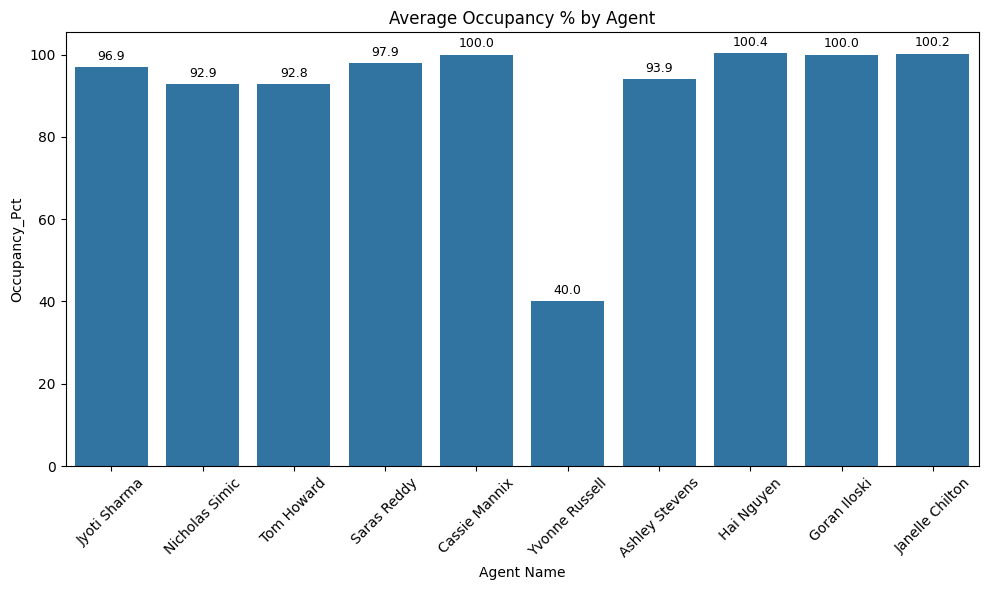

/tmp/ipython-input-4020443478.py:71: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Caller Type", data=df, palette="Set2")


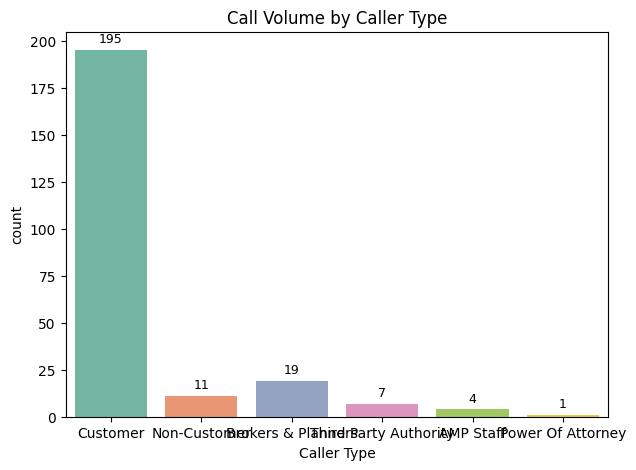

/tmp/ipython-input-4020443478.py:78: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set1")


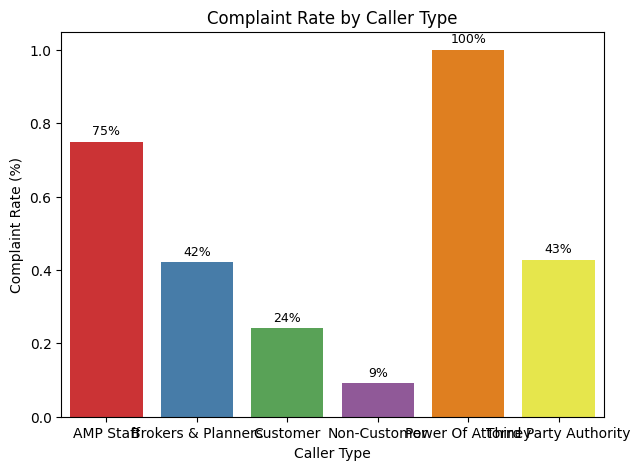

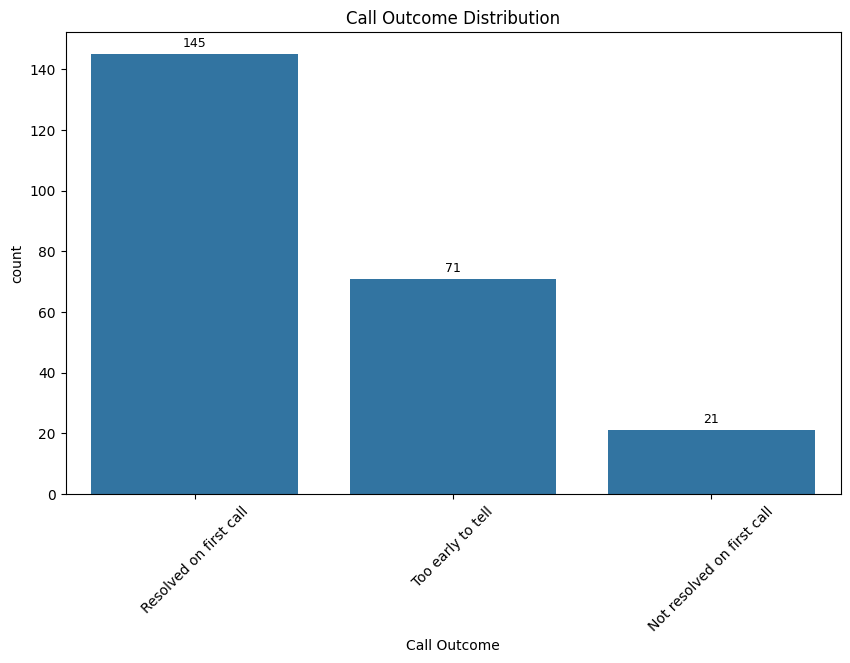

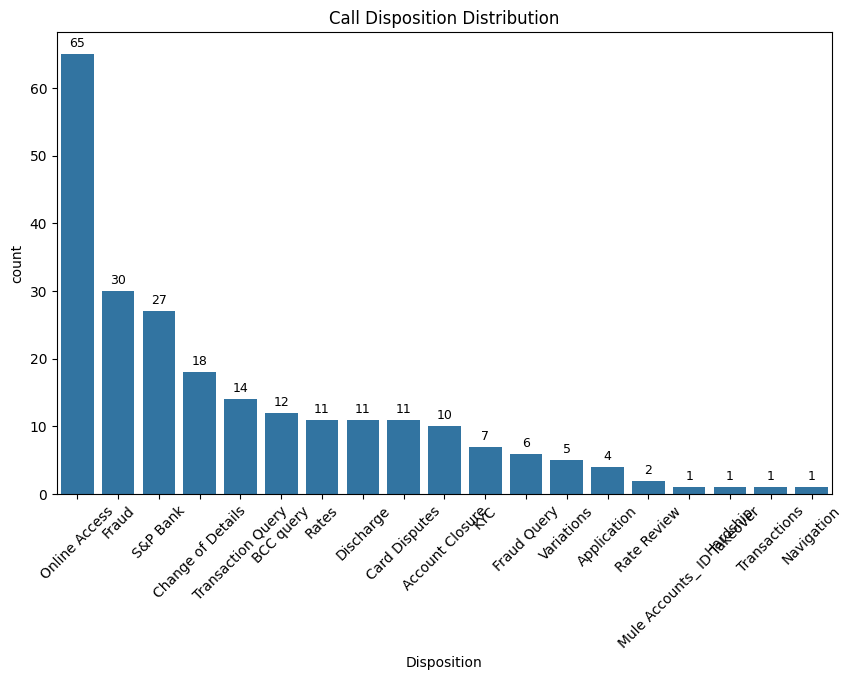

/tmp/ipython-input-4020443478.py:103: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints, palette="coolwarm")


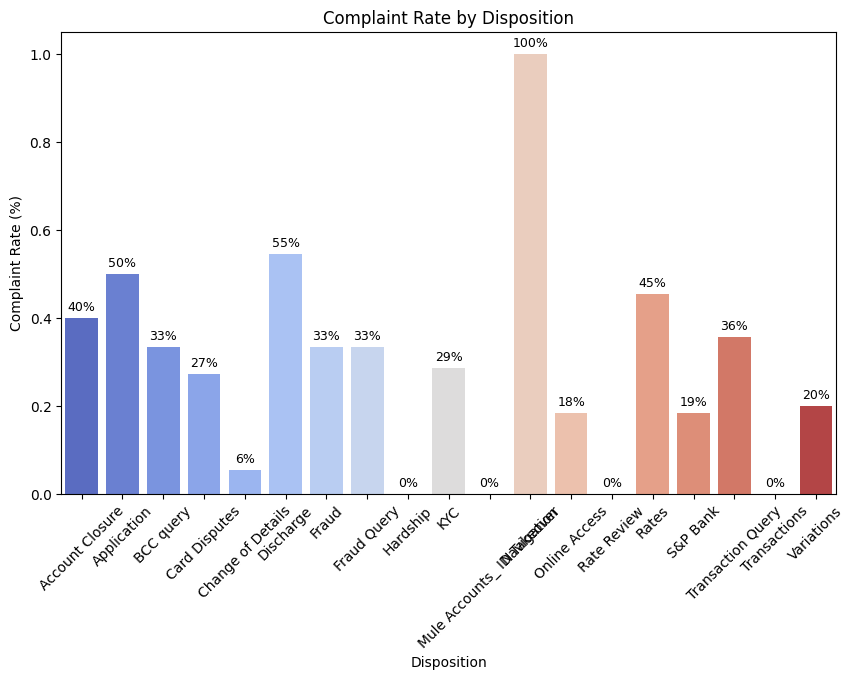

/tmp/ipython-input-4020443478.py:114: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Sentiment", data=df, palette="muted")


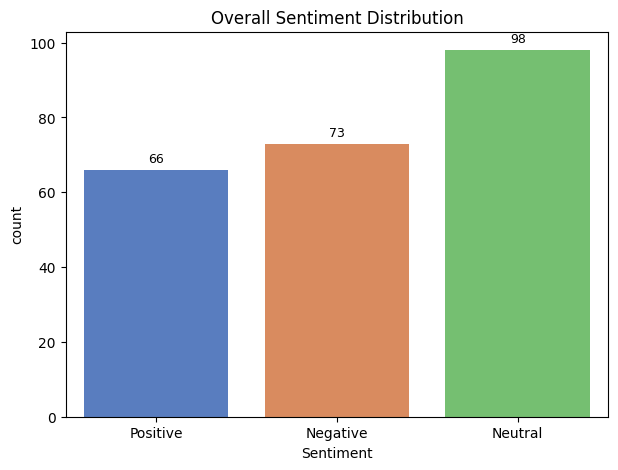

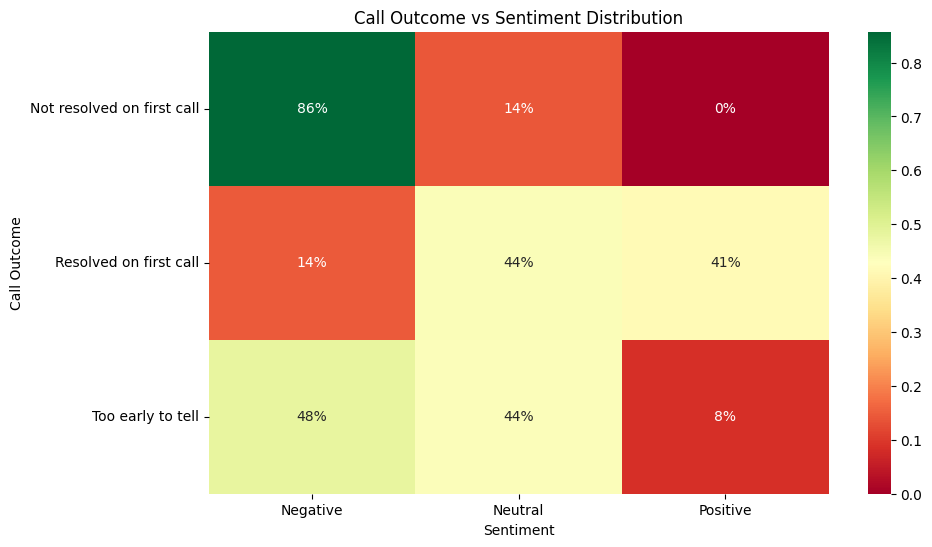

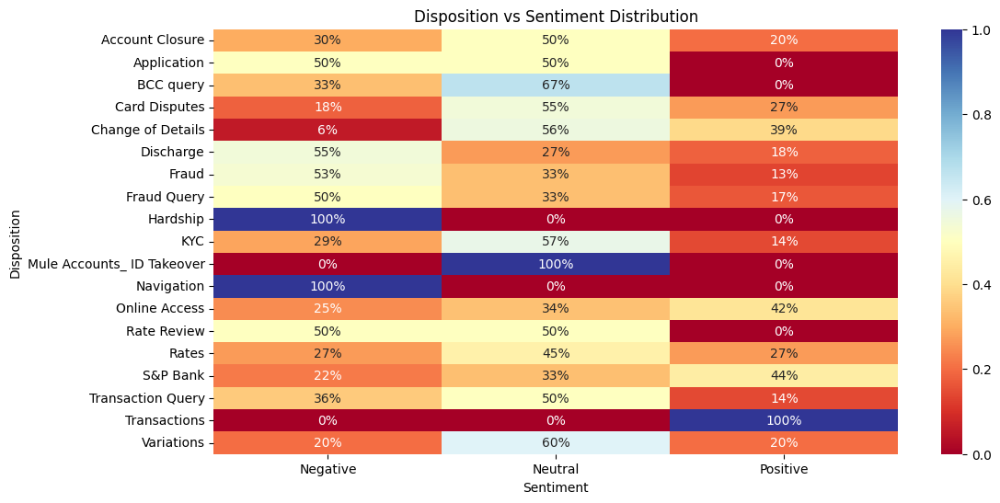

/tmp/ipython-input-4020443478.py:135: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)


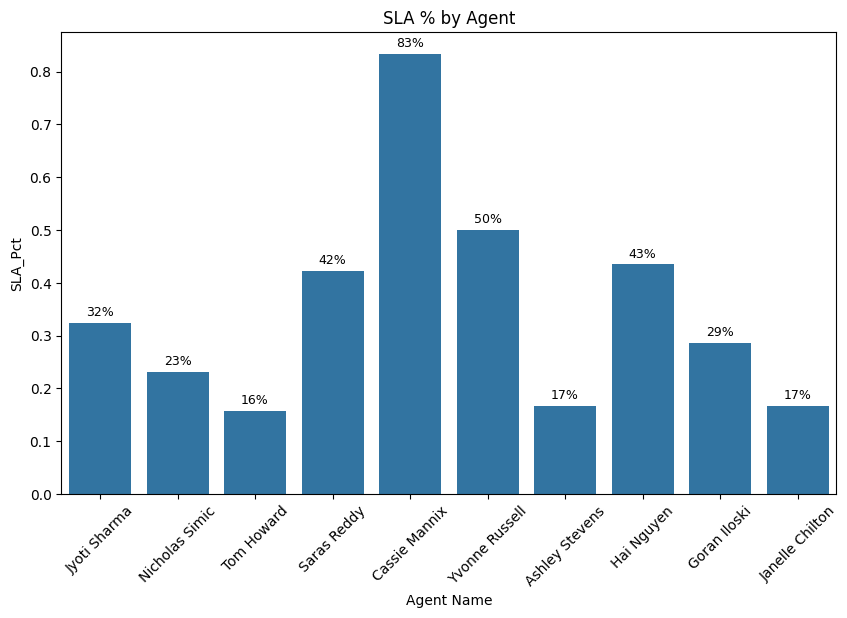

/tmp/ipython-input-4020443478.py:142: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)


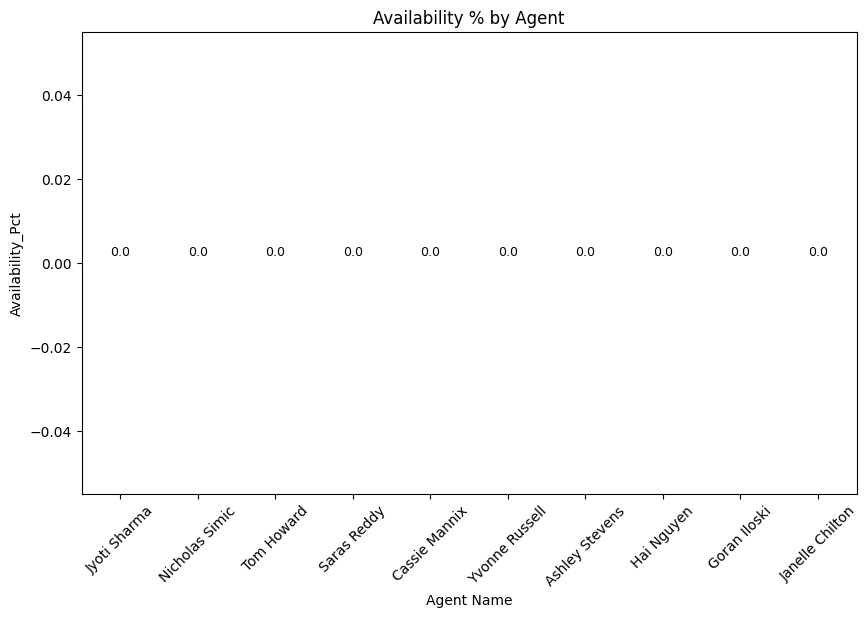

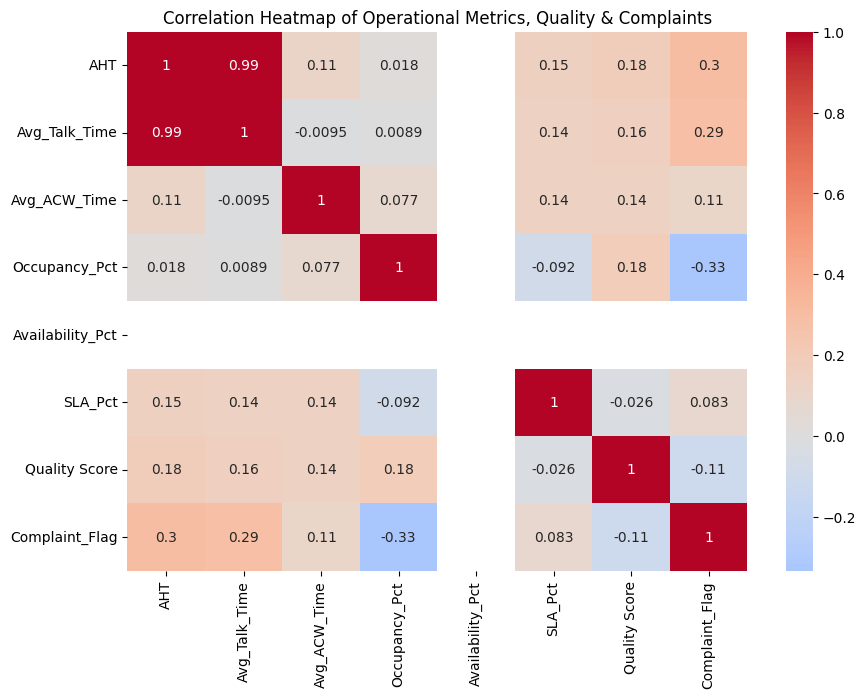

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# ==============================
# 1. Data Cleaning
# ==============================
# Complaint flag ensure numeric
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})
else:
    df["Complaint_Flag"] = 0

df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# ==============================
# Helper function to add labels
# ==============================
def add_labels(ax, fmt="{:.0f}"):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(fmt.format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

def add_labels_percent(ax):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate("{:.0%}".format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

# ==============================
# 2. Agent-Level KPIs
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Quality Score by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Handle Time (AHT) by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Occupancy % by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

# ==============================
# 3. Caller Type Insights
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Caller Type", data=df, palette="Set2")
plt.title("Call Volume by Caller Type")
add_labels(ax, fmt="{:.0f}")
plt.show()

complaints_by_type = df.groupby("Caller Type")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(7,5))
ax = sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set1")
plt.title("Complaint Rate by Caller Type")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 4. Call Outcome & Disposition
# ==============================
plt.figure(figsize=(10,6))
ax = sns.countplot(x="Call Outcome", data=df, order=df["Call Outcome"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Outcome Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

plt.figure(figsize=(10,6))
ax = sns.countplot(x="Disposition", data=df, order=df["Disposition"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Disposition Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

disposition_complaints = df.groupby("Disposition")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints, palette="coolwarm")
plt.xticks(rotation=45)
plt.title("Complaint Rate by Disposition")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 5. Sentiment Analysis
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Sentiment", data=df, palette="muted")
plt.title("Overall Sentiment Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn", fmt=".0%")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

disposition_sentiment = pd.crosstab(df["Disposition"], df["Sentiment"], normalize="index")
plt.figure(figsize=(12,6))
sns.heatmap(disposition_sentiment, annot=True, cmap="RdYlBu", fmt=".0%")
plt.title("Disposition vs Sentiment Distribution")
plt.show()

# ==============================
# 6. SLA & Utilization
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("SLA % by Agent")
add_labels_percent(ax)
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Availability % by Agent")
add_labels(ax, fmt="{:.1f}")
plt.show()

# ==============================
# 7. Correlations of KPIs
# ==============================
num_cols = [
    "AHT", "Avg_Talk_Time", "Avg_ACW_Time",
    "Occupancy_Pct", "Availability_Pct", "SLA_Pct",
    "Quality Score", "Complaint_Flag"
]

corr = df[num_cols].corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Heatmap of Operational Metrics, Quality & Complaints")
plt.show()


/tmp/ipython-input-2685158605.py:52: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)


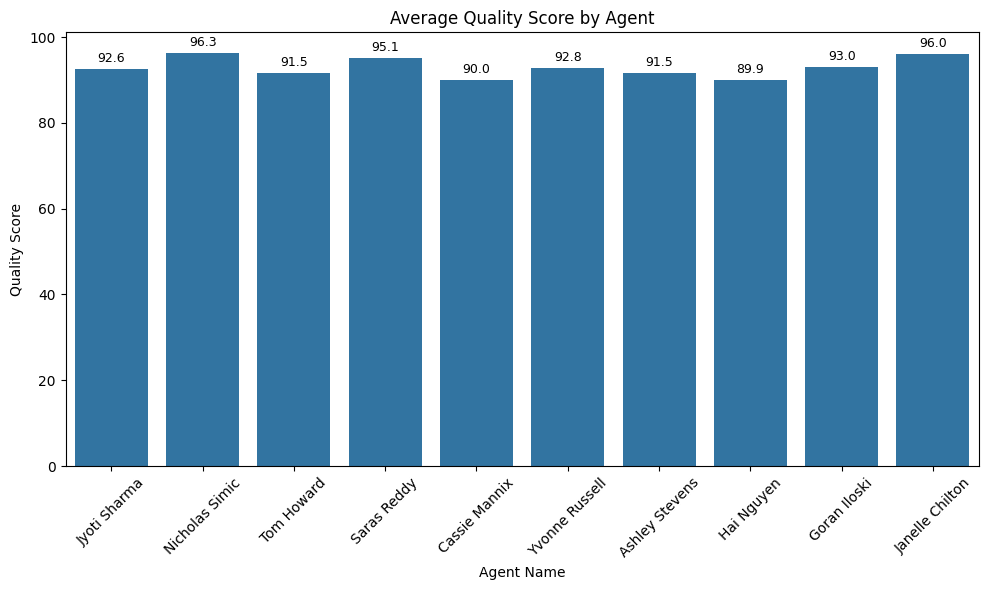

/tmp/ipython-input-2685158605.py:60: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)


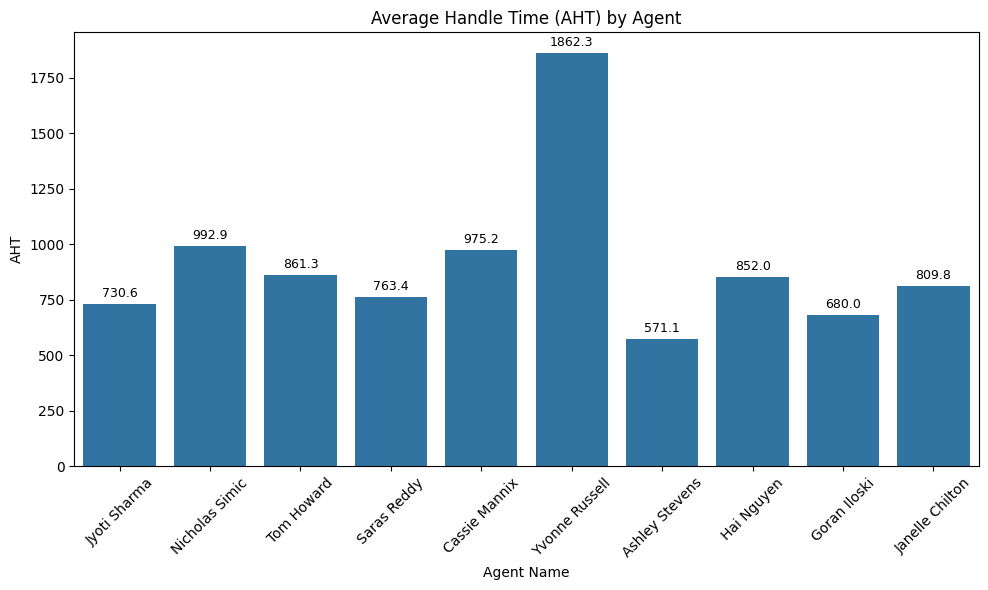

/tmp/ipython-input-2685158605.py:68: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)


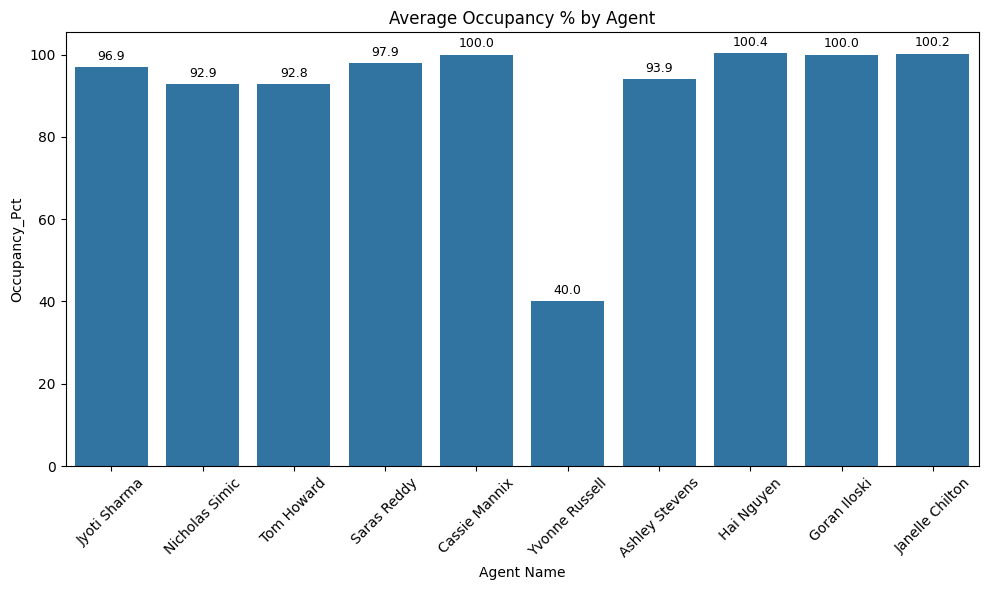

/tmp/ipython-input-2685158605.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Caller Type", data=df, palette="Set2")


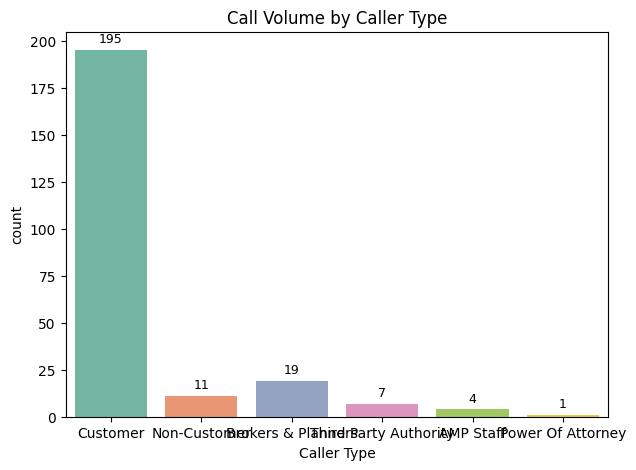

/tmp/ipython-input-2685158605.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set1")


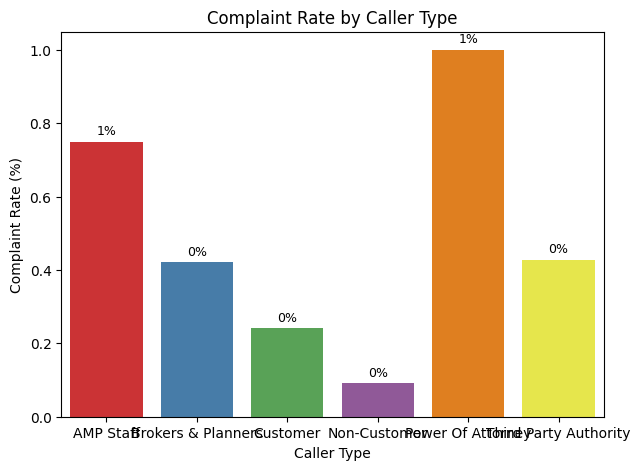

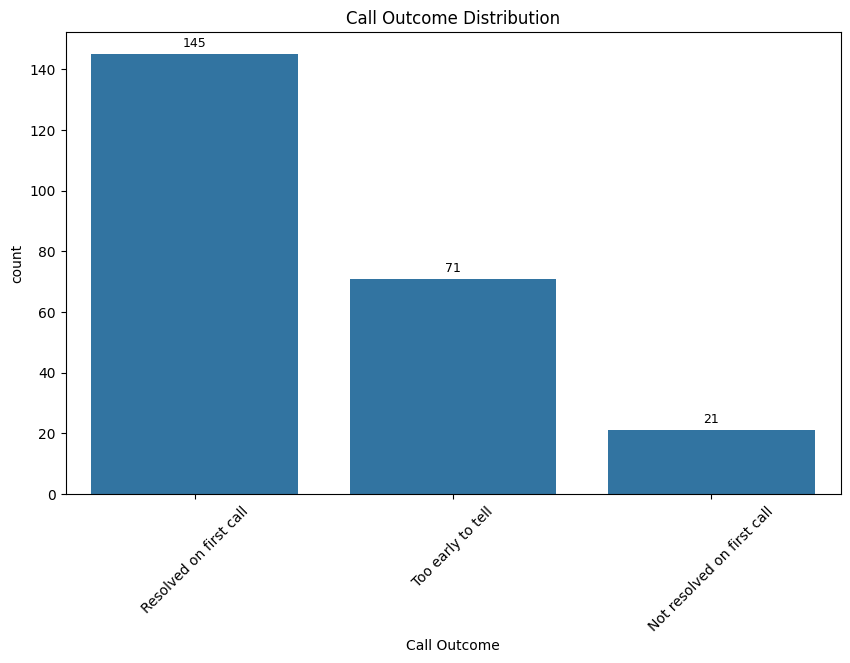

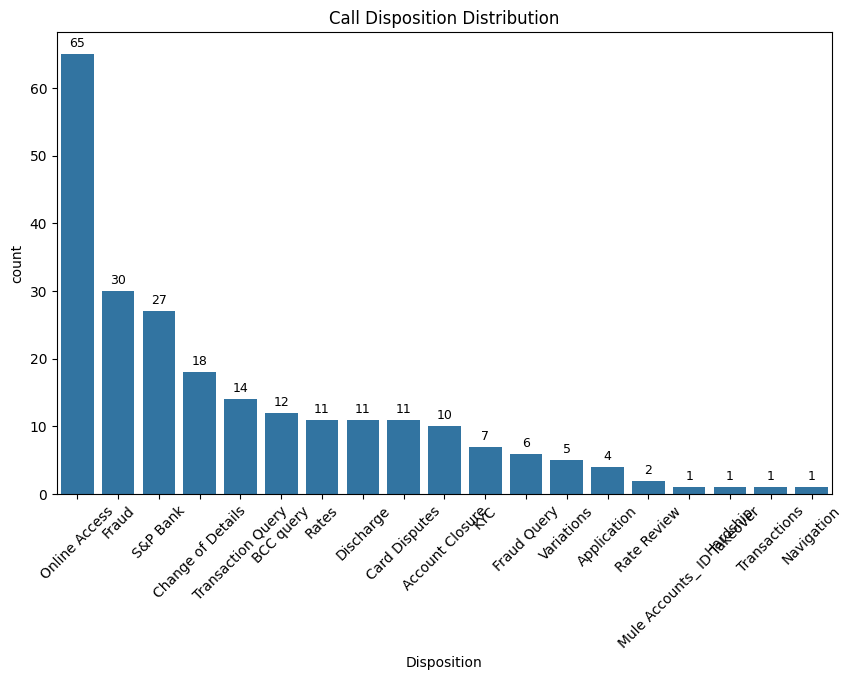

/tmp/ipython-input-2685158605.py:111: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints, palette="coolwarm")


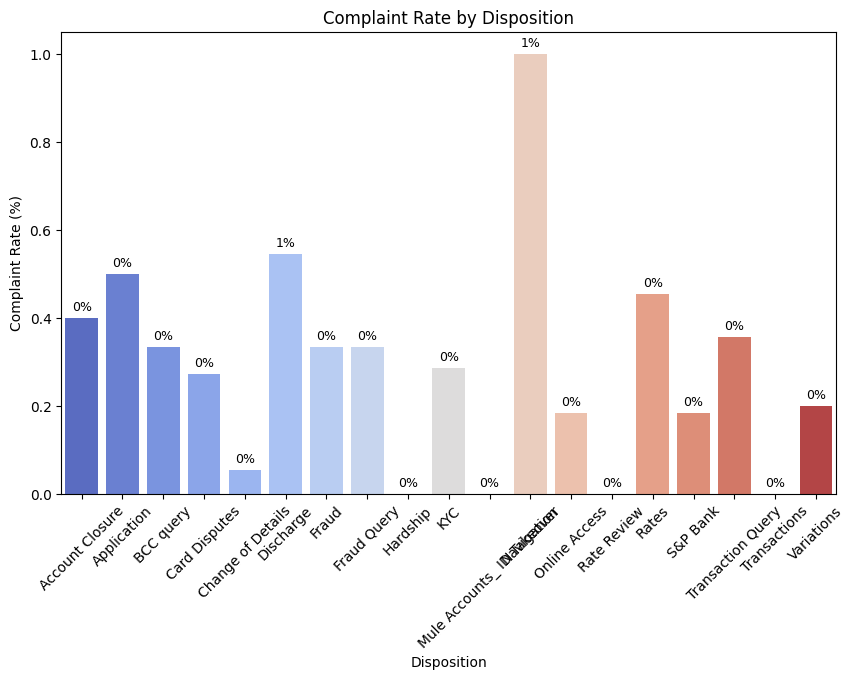

/tmp/ipython-input-2685158605.py:122: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Sentiment", data=df, palette="muted")


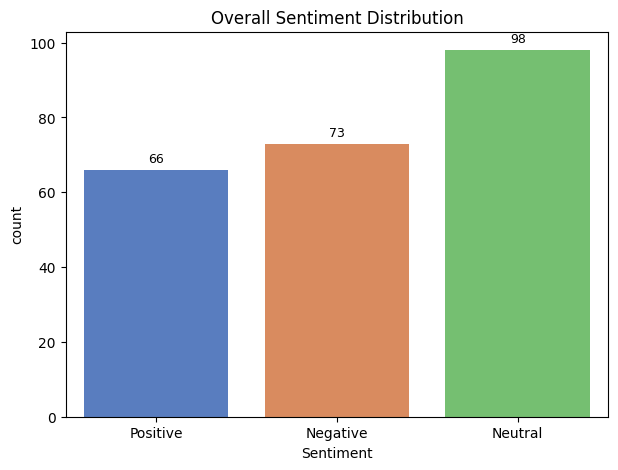

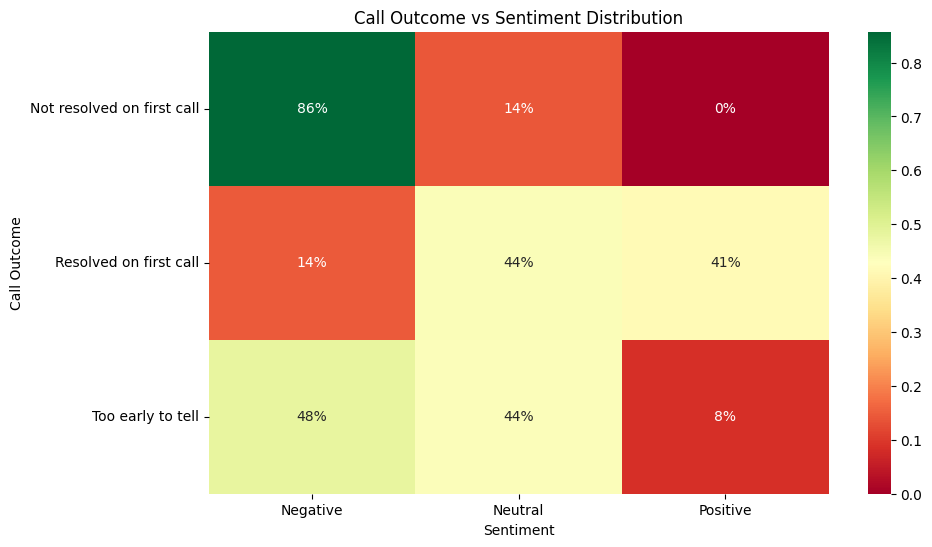

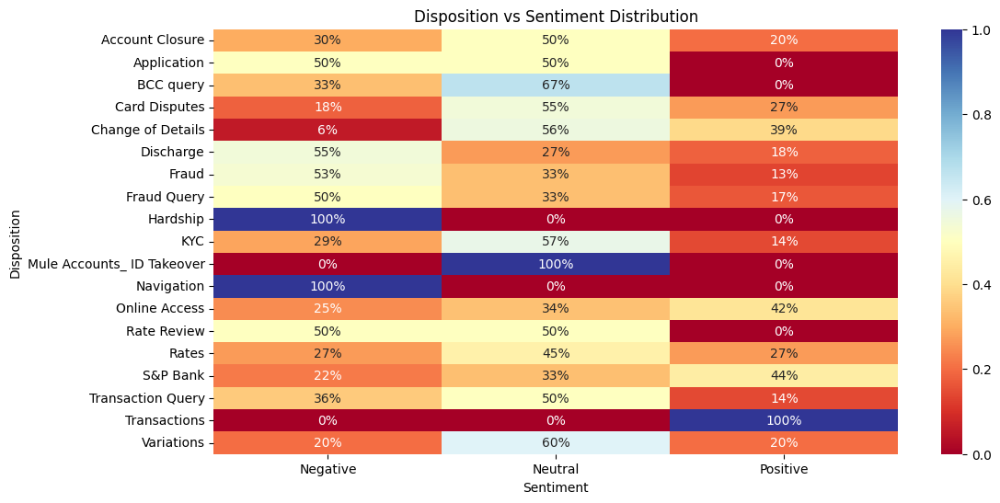

/tmp/ipython-input-2685158605.py:143: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)


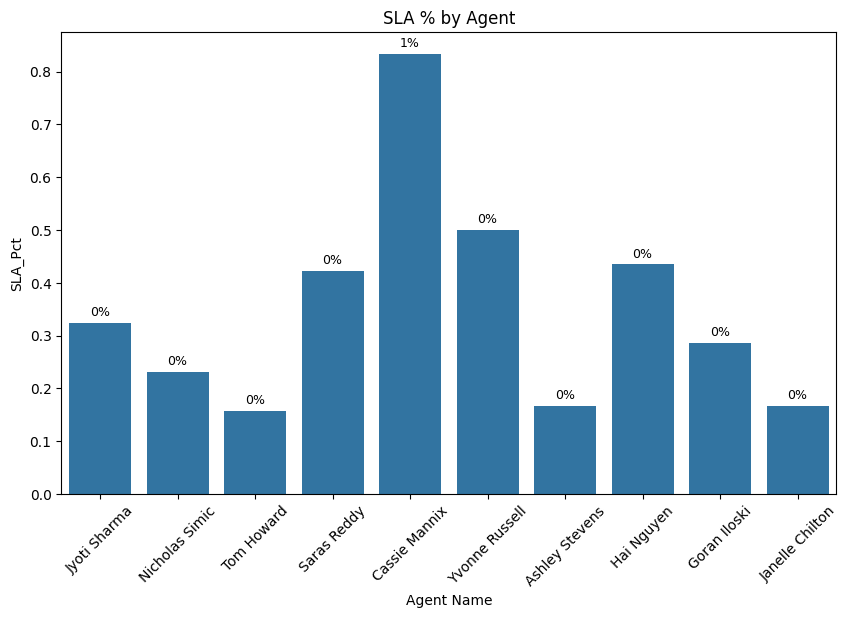

/tmp/ipython-input-2685158605.py:150: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)


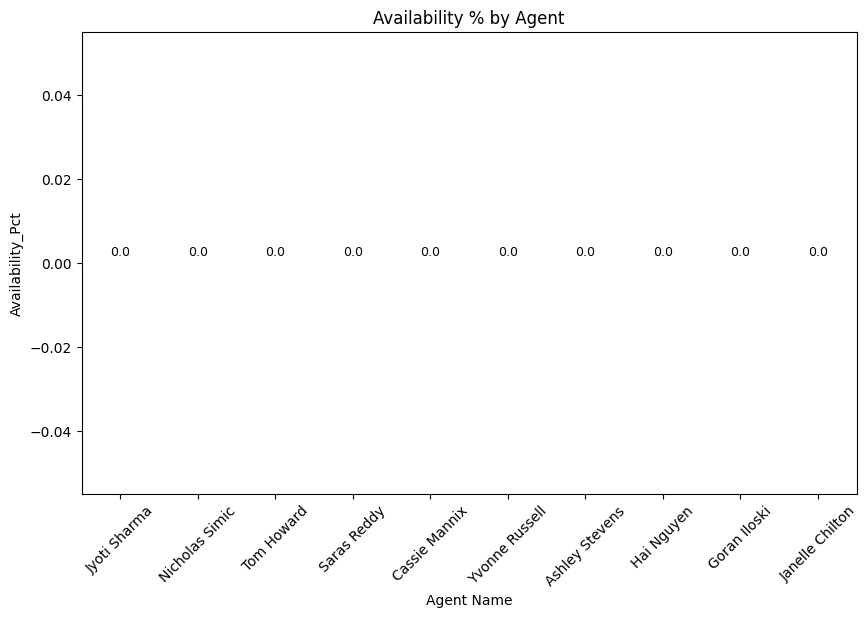

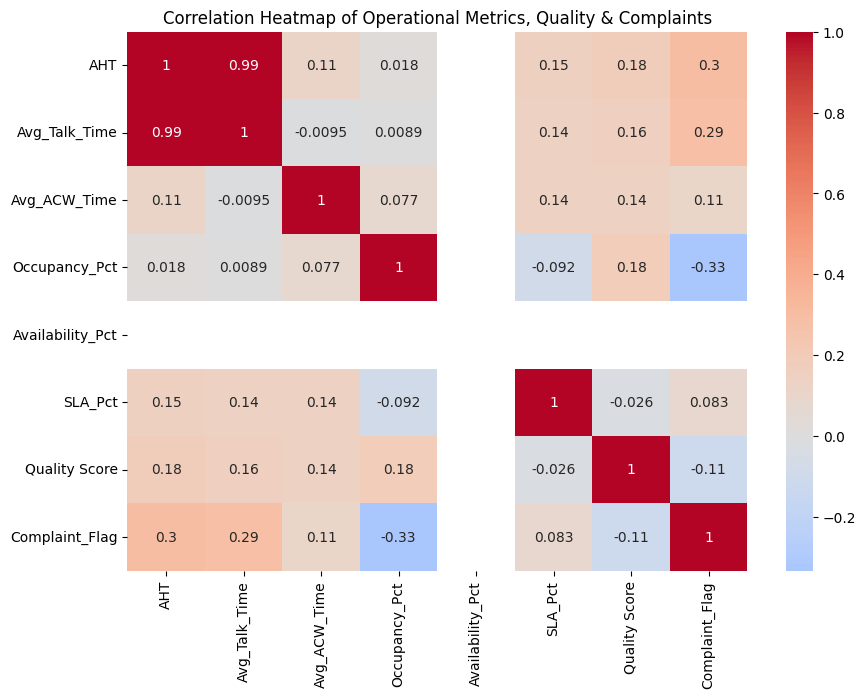

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# ==============================
# 1. Data Cleaning
# ==============================
# Complaint flag ensure numeric
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})
else:
    df["Complaint_Flag"] = 0

# Quality Score numeric
df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# Ensure Availability_Pct exists
if "Availability_Pct" not in df.columns and "Available Time" in df.columns and "Login Time" in df.columns:
    df["Availability_Pct"] = (df["Available Time"] / df["Login Time"].replace(0, pd.NA)) * 100

# Fill NaN with 0 for visualization
df["Availability_Pct"] = df["Availability_Pct"].fillna(0)

# ==============================
# Helper functions for labels
# ==============================
def add_labels(ax, fmt="{:.0f}"):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(fmt.format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

def add_labels_percent(ax):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate("{:.0f}%".format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

# ==============================
# 2. Agent-Level KPIs
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Quality Score by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Handle Time (AHT) by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Occupancy % by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

# ==============================
# 3. Caller Type Insights
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Caller Type", data=df, palette="Set2")
plt.title("Call Volume by Caller Type")
add_labels(ax, fmt="{:.0f}")
plt.show()

complaints_by_type = df.groupby("Caller Type")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(7,5))
ax = sns.barplot(x="Caller Type", y="Complaint_Flag", data=complaints_by_type, palette="Set1")
plt.title("Complaint Rate by Caller Type")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 4. Call Outcome & Disposition
# ==============================
plt.figure(figsize=(10,6))
ax = sns.countplot(x="Call Outcome", data=df, order=df["Call Outcome"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Outcome Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

plt.figure(figsize=(10,6))
ax = sns.countplot(x="Disposition", data=df, order=df["Disposition"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Disposition Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

disposition_complaints = df.groupby("Disposition")["Complaint_Flag"].mean().reset_index()
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Disposition", y="Complaint_Flag", data=disposition_complaints, palette="coolwarm")
plt.xticks(rotation=45)
plt.title("Complaint Rate by Disposition")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 5. Sentiment Analysis
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Sentiment", data=df, palette="muted")
plt.title("Overall Sentiment Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn", fmt=".0%")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

disposition_sentiment = pd.crosstab(df["Disposition"], df["Sentiment"], normalize="index")
plt.figure(figsize=(12,6))
sns.heatmap(disposition_sentiment, annot=True, cmap="RdYlBu", fmt=".0%")
plt.title("Disposition vs Sentiment Distribution")
plt.show()

# ==============================
# 6. SLA & Availability
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("SLA % by Agent")
add_labels_percent(ax)
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Availability % by Agent")
add_labels(ax, fmt="{:.1f}")
plt.show()

# ==============================
# 7. Correlation Heatmap
# ==============================
num_cols = [
    "AHT", "Avg_Talk_Time", "Avg_ACW_Time",
    "Occupancy_Pct", "Availability_Pct", "SLA_Pct",
    "Quality Score", "Complaint_Flag"
]

corr = df[num_cols].corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Heatmap of Operational Metrics, Quality & Complaints")
plt.show()


/tmp/ipython-input-2191727889.py:59: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)


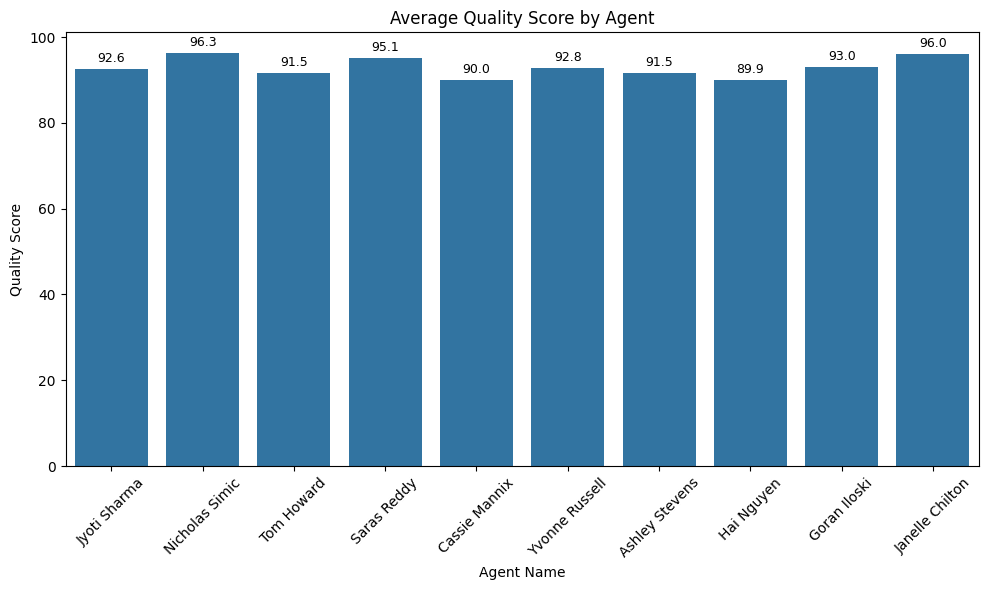

/tmp/ipython-input-2191727889.py:67: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)


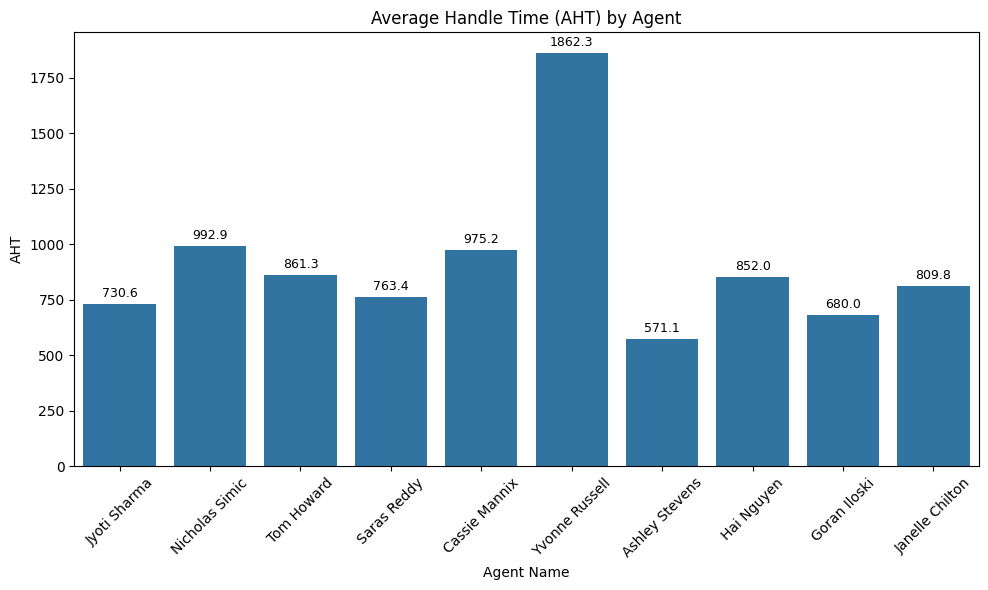

/tmp/ipython-input-2191727889.py:75: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)


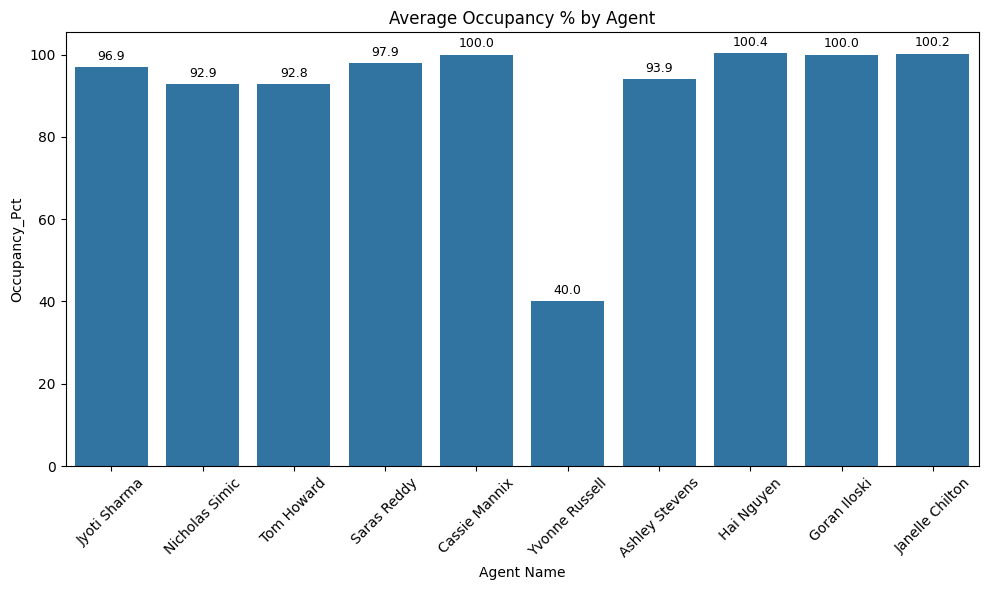

/tmp/ipython-input-2191727889.py:84: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)


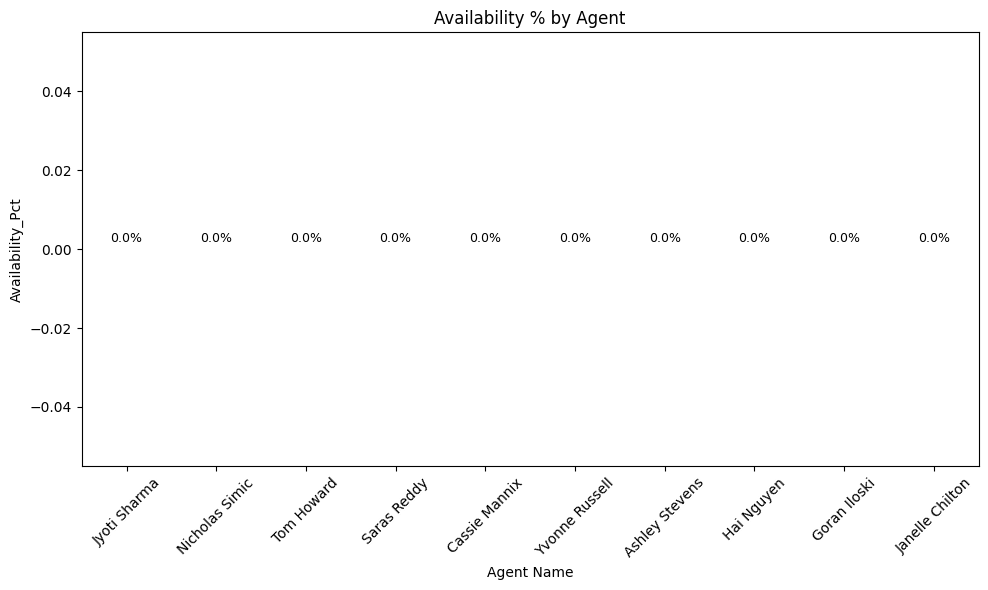

/tmp/ipython-input-2191727889.py:93: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Utilization_Pct", data=df, estimator="mean", ci=None)


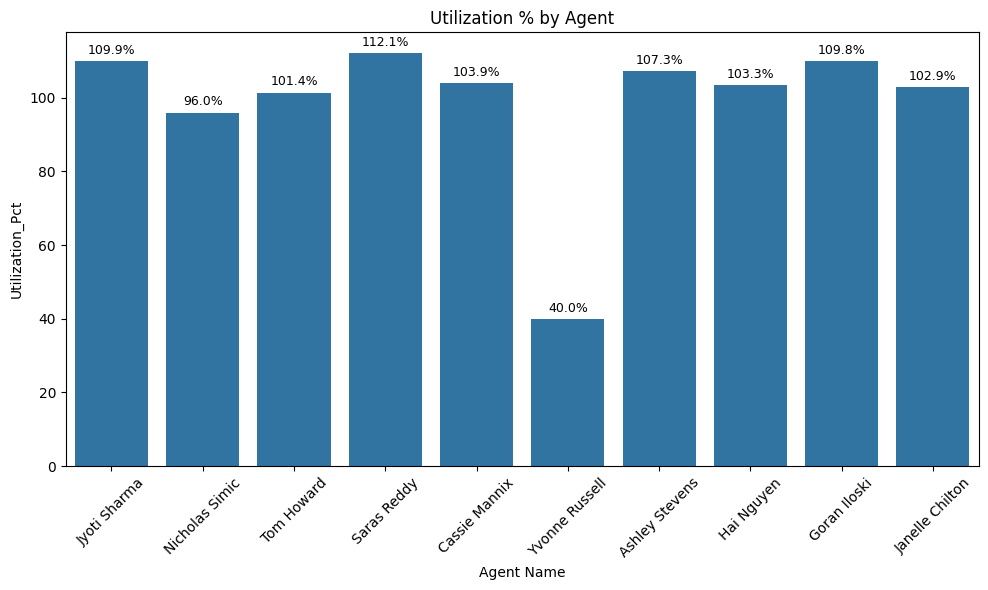

/tmp/ipython-input-2191727889.py:104: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Caller Type", data=df, palette="Set2")


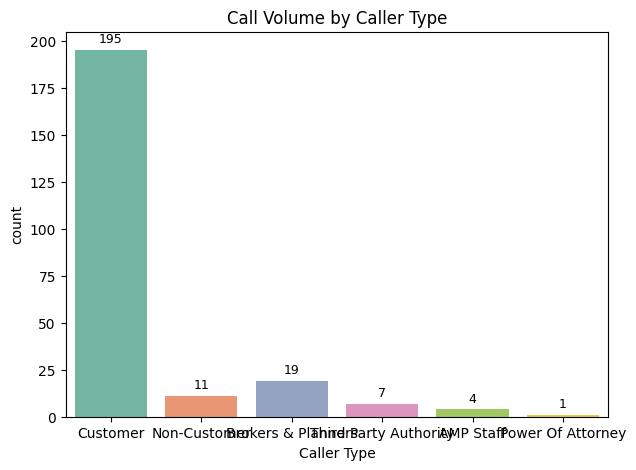

/tmp/ipython-input-2191727889.py:117: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Caller Type", y="Complaint_Rate", data=complaints_by_type, palette="Set1")


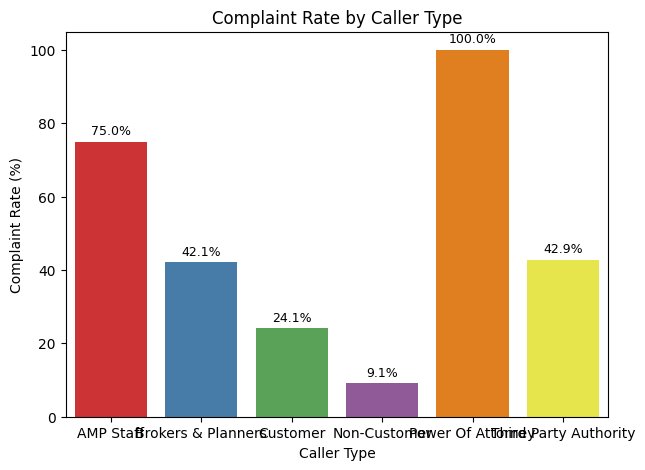

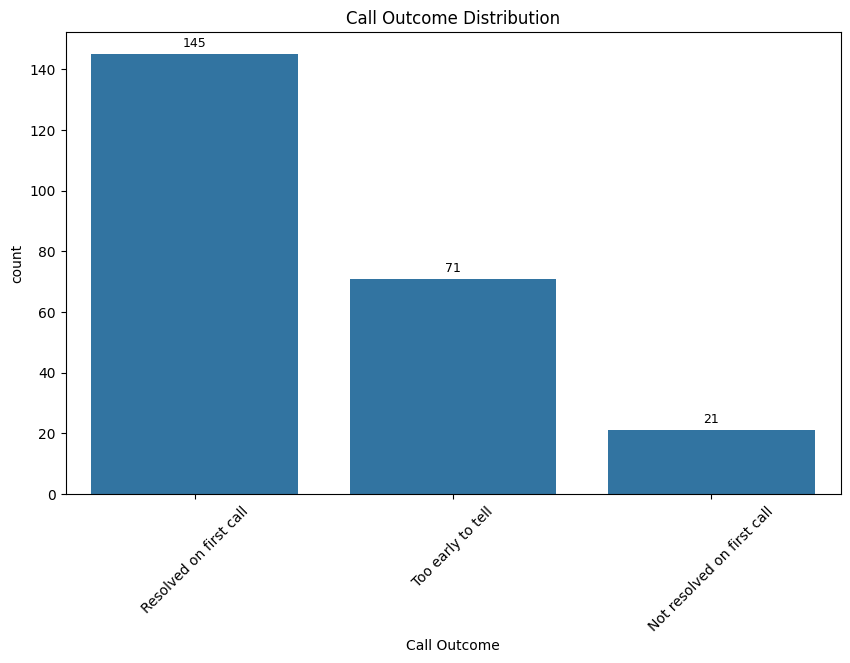

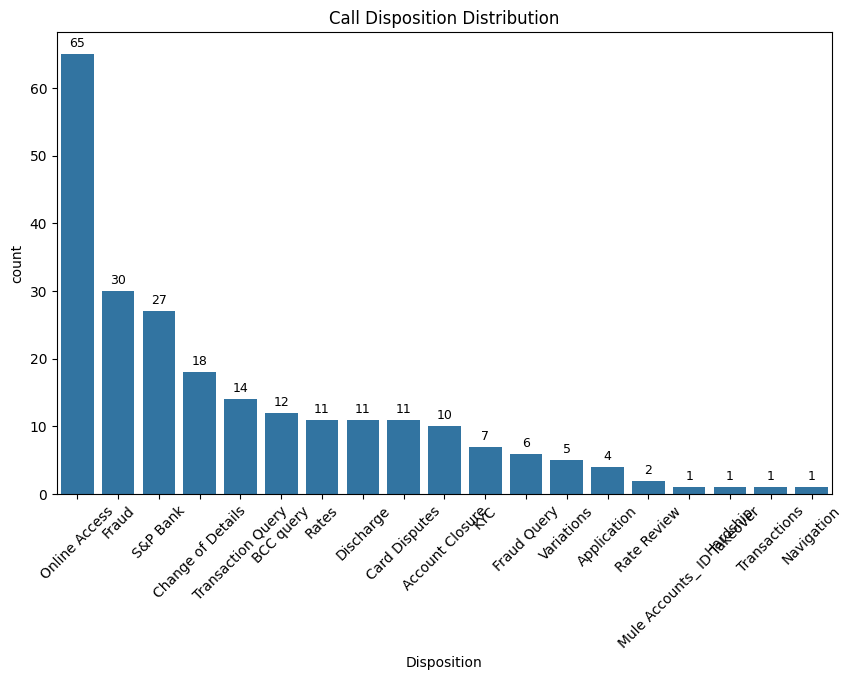

/tmp/ipython-input-2191727889.py:147: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Disposition", y="Complaint_Rate", data=disposition_complaints, palette="coolwarm")


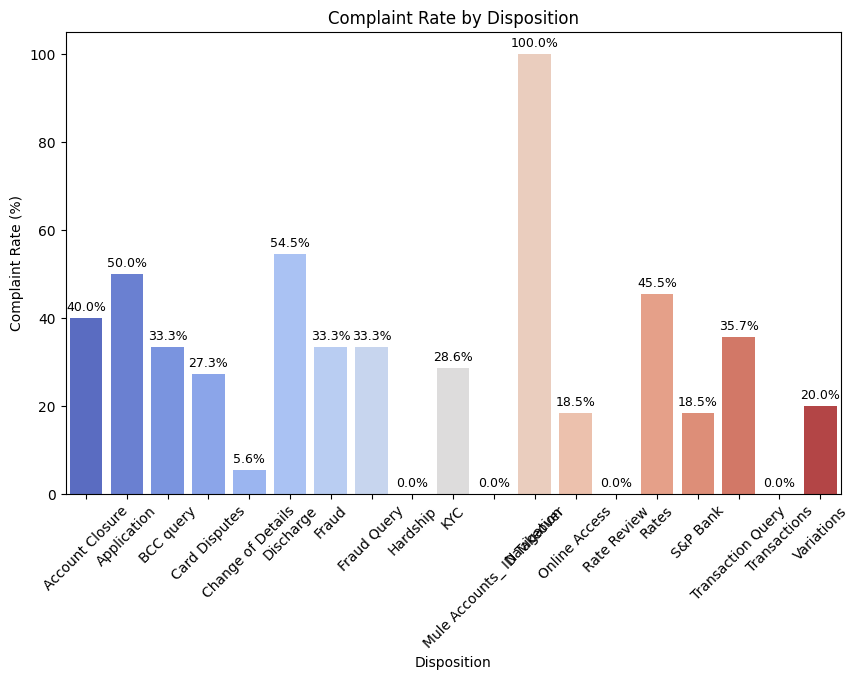

/tmp/ipython-input-2191727889.py:158: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Sentiment", data=df, palette="muted")


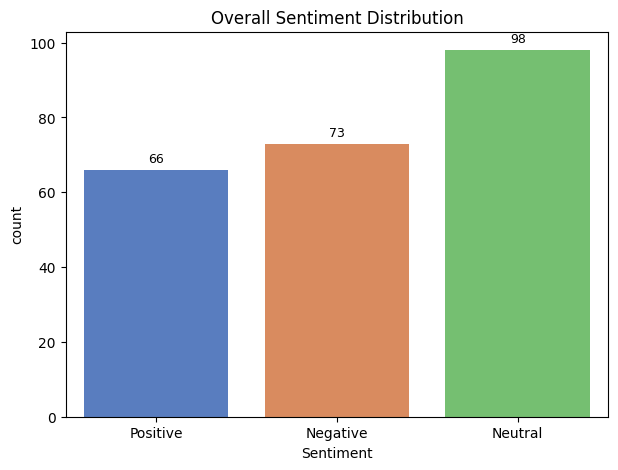

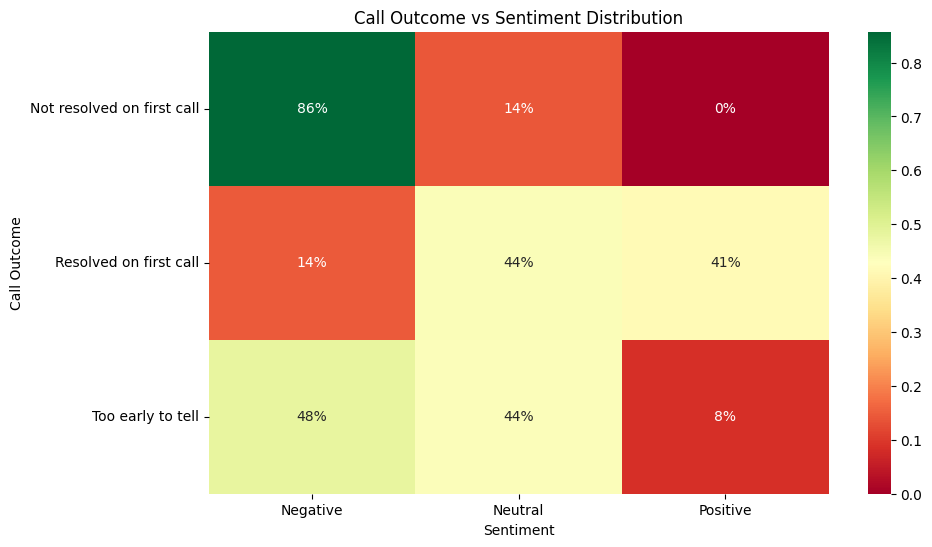

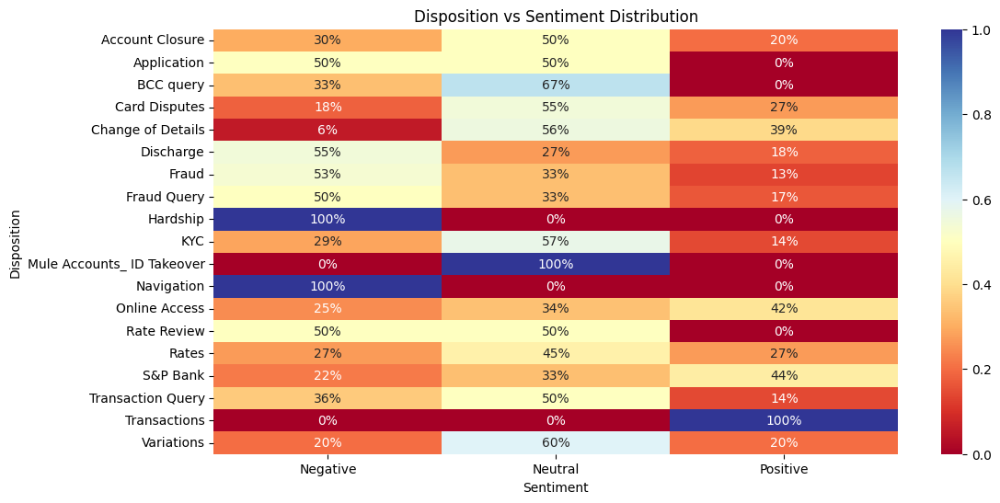

/tmp/ipython-input-2191727889.py:179: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)


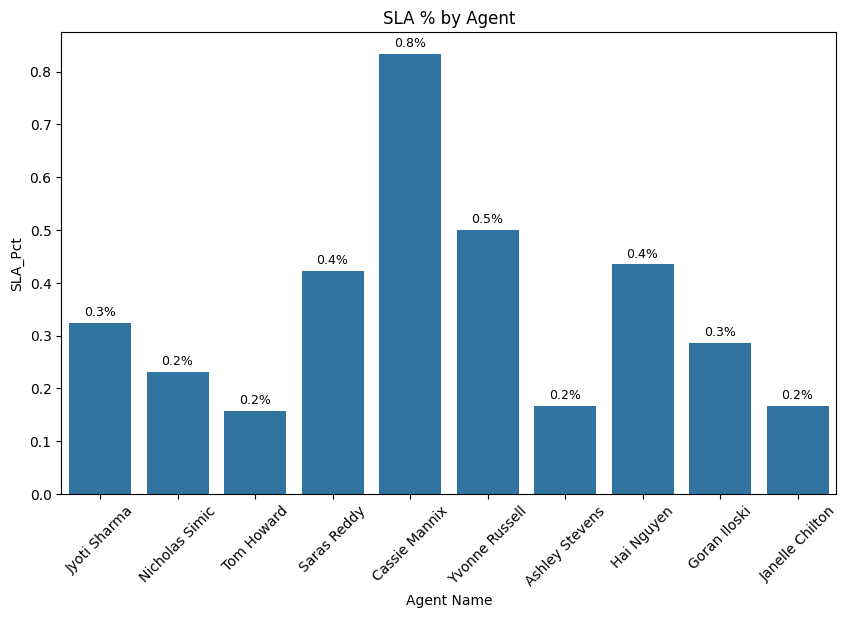

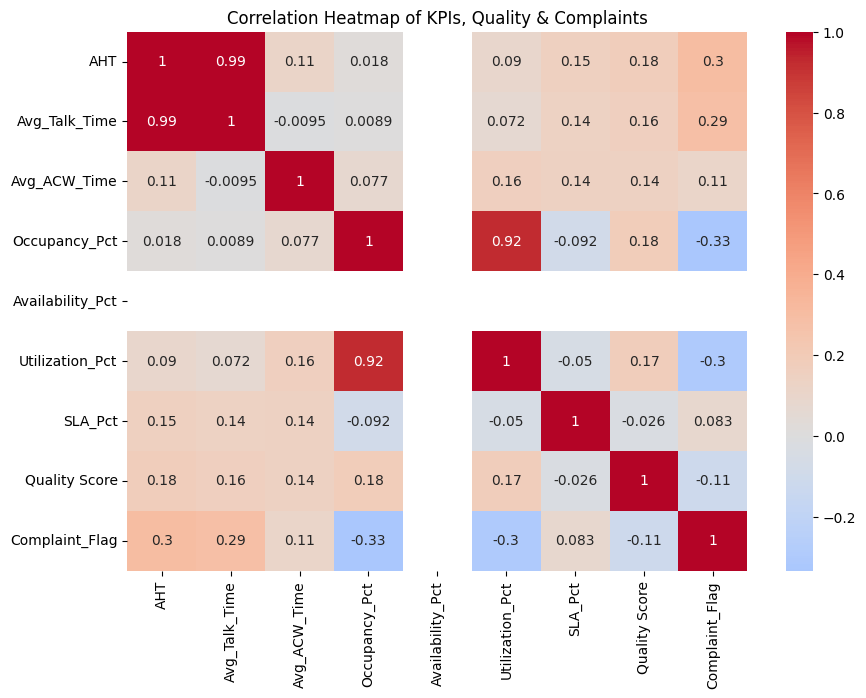

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ==============================
# 1. Load dataset
# ==============================
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# ==============================
# 2. Data Cleaning
# ==============================
# Complaint flag ensure numeric 0/1
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})
else:
    df["Complaint_Flag"] = 0

# Quality Score numeric
df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# Availability %
if "Available Time" in df.columns and "Login Time" in df.columns:
    df["Availability_Pct"] = (df["Available Time"].fillna(0) / df["Login Time"].replace(0, pd.NA)) * 100
else:
    df["Availability_Pct"] = 0

# Utilization % = (Talk + ACW + Hold) / Login × 100
if all(col in df.columns for col in ["Talk Time", "ACW Time", "Hold Time", "Login Time"]):
    df["Utilization_Pct"] = (df["Talk Time"] + df["ACW Time"] + df["Hold Time"]) / df["Login Time"].replace(0, pd.NA) * 100
else:
    df["Utilization_Pct"] = 0

# ==============================
# Helper functions for labels
# ==============================
def add_labels(ax, fmt="{:.0f}"):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(fmt.format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

def add_labels_percent(ax):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(f"{value:.1f}%",
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

# ==============================
# 3. Agent-Level KPIs
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Quality Score by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Handle Time (AHT) by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Occupancy % by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

# Availability
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Availability % by Agent")
add_labels_percent(ax)
plt.tight_layout()
plt.show()

# Utilization
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Utilization_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Utilization % by Agent")
add_labels_percent(ax)
plt.tight_layout()
plt.show()

# ==============================
# 4. Caller Type Insights
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Caller Type", data=df, palette="Set2")
plt.title("Call Volume by Caller Type")
add_labels(ax, fmt="{:.0f}")
plt.show()

# Complaint Rate by Caller Type
complaints_by_type = df.groupby("Caller Type").agg(
    Total_Calls=("Complaint_Flag", "count"),
    Complaints=("Complaint_Flag", "sum")
).reset_index()
complaints_by_type["Complaint_Rate"] = complaints_by_type["Complaints"] / complaints_by_type["Total_Calls"] * 100

plt.figure(figsize=(7,5))
ax = sns.barplot(x="Caller Type", y="Complaint_Rate", data=complaints_by_type, palette="Set1")
plt.title("Complaint Rate by Caller Type")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 5. Call Outcome & Disposition
# ==============================
plt.figure(figsize=(10,6))
ax = sns.countplot(x="Call Outcome", data=df, order=df["Call Outcome"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Outcome Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

plt.figure(figsize=(10,6))
ax = sns.countplot(x="Disposition", data=df, order=df["Disposition"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Disposition Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

disposition_complaints = df.groupby("Disposition").agg(
    Total_Calls=("Complaint_Flag", "count"),
    Complaints=("Complaint_Flag", "sum")
).reset_index()
disposition_complaints["Complaint_Rate"] = disposition_complaints["Complaints"] / disposition_complaints["Total_Calls"] * 100

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Disposition", y="Complaint_Rate", data=disposition_complaints, palette="coolwarm")
plt.xticks(rotation=45)
plt.title("Complaint Rate by Disposition")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 6. Sentiment Analysis
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Sentiment", data=df, palette="muted")
plt.title("Overall Sentiment Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn", fmt=".0%")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

disposition_sentiment = pd.crosstab(df["Disposition"], df["Sentiment"], normalize="index")
plt.figure(figsize=(12,6))
sns.heatmap(disposition_sentiment, annot=True, cmap="RdYlBu", fmt=".0%")
plt.title("Disposition vs Sentiment Distribution")
plt.show()

# ==============================
# 7. SLA
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("SLA % by Agent")
add_labels_percent(ax)
plt.show()

# ==============================
# 8. Correlation Heatmap
# ==============================
num_cols = [
    "AHT", "Avg_Talk_Time", "Avg_ACW_Time",
    "Occupancy_Pct", "Availability_Pct", "Utilization_Pct", "SLA_Pct",
    "Quality Score", "Complaint_Flag"
]

corr = df[num_cols].corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Heatmap of KPIs, Quality & Complaints")
plt.show()


/tmp/ipython-input-2191727889.py:59: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)


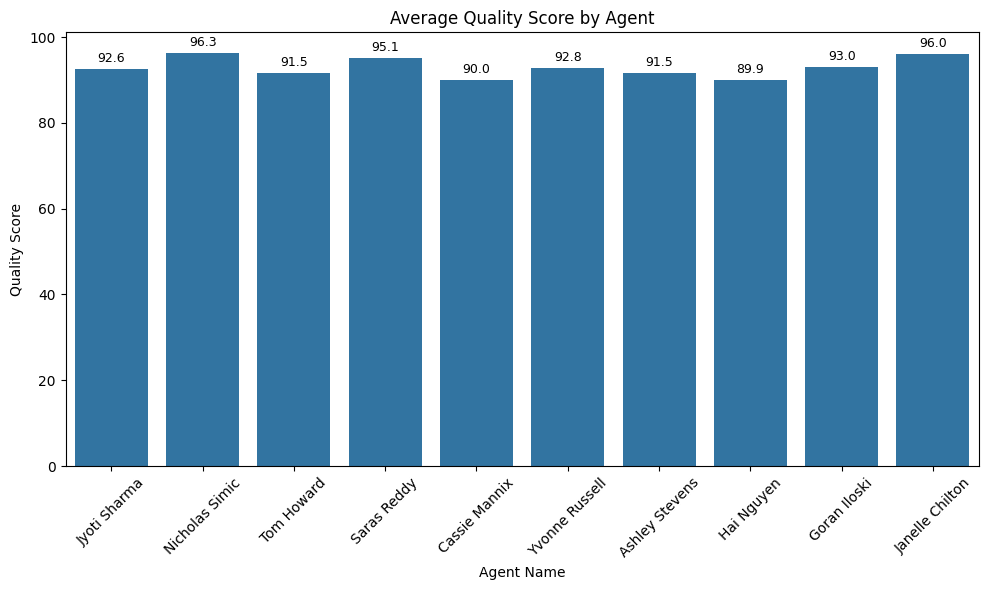

/tmp/ipython-input-2191727889.py:67: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)


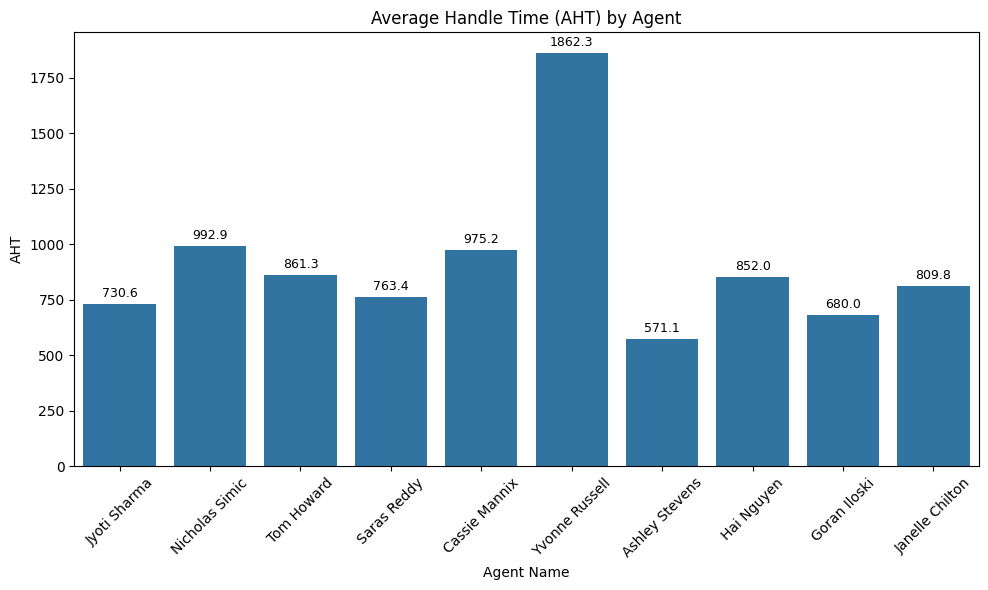

/tmp/ipython-input-2191727889.py:75: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)


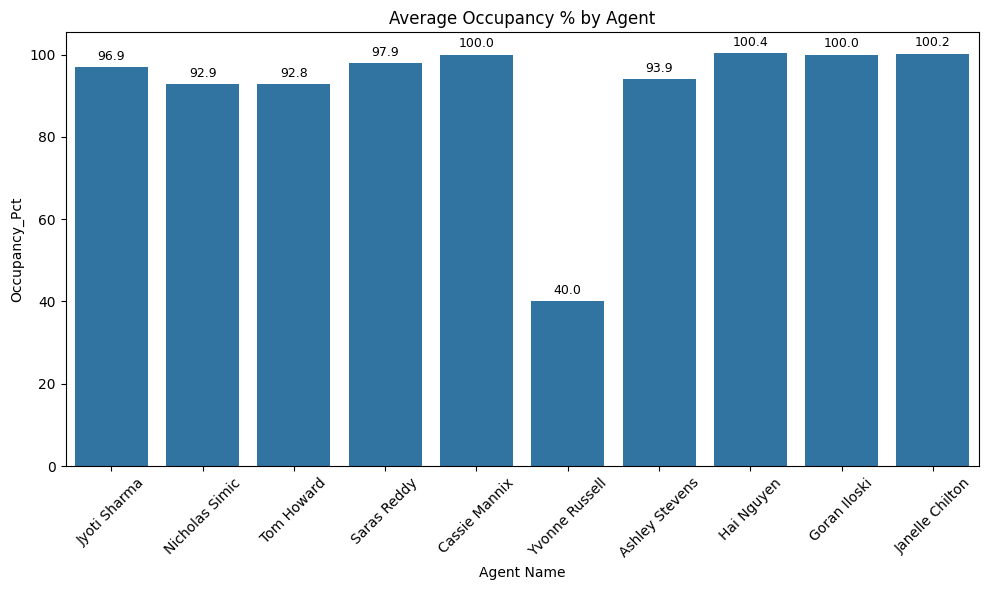

/tmp/ipython-input-2191727889.py:84: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)


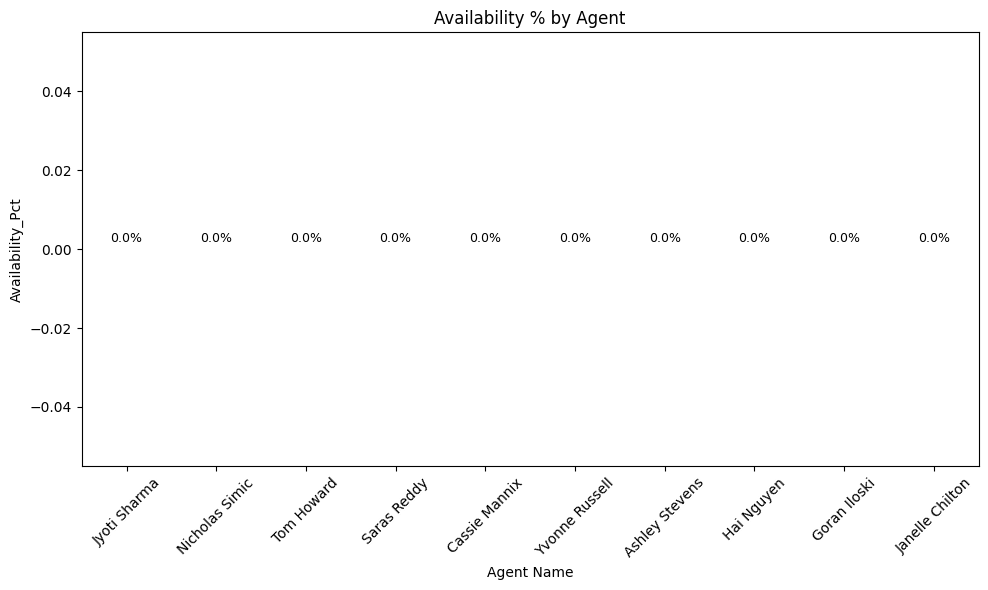

/tmp/ipython-input-2191727889.py:93: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="Utilization_Pct", data=df, estimator="mean", ci=None)


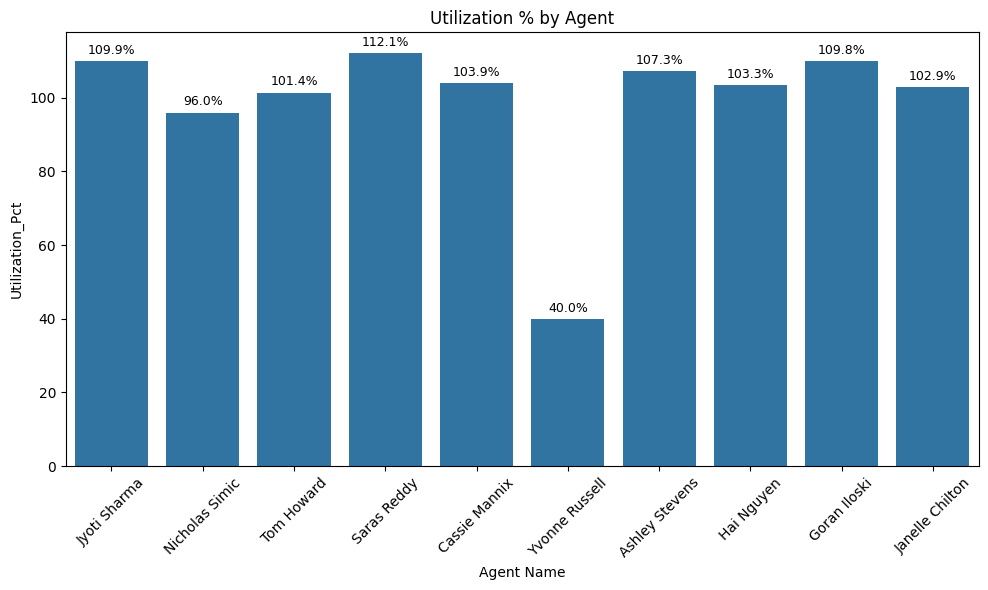

/tmp/ipython-input-2191727889.py:104: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Caller Type", data=df, palette="Set2")


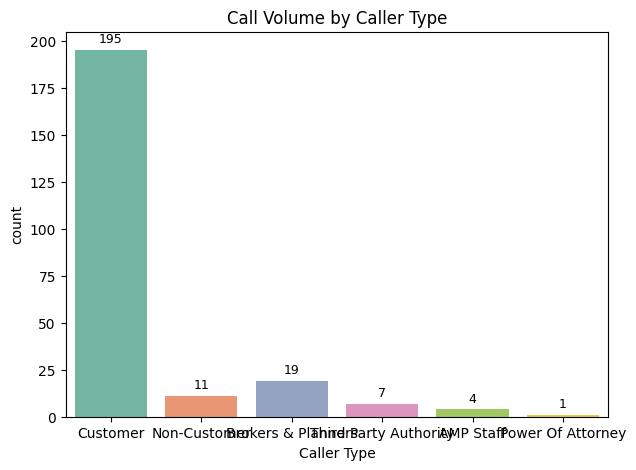

/tmp/ipython-input-2191727889.py:117: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Caller Type", y="Complaint_Rate", data=complaints_by_type, palette="Set1")


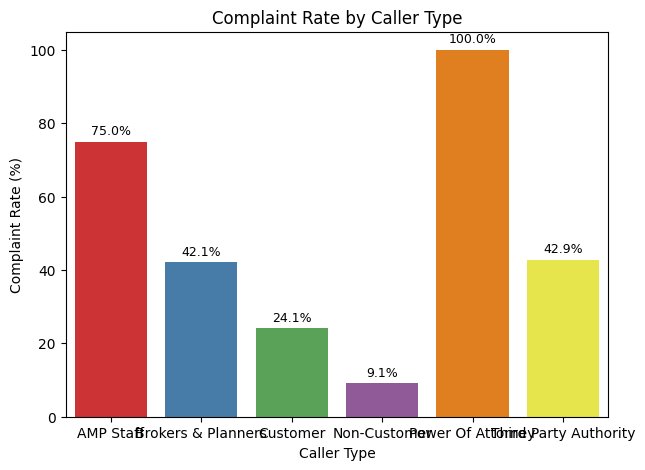

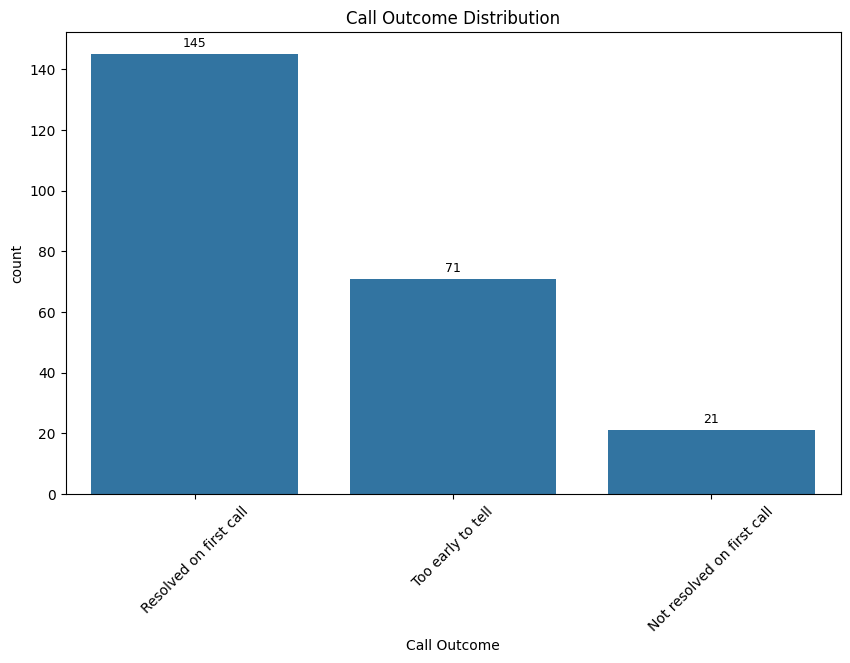

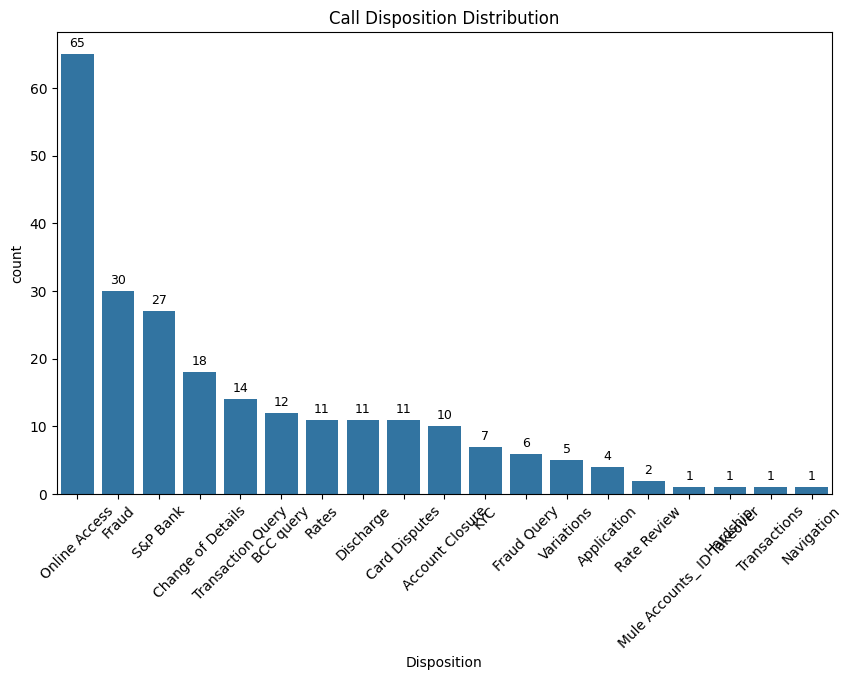

/tmp/ipython-input-2191727889.py:147: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Disposition", y="Complaint_Rate", data=disposition_complaints, palette="coolwarm")


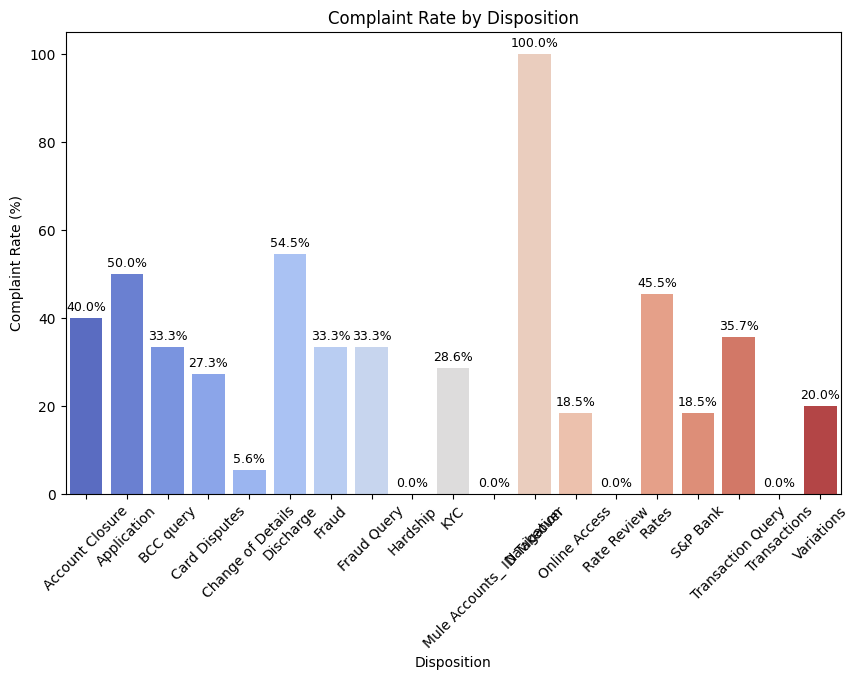

/tmp/ipython-input-2191727889.py:158: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Sentiment", data=df, palette="muted")


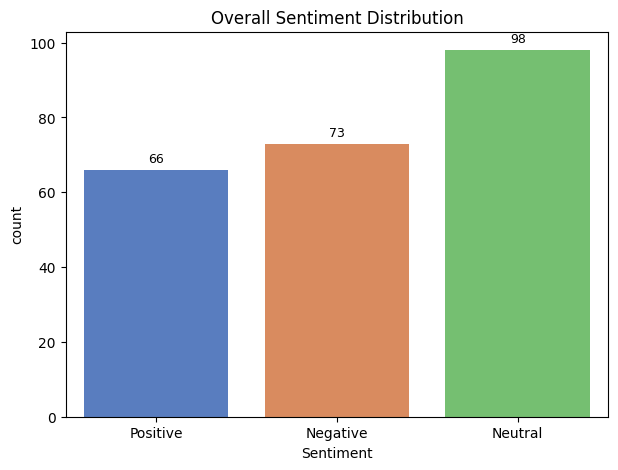

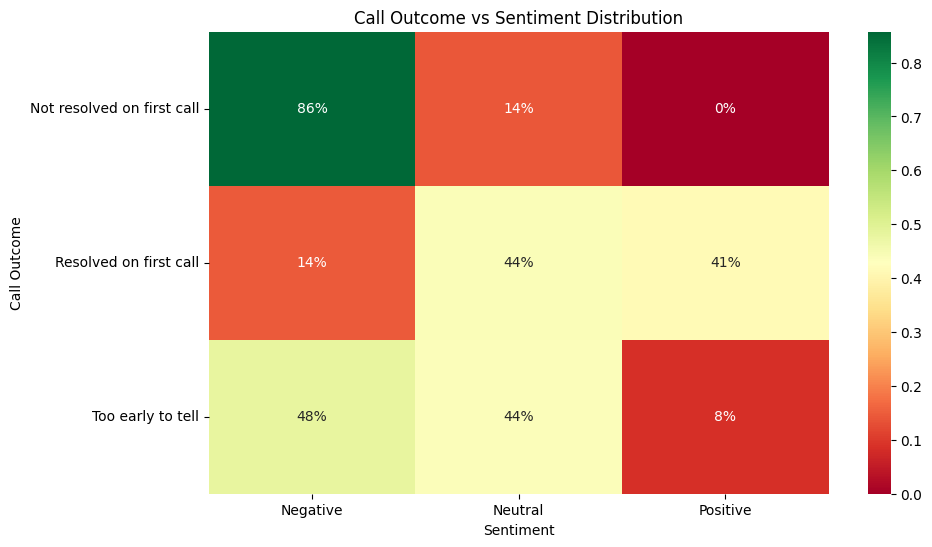

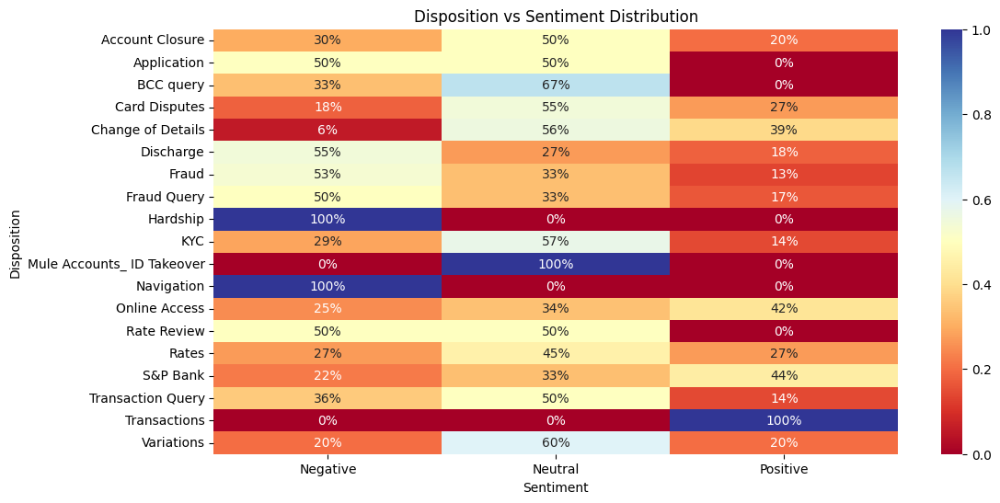

/tmp/ipython-input-2191727889.py:179: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)


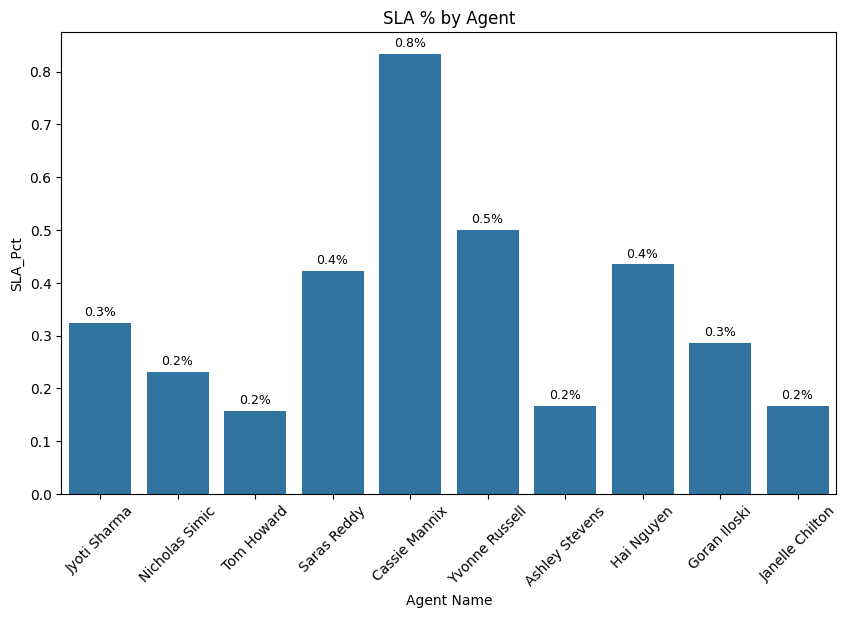

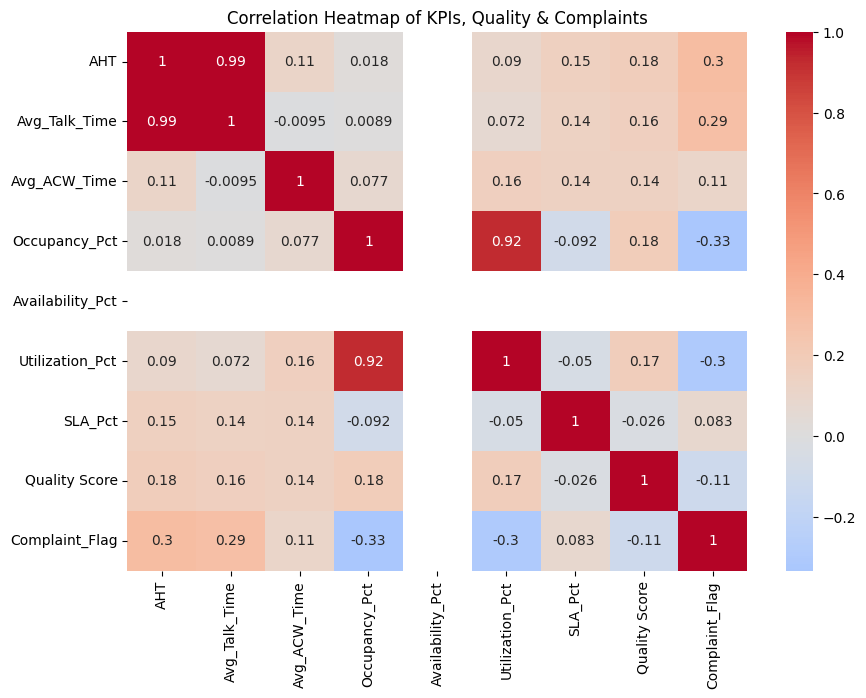

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ==============================
# 1. Load dataset
# ==============================
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# ==============================
# 2. Data Cleaning
# ==============================
# Complaint flag ensure numeric 0/1
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})
else:
    df["Complaint_Flag"] = 0

# Quality Score numeric
df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# Availability %
if "Available Time" in df.columns and "Login Time" in df.columns:
    df["Availability_Pct"] = (df["Available Time"].fillna(0) / df["Login Time"].replace(0, pd.NA)) * 100
else:
    df["Availability_Pct"] = 0

# Utilization % = (Talk + ACW + Hold) / Login × 100
if all(col in df.columns for col in ["Talk Time", "ACW Time", "Hold Time", "Login Time"]):
    df["Utilization_Pct"] = (df["Talk Time"] + df["ACW Time"] + df["Hold Time"]) / df["Login Time"].replace(0, pd.NA) * 100
else:
    df["Utilization_Pct"] = 0

# ==============================
# Helper functions for labels
# ==============================
def add_labels(ax, fmt="{:.0f}"):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(fmt.format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

def add_labels_percent(ax):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(f"{value:.1f}%",
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

# ==============================
# 3. Agent-Level KPIs
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Quality Score", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Quality Score by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="AHT", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Handle Time (AHT) by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Occupancy_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Average Occupancy % by Agent")
add_labels(ax, fmt="{:.1f}")
plt.tight_layout()
plt.show()

# Availability
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Availability_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Availability % by Agent")
add_labels_percent(ax)
plt.tight_layout()
plt.show()

# Utilization
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="Utilization_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("Utilization % by Agent")
add_labels_percent(ax)
plt.tight_layout()
plt.show()

# ==============================
# 4. Caller Type Insights
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Caller Type", data=df, palette="Set2")
plt.title("Call Volume by Caller Type")
add_labels(ax, fmt="{:.0f}")
plt.show()

# Complaint Rate by Caller Type
complaints_by_type = df.groupby("Caller Type").agg(
    Total_Calls=("Complaint_Flag", "count"),
    Complaints=("Complaint_Flag", "sum")
).reset_index()
complaints_by_type["Complaint_Rate"] = complaints_by_type["Complaints"] / complaints_by_type["Total_Calls"] * 100

plt.figure(figsize=(7,5))
ax = sns.barplot(x="Caller Type", y="Complaint_Rate", data=complaints_by_type, palette="Set1")
plt.title("Complaint Rate by Caller Type")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 5. Call Outcome & Disposition
# ==============================
plt.figure(figsize=(10,6))
ax = sns.countplot(x="Call Outcome", data=df, order=df["Call Outcome"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Outcome Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

plt.figure(figsize=(10,6))
ax = sns.countplot(x="Disposition", data=df, order=df["Disposition"].value_counts().index)
plt.xticks(rotation=45)
plt.title("Call Disposition Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

disposition_complaints = df.groupby("Disposition").agg(
    Total_Calls=("Complaint_Flag", "count"),
    Complaints=("Complaint_Flag", "sum")
).reset_index()
disposition_complaints["Complaint_Rate"] = disposition_complaints["Complaints"] / disposition_complaints["Total_Calls"] * 100

plt.figure(figsize=(10,6))
ax = sns.barplot(x="Disposition", y="Complaint_Rate", data=disposition_complaints, palette="coolwarm")
plt.xticks(rotation=45)
plt.title("Complaint Rate by Disposition")
plt.ylabel("Complaint Rate (%)")
add_labels_percent(ax)
plt.show()

# ==============================
# 6. Sentiment Analysis
# ==============================
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Sentiment", data=df, palette="muted")
plt.title("Overall Sentiment Distribution")
add_labels(ax, fmt="{:.0f}")
plt.show()

outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn", fmt=".0%")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

disposition_sentiment = pd.crosstab(df["Disposition"], df["Sentiment"], normalize="index")
plt.figure(figsize=(12,6))
sns.heatmap(disposition_sentiment, annot=True, cmap="RdYlBu", fmt=".0%")
plt.title("Disposition vs Sentiment Distribution")
plt.show()

# ==============================
# 7. SLA
# ==============================
plt.figure(figsize=(10,6))
ax = sns.barplot(x="Agent Name", y="SLA_Pct", data=df, estimator="mean", ci=None)
plt.xticks(rotation=45)
plt.title("SLA % by Agent")
add_labels_percent(ax)
plt.show()

# ==============================
# 8. Correlation Heatmap
# ==============================
num_cols = [
    "AHT", "Avg_Talk_Time", "Avg_ACW_Time",
    "Occupancy_Pct", "Availability_Pct", "Utilization_Pct", "SLA_Pct",
    "Quality Score", "Complaint_Flag"
]

corr = df[num_cols].corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr, annot=True, cmap="coolwarm", center=0)
plt.title("Correlation Heatmap of KPIs, Quality & Complaints")
plt.show()


/tmp/ipython-input-3590491178.py:60: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x="Sentiment", data=df, palette="muted", order=df["Sentiment"].value_counts().index)


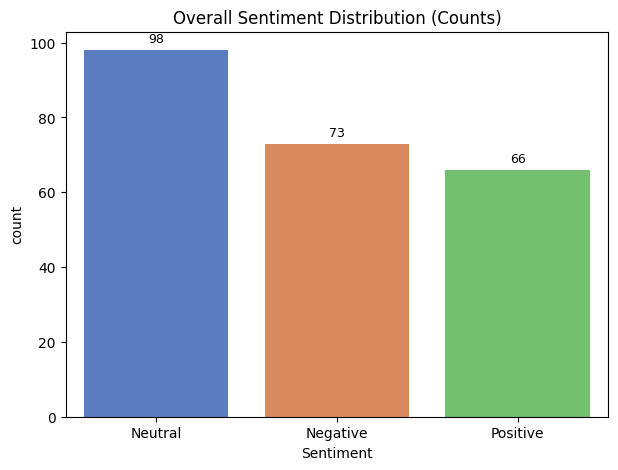

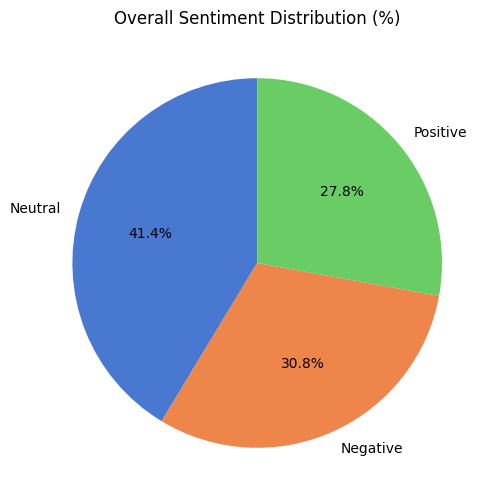

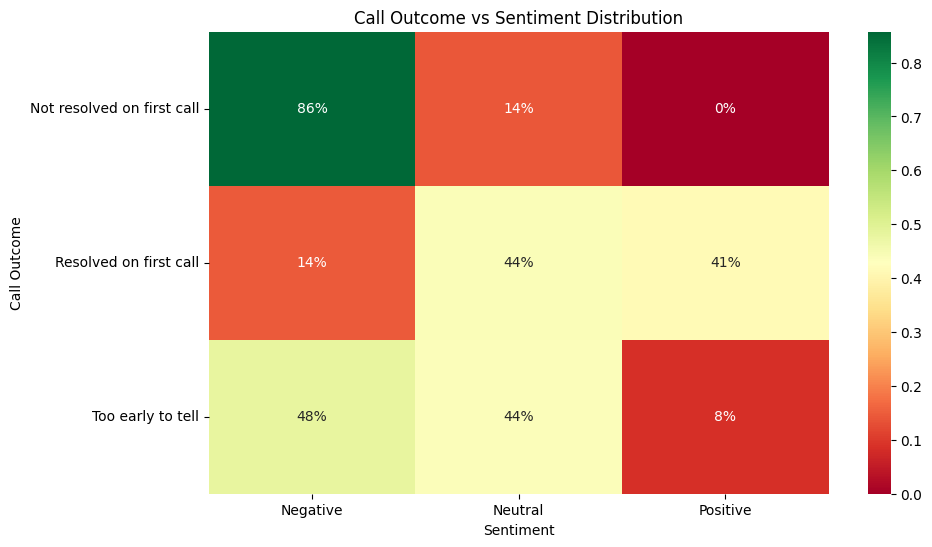

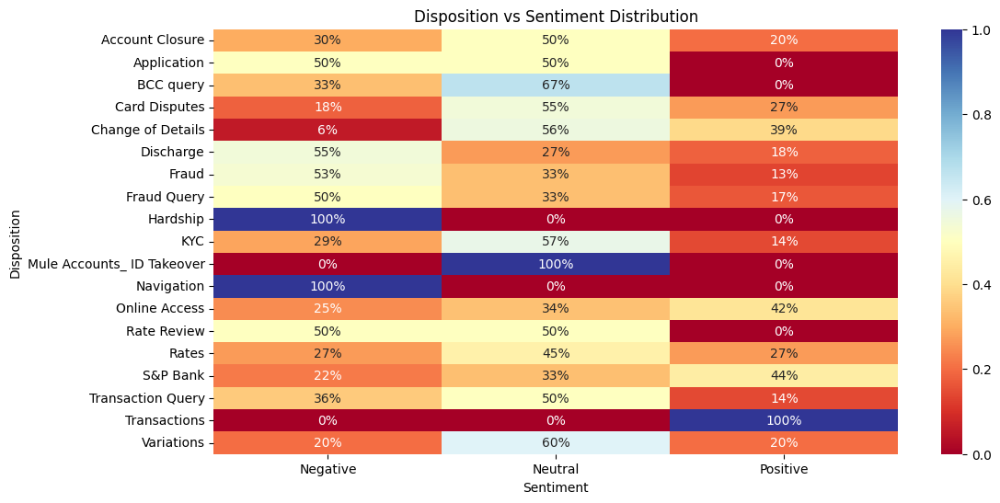

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ==============================
# 1. Load dataset
# ==============================
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# ==============================
# 2. Data Cleaning
# ==============================
# Complaint flag ensure numeric 0/1
if "Complaint_detected" in df.columns:
    df["Complaint_Flag"] = df["Complaint_detected"].astype(str).str.lower().map({"true":1, "false":0})
else:
    df["Complaint_Flag"] = 0

# Quality Score numeric
df["Quality Score"] = pd.to_numeric(df["Quality Score"], errors="coerce")

# Availability %
if "Available Time" in df.columns and "Login Time" in df.columns:
    df["Availability_Pct"] = (df["Available Time"].fillna(0) / df["Login Time"].replace(0, pd.NA)) * 100
else:
    df["Availability_Pct"] = 0

# Utilization % = (Talk + ACW + Hold) / Login × 100
if all(col in df.columns for col in ["Talk Time", "ACW Time", "Hold Time", "Login Time"]):
    df["Utilization_Pct"] = (df["Talk Time"] + df["ACW Time"] + df["Hold Time"]) / df["Login Time"].replace(0, pd.NA) * 100
else:
    df["Utilization_Pct"] = 0

# ==============================
# Helper functions for labels
# ==============================
def add_labels(ax, fmt="{:.0f}"):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(fmt.format(value),
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

def add_labels_percent(ax):
    for p in ax.patches:
        value = p.get_height()
        if pd.notnull(value):
            ax.annotate(f"{value:.1f}%",
                        (p.get_x() + p.get_width() / 2., value),
                        ha='center', va='bottom', fontsize=9, color='black', xytext=(0,3),
                        textcoords='offset points')

# ==============================
# 3. Sentiment Analysis
# ==============================
# Bar chart of counts
plt.figure(figsize=(7,5))
ax = sns.countplot(x="Sentiment", data=df, palette="muted", order=df["Sentiment"].value_counts().index)
plt.title("Overall Sentiment Distribution (Counts)")
add_labels(ax, fmt="{:.0f}")
plt.show()

# Pie chart of percentages
sentiment_counts = df["Sentiment"].value_counts()
sentiment_pct = sentiment_counts / sentiment_counts.sum() * 100

plt.figure(figsize=(6,6))
plt.pie(sentiment_pct, labels=sentiment_pct.index, autopct="%1.1f%%", startangle=90, colors=sns.color_palette("muted"))
plt.title("Overall Sentiment Distribution (%)")
plt.show()

# Heatmaps already included
outcome_sentiment = pd.crosstab(df["Call Outcome"], df["Sentiment"], normalize="index")
plt.figure(figsize=(10,6))
sns.heatmap(outcome_sentiment, annot=True, cmap="RdYlGn", fmt=".0%")
plt.title("Call Outcome vs Sentiment Distribution")
plt.show()

disposition_sentiment = pd.crosstab(df["Disposition"], df["Sentiment"], normalize="index")
plt.figure(figsize=(12,6))
sns.heatmap(disposition_sentiment, annot=True, cmap="RdYlBu", fmt=".0%")
plt.title("Disposition vs Sentiment Distribution")
plt.show()


In [1]:
# Sentiment-related keywords
sentiment_keywords = {
    "positive": [
        "thank", "thanks", "helpful", "resolved", "appreciate", "supportive",
        "good", "excellent", "satisfied", "happy", "quick", "glad", "pleasure",
        "amazing", "understand", "well done", "fast", "recommend", "polite", "great"
    ],
    "negative": [
        "angry", "frustrated", "delay", "problem", "useless", "bad service",
        "complaint", "not working", "disappointed", "slow", "issue", "worst",
        "pain", "hate", "negative", "trouble", "unhappy", "waited", "escalate", "dissatisfied"
    ],
    "neutral": [
        "okay", "alright", "noted", "fine", "average", "normal",
        "understood", "inform", "update", "status", "proceed", "record",
        "not sure", "check", "working", "noted down", "informing", "general", "standard", "routine"
    ]
}

# Behavior-related keywords
behavior_keywords = {
    "polite": [
        "please", "thank you", "sir", "madam", "kindly", "appreciate", "excuse me",
        "sorry", "understand", "respect", "greetings", "welcome", "glad", "smile",
        "patience", "helpful", "courteous", "cooperative", "friendly", "support"
    ],
    "impolite": [
        "shut up", "nonsense", "useless", "stupid", "bad service", "idiot", "lazy",
        "not helping", "angry", "hate", "worst", "irresponsible", "careless", "delay",
        "rude", "unprofessional", "complain", "shouting", "waste", "problem"
    ],
    "process": [
        "transfer", "hold", "verification", "escalate", "approval", "check", "update",
        "process", "confirm", "authentication", "login", "otp", "pin", "id", "account",
        "call back", "forward", "follow up", "system", "form"
    ]
}

# Emotion-related keywords
emotion_keywords = {
    "anger": [
        "angry", "frustrated", "irritated", "annoyed", "rude", "mad", "hate",
        "furious", "shouting", "complaint", "waste", "stupid", "nonsense", "not working",
        "delay", "worst", "disappointed", "problem", "upset", "negative"
    ],
    "joy": [
        "happy", "glad", "satisfied", "pleasure", "smile", "grateful", "thankful",
        "cheerful", "amazing", "excited", "wonderful", "excellent", "delighted", "enjoyed",
        "positive", "appreciate", "great", "well done", "recommend", "supportive"
    ],
    "sadness": [
        "disappointed", "sad", "unhappy", "upset", "depressed", "cry", "lost", "pain",
        "hopeless", "negative", "trouble", "failure", "low", "tired", "poor", "sorry",
        "bad", "worst", "decline", "reject"
    ],
    "trust": [
        "trust", "confidence", "secure", "safe", "reliable", "dependable", "support",
        "believe", "faith", "commitment", "loyal", "care", "helpful", "guide", "understand",
        "solution", "policy", "agree", "assure", "confirm"
    ]
}

# Call performance / agent quality keywords
performance_keywords = {
    "quality": [
        "quality", "evaluation", "flag", "complaint", "verification", "id", "document",
        "approval", "record", "policy", "procedure", "script", "audit", "monitor",
        "training", "compliance", "guideline", "review", "score", "feedback"
    ],
    "efficiency": [
        "hold", "delay", "wait", "slow", "transfer", "escalate", "process", "resolve",
        "quick", "fast", "immediate", "callback", "follow up", "time", "busy", "queue",
        "overdue", "stuck", "pending", "complete"
    ]
}


In [2]:
import pandas as pd
import re
from collections import Counter

# Load your preprocessed dataset
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# Function to count keyword occurrences in a transcript
def count_keywords(text, keyword_dict):
    if pd.isna(text):
        return {k: 0 for cat in keyword_dict.values() for k in cat}
    text = text.lower()
    counts = {}
    for category, keywords in keyword_dict.items():
        for word in keywords:
            counts[f"{category}_{word}"] = len(re.findall(rf"\b{re.escape(word)}\b", text))
    return counts

# Apply sentiment, behavior, emotion, and performance keyword counts
sentiment_counts = df["Transcript"].apply(lambda x: count_keywords(str(x), sentiment_keywords))
behavior_counts = df["Transcript"].apply(lambda x: count_keywords(str(x), behavior_keywords))
emotion_counts = df["Transcript"].apply(lambda x: count_keywords(str(x), emotion_keywords))
performance_counts = df["Transcript"].apply(lambda x: count_keywords(str(x), performance_keywords))

# Merge counts into dataframe
df_sentiment = pd.DataFrame(list(sentiment_counts))
df_behavior = pd.DataFrame(list(behavior_counts))
df_emotion = pd.DataFrame(list(emotion_counts))
df_performance = pd.DataFrame(list(performance_counts))

df_final = pd.concat([df, df_sentiment, df_behavior, df_emotion, df_performance], axis=1)

# Aggregate KPIs per Agent
agent_kpis = df_final.groupby("Agent Name").sum()

# Example KPIs
agent_kpis["Total_Positive_Words"] = agent_kpis.filter(like="positive_").sum(axis=1)
agent_kpis["Total_Negative_Words"] = agent_kpis.filter(like="negative_").sum(axis=1)
agent_kpis["Polite_Words"] = agent_kpis.filter(like="polite_").sum(axis=1)
agent_kpis["Impolite_Words"] = agent_kpis.filter(like="impolite_").sum(axis=1)
agent_kpis["Anger_Words"] = agent_kpis.filter(like="anger_").sum(axis=1)
agent_kpis["Joy_Words"] = agent_kpis.filter(like="joy_").sum(axis=1)
agent_kpis["Efficiency_Issues"] = agent_kpis.filter(like="efficiency_").sum(axis=1)

# Save the enriched file
df_final.to_csv("transcript_keyword_analysis.csv", index=False)
agent_kpis.to_csv("agent_transcript_kpis.csv")


<Figure size 1200x600 with 0 Axes>

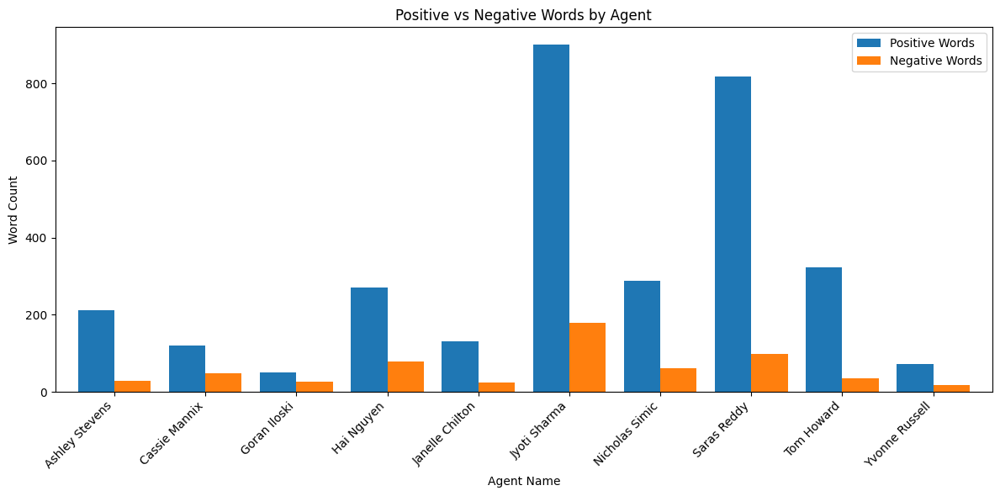

/tmp/ipython-input-4039125801.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agent_kpis, x="Agent Name", y="Politeness_Index", palette="Blues_d")


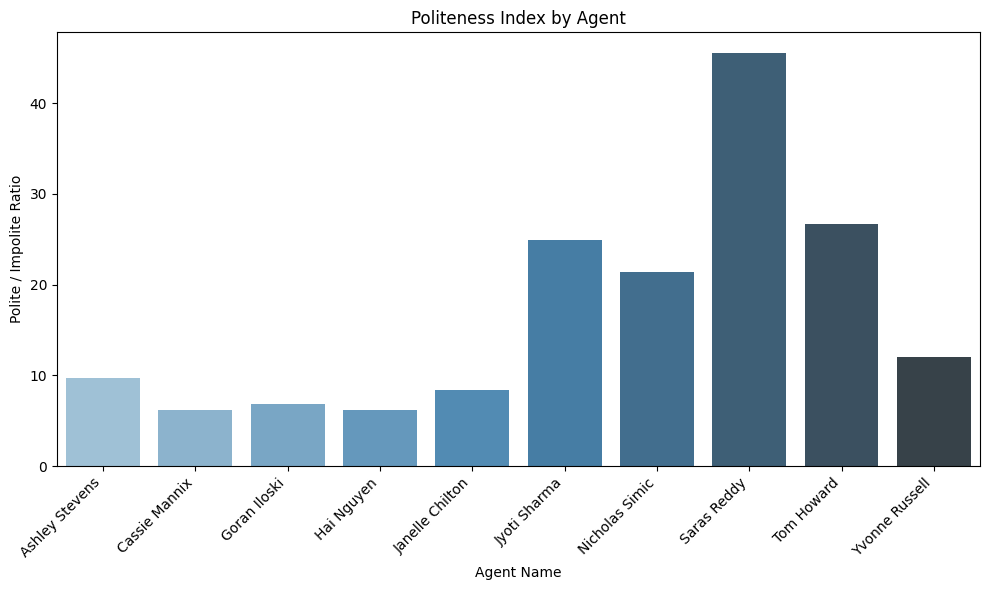

<Figure size 1200x600 with 0 Axes>

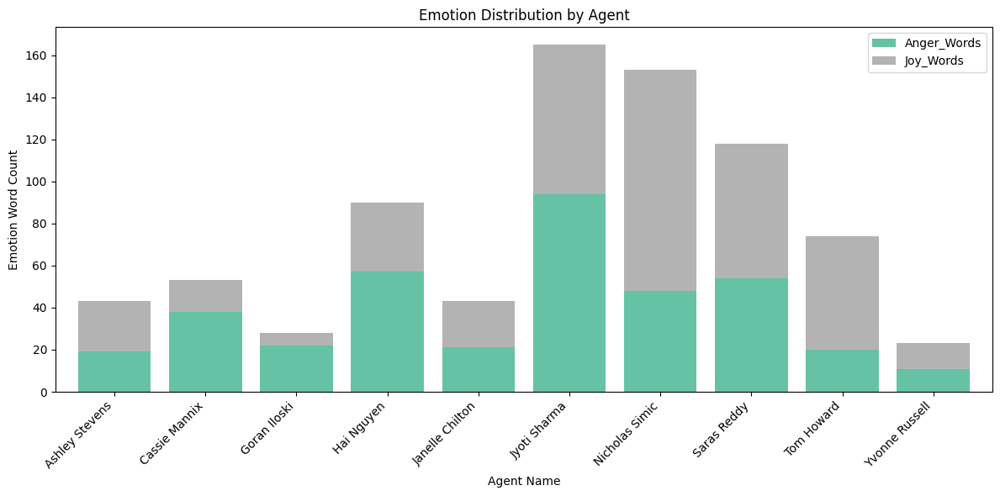

/tmp/ipython-input-4039125801.py:46: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agent_kpis, x="Agent Name", y="Efficiency_Issues", palette="Reds_d")


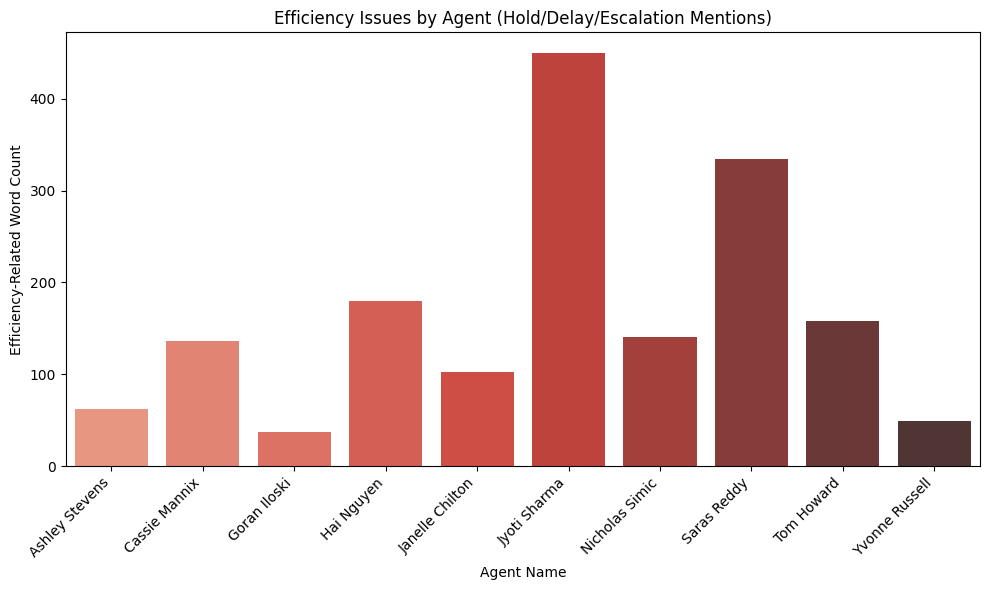

ValueError: could not convert string to float: '2025-08-01 06:26:36.3547012792025-08-01 06:46:40.5675412952025-08-01 06:51:25.5970309102025-08-04 23:07:55.1791952142025-08-05 04:57:12.2196652872025-08-05 05:06:37.2539232372025-08-05 05:11:45.3555210392025-08-05 05:29:06.1997767442025-08-05 05:36:02.7214632692025-08-05 05:53:39.2115642602025-08-05 06:18:54.3549189132025-08-06 00:14:37.2421821752025-08-06 00:21:33.5905430942025-08-06 00:39:34.5979830612025-08-06 00:58:30.8254281542025-08-06 01:52:45.7406207212025-08-06 02:30:26.3206922452025-08-06 02:46:55.8550183092025-08-06 03:13:11.4193311942025-08-07 00:12:25.8134077722025-08-07 07:03:07.551449933'

<Figure size 800x600 with 0 Axes>

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the agent-level KPIs from previous script
agent_kpis = pd.read_csv("agent_transcript_kpis.csv")

# ----- 1. Positive vs Negative Words per Agent -----
plt.figure(figsize=(12,6))
agent_kpis[["Agent Name","Total_Positive_Words","Total_Negative_Words"]].set_index("Agent Name").plot(
    kind="bar", figsize=(12,6), width=0.8)
plt.title("Positive vs Negative Words by Agent")
plt.ylabel("Word Count")
plt.xlabel("Agent Name")
plt.xticks(rotation=45, ha="right")
plt.legend(["Positive Words","Negative Words"])
plt.tight_layout()
plt.show()

# ----- 2. Politeness Index (Polite / Impolite) -----
agent_kpis["Politeness_Index"] = agent_kpis["Polite_Words"] / (agent_kpis["Impolite_Words"] + 1)

plt.figure(figsize=(10,6))
sns.barplot(data=agent_kpis, x="Agent Name", y="Politeness_Index", palette="Blues_d")
plt.title("Politeness Index by Agent")
plt.ylabel("Polite / Impolite Ratio")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

# ----- 3. Emotion Distribution (Anger vs Joy vs Sadness vs Trust) -----
emotion_cols = ["Anger_Words", "Joy_Words", "sadness_words", "trust_words"] if "sadness_words" in agent_kpis.columns else ["Anger_Words","Joy_Words"]

plt.figure(figsize=(12,6))
agent_kpis[["Agent Name"] + emotion_cols].set_index("Agent Name").plot(
    kind="bar", stacked=True, figsize=(12,6), width=0.8, colormap="Set2")
plt.title("Emotion Distribution by Agent")
plt.ylabel("Emotion Word Count")
plt.xlabel("Agent Name")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

# ----- 4. Efficiency Issues (Hold/Delay/Escalation Mentions) -----
plt.figure(figsize=(10,6))
sns.barplot(data=agent_kpis, x="Agent Name", y="Efficiency_Issues", palette="Reds_d")
plt.title("Efficiency Issues by Agent (Hold/Delay/Escalation Mentions)")
plt.ylabel("Efficiency-Related Word Count")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

# ----- 5. Heatmap: Correlation Between KPIs -----
plt.figure(figsize=(8,6))
sns.heatmap(agent_kpis.drop(columns=["Agent Name"]).corr(), annot=True, cmap="RdYlGn", fmt=".2f")
plt.title("Correlation Heatmap of Transcript KPIs")
plt.tight_layout()
plt.show()


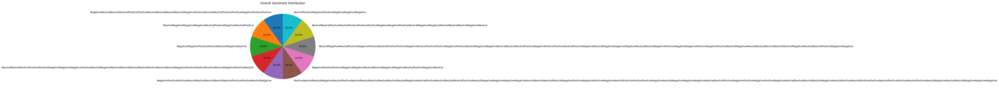

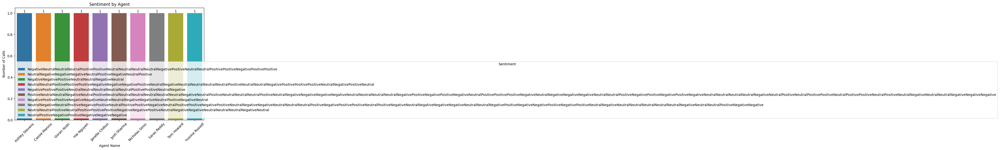

/tmp/ipython-input-2503565524.py:37: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=agent_kpis, x="Agent Name", y="QualityScore", ci=None, palette="Blues_d")


ValueError: Could not interpret value `QualityScore` for `y`. An entry with this name does not appear in `data`.

<Figure size 1000x600 with 0 Axes>

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

# ----- 1. Sentiment Distribution -----
plt.figure(figsize=(6,6))
sentiment_counts = agent_kpis["Sentiment"].value_counts()
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct='%1.1f%%', startangle=90)
plt.title("Overall Sentiment Distribution")
plt.show()

# ----- 2. Sentiment by Agent -----
plt.figure(figsize=(10,6))
sns.countplot(data=agent_kpis, x="Agent Name", hue="Sentiment")
plt.title("Sentiment by Agent")
plt.xlabel("Agent Name")
plt.ylabel("Number of Calls")
plt.xticks(rotation=45)
plt.legend(title="Sentiment")
for c in plt.gca().containers:
    plt.bar_label(c, fmt='%d')   # add numbers on bars
plt.show()

# ----- 3. Call Outcome vs Sentiment -----
plt.figure(figsize=(8,6))
sns.countplot(data=agent_kpis, x="Call Outcome", hue="Sentiment")
plt.title("Call Outcome vs Sentiment")
plt.xlabel("Call Outcome")
plt.ylabel("Number of Calls")
plt.xticks(rotation=45)
plt.legend(title="Sentiment")
for c in plt.gca().containers:
    plt.bar_label(c, fmt='%d')
plt.show()

# ----- 4. Quality Score by Agent -----
plt.figure(figsize=(10,6))
sns.barplot(data=agent_kpis, x="Agent Name", y="QualityScore", ci=None, palette="Blues_d")
plt.title("Average Quality Score by Agent")
plt.xticks(rotation=45)
plt.ylabel("Avg Quality Score")
for c in plt.gca().containers:
    plt.bar_label(c, fmt='%.1f')
plt.show()

# ----- 5. Heatmap: Correlation Between KPIs -----
plt.figure(figsize=(10,6))
numeric_cols = agent_kpis.select_dtypes(include="number")   # only numeric columns
sns.heatmap(numeric_cols.corr(), annot=True, cmap="RdYlGn", fmt=".2f")
plt.title("Correlation Heatmap of Transcript KPIs")
plt.tight_layout()
plt.show()


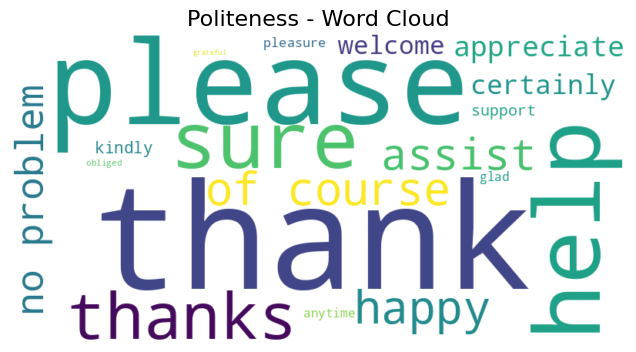

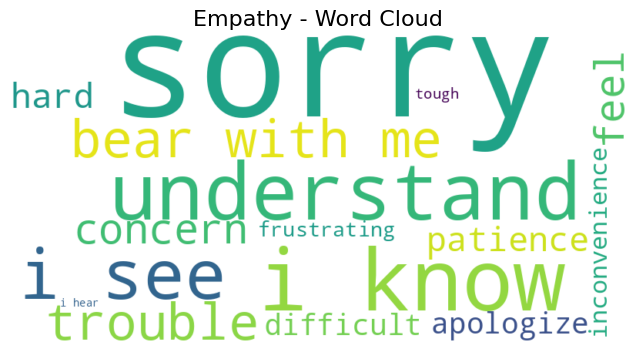

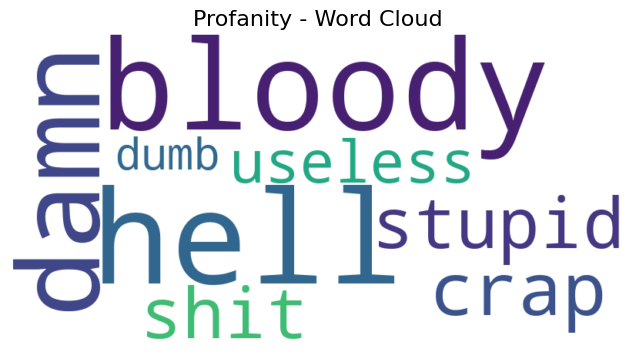

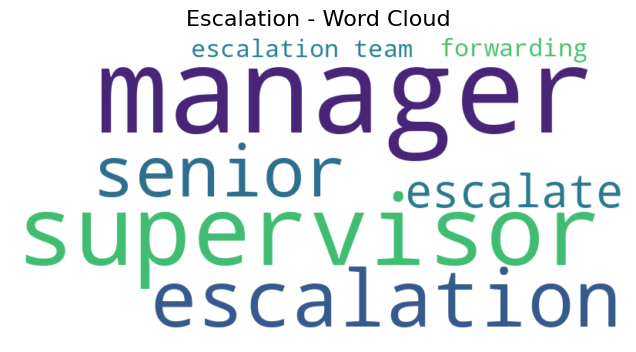

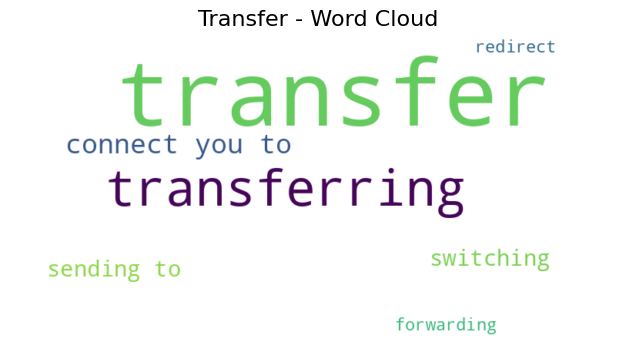

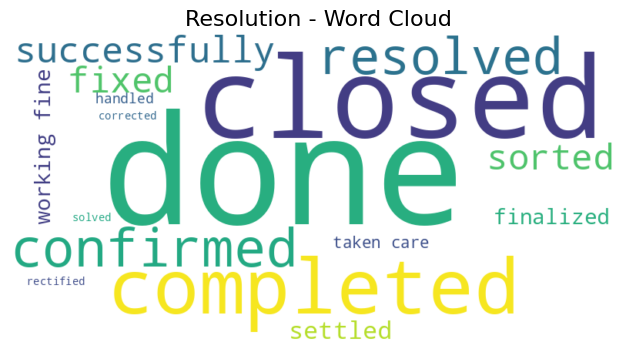

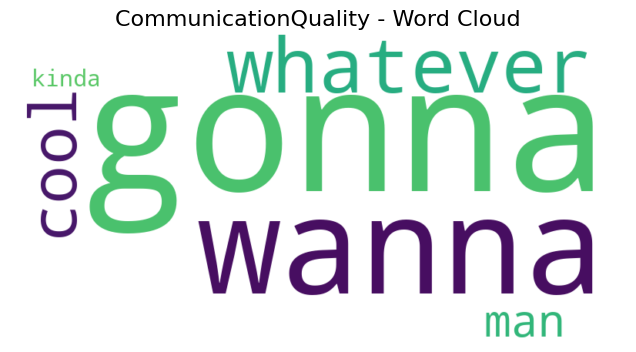

In [9]:
import pandas as pd
import re
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# --- Load Data ---
df = pd.read_csv("/content/final_preprocessed_dataset.csv")
df["Date"] = pd.to_datetime(df["Timestamp"]).dt.date

# --- Lexicons (as before) ---
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly",
                   "certainly","of course","no problem","pleasure","grateful","obliged","anytime","respectfully","thanks","glad"],
    "Empathy": ["sorry","understand","i see","i realize","i know","empathize","apologize","concern","feel","trouble",
                "difficult","tough","hard","frustrating","i hear","i care","patience","bear with me","regret","inconvenience"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","dumb","useless","nonsense","bloody","bastard",
                  "jerk","sucks","shut up","fool","freak","wtf","garbage","moron","piss"],
    "Escalation": ["escalate","escalation","supervisor","manager","team lead","level 2","senior","forwarding","review escalation",
                   "lead escalation","tier 2","transfer to supervisor","call manager","raised ticket","escalation team","raised issue"],
    "Transfer": ["transfer","transferring","connect you to","redirecting","handing over","moving call","switching","redirect","forwarding",
                 "passing call","sending to","connecting to agent","connect department","call routed","line transfer","bridge call","handoff"],
    "Resolution": ["resolved","fixed","done","completed","issue closed","no further action","solved","sorted","corrected","finalized",
                   "taken care","handled","addressed","successfully","closed","rectified","confirmed","working fine","problem solved","settled"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","ain’t","lemme","dunno","buddy","ya","cool","man","bro",
                             "yo","nah","chill","dude","whatever","cuz","tho","bruh"]
}

# --- Helper: Count word frequencies per category ---
def get_word_frequencies(texts, word_list):
    freq = {}
    for text in texts.dropna():
        t = str(text).lower()
        for w in word_list:
            matches = len(re.findall(rf"\b{re.escape(w)}\b", t))
            if matches > 0:
                freq[w] = freq.get(w, 0) + matches
    return freq

# --- Generate Word Clouds for each KPI Category ---
for category, words in lexicons.items():
    freqs = get_word_frequencies(df["Transcript"], words)
    if freqs:
        wc = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(freqs)
        plt.figure(figsize=(8,4))
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"{category} - Word Cloud", fontsize=16)
        plt.show()


In [13]:
import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# --- 1. Load Data ---
df = pd.read_csv("final_preprocessed_dataset.csv")

# Ensure date is in datetime
df["Timestamp"] = pd.to_datetime(df["Timestamp"]).dt.date

# --- 2. Lexicons for KPI Categories ---
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly",
                   "certainly","of course","no problem","pleasure","grateful","obliged","anytime","respectfully","thanks","glad"],
    "Empathy": ["sorry","understand","i see","i realize","i know","empathize","apologize","concern","feel","trouble",
                "difficult","tough","hard","frustrating","i hear","i care","patience","bear with me","regret","inconvenience"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","dumb","useless","nonsense","bloody","bastard",
                  "jerk","sucks","shut up","fool","freak","wtf","garbage","moron","piss"],
    "Escalation": ["escalate","escalation","supervisor","manager","team lead","level 2","senior","forwarding","review escalation",
                   "lead escalation","tier 2","transfer to supervisor","call manager","raised ticket","escalation team","raised issue"],
    "Transfer": ["transfer","transferring","connect you to","redirecting","handing over","moving call","switching","redirect","forwarding",
                 "passing call","sending to","connecting to agent","connect department","call routed","line transfer","bridge call","handoff"],
    "Resolution": ["resolved","fixed","done","completed","issue closed","no further action","solved","sorted","corrected","finalized",
                   "taken care","handled","addressed","successfully","closed","rectified","confirmed","working fine","problem solved","settled"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","ain’t","lemme","dunno","buddy","ya","cool","man","bro",
                             "yo","nah","chill","dude","whatever","cuz","tho","bruh"]
}

# --- 3. Helper Functions ---
def contains_any(text, word_list):
    text = str(text).lower()
    return any(re.search(rf"\b{re.escape(w)}\b", text) for w in word_list)

def count_any(text, word_list):
    text = str(text).lower()
    return sum(len(re.findall(rf"\b{re.escape(w)}\b", text)) for w in word_list)

def get_word_frequencies(texts, word_list):
    freq = {}
    for text in texts.dropna():
        t = str(text).lower()
        for w in word_list:
            matches = len(re.findall(rf"\b{re.escape(w)}\b", t))
            if matches > 0:
                freq[w] = freq.get(w, 0) + matches
    return freq

# --- 4. Apply KPI Measures ---
df["PoliteCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Politeness"]))
df["EmpathyCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Empathy"]))
df["ProfanityCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Profanity"]))
df["Escalated"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Escalation"]))
df["Transferred"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Transfer"]))
df["Resolution"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Resolution"]))
df["JargonCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["CommunicationQuality"]))

# --- 5. Aggregate Daily KPI Scores ---
summary = df.groupby("Timestamp").agg(
    TotalCalls=("Transcript","count"),
    PolitenessRate=("PoliteCount","mean"),
    EmpathyRate=("EmpathyCount","mean"),
    ProfanityRate=("ProfanityCount","mean"),
    EscalationRate=("Escalated","mean"),
    TransferRate=("Transferred","mean"),
    FCRRate=("Resolution","mean"),
    CommunicationQuality=("JargonCount","mean")
).reset_index()

# Convert to percentages
for col in ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate"]:
    summary[col] = (summary[col]*100).round(2)

summary["CommunicationQuality"] = (100 - summary["CommunicationQuality"]).round(2)

print(summary)

# --- 6. Visualizations ---
sns.set(style="whitegrid")

# 6.1 Trend Lines for Daily KPIs
kpi_cols = ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate","CommunicationQuality"]
for col in kpi_cols:
    plt.figure(figsize=(8,5))
    sns.lineplot(data=summary, x="date", y=col, marker="o")
    plt.title(f"{col} Trend Over Time")
    plt.ylabel("Percentage %")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# 6.2 Word Clouds for Each Category
for category, words in lexicons.items():
    freqs = get_word_frequencies(df["Transcript"], words)
    if freqs:
        wc = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(freqs)
        plt.figure(figsize=(8,4))
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"{category} - Word Cloud", fontsize=16)
        plt.show()


    Timestamp  TotalCalls  PolitenessRate  EmpathyRate  ProfanityRate  \
0  2025-08-01          72         1713.58       434.57          24.69   
1  2025-08-02           8         1509.09       500.00           0.00   
2  2025-08-03          29         1503.23       254.84           3.23   
3  2025-08-04          13         1285.71       464.29          35.71   
4  2025-08-05          42         1490.70       362.79          27.91   
5  2025-08-06          39         1567.39       319.57           0.00   
6  2025-08-07          35         2207.32       526.83          21.95   

   EscalationRate  TransferRate  FCRRate  CommunicationQuality  
0           17.28         45.68    49.38                 97.89  
1            0.00         18.18    72.73                 92.45  
2            6.45         32.26    67.74                 98.48  
3           21.43         71.43    50.00                 96.86  
4           13.95         37.21    67.44                 98.02  
5           15.22        

ValueError: Could not interpret value `date` for `x`. An entry with this name does not appear in `data`.

<Figure size 800x500 with 0 Axes>

    Timestamp  TotalCalls  PolitenessRate  EmpathyRate  ProfanityRate  \
0  2025-08-01          72         1713.58       434.57          24.69   
1  2025-08-02           8         1509.09       500.00           0.00   
2  2025-08-03          29         1503.23       254.84           3.23   
3  2025-08-04          13         1285.71       464.29          35.71   
4  2025-08-05          42         1490.70       362.79          27.91   

   EscalationRate  TransferRate  FCRRate  CommunicationQuality  
0           17.28         45.68    49.38                 97.89  
1            0.00         18.18    72.73                 92.45  
2            6.45         32.26    67.74                 98.48  
3           21.43         71.43    50.00                 96.86  
4           13.95         37.21    67.44                 98.02  


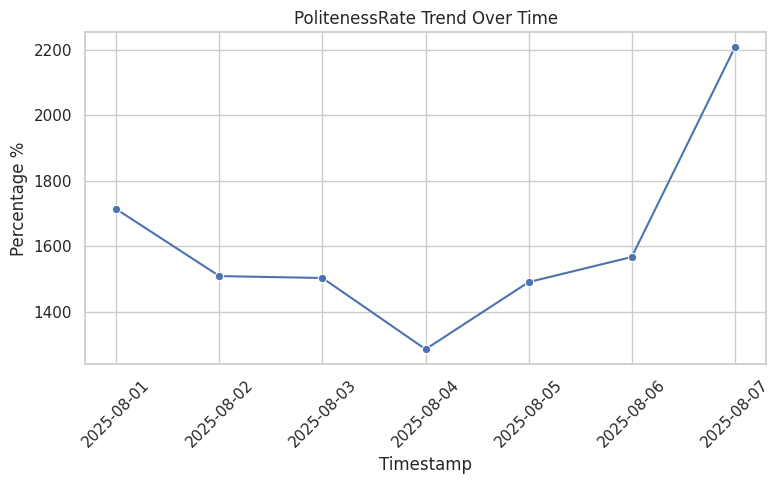

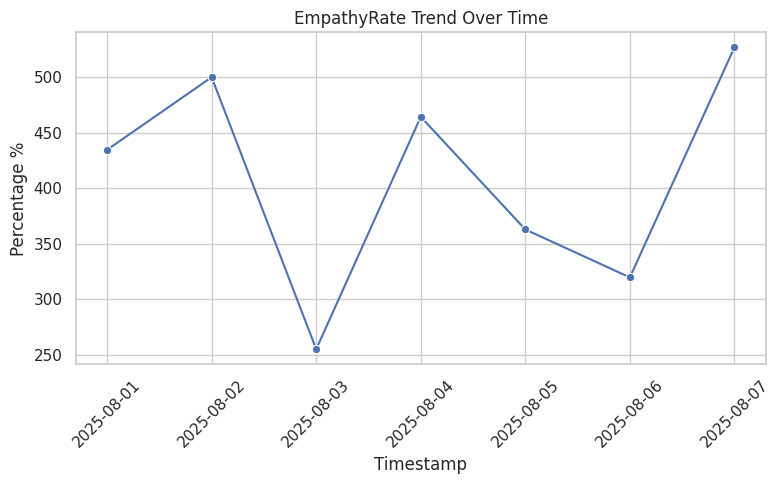

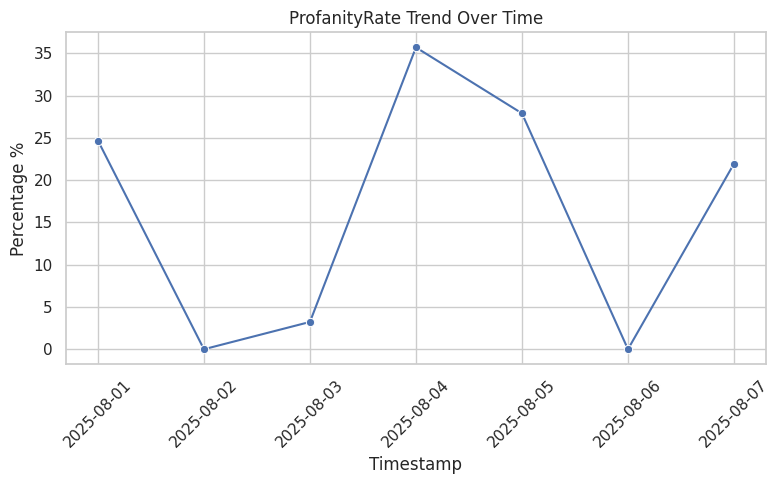

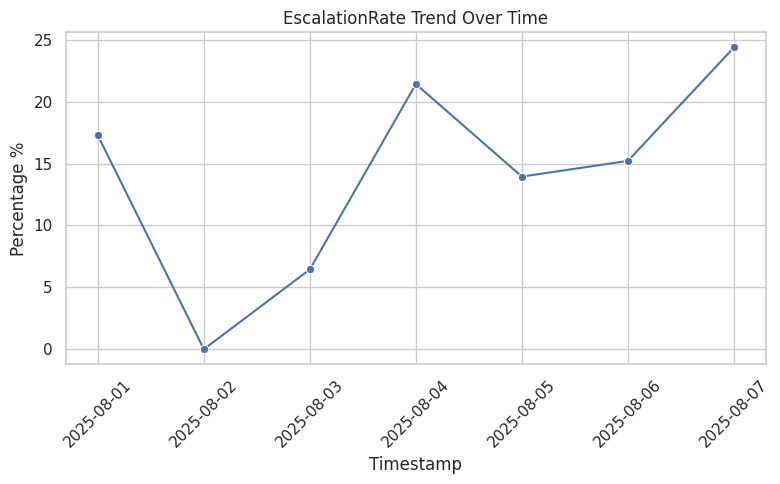

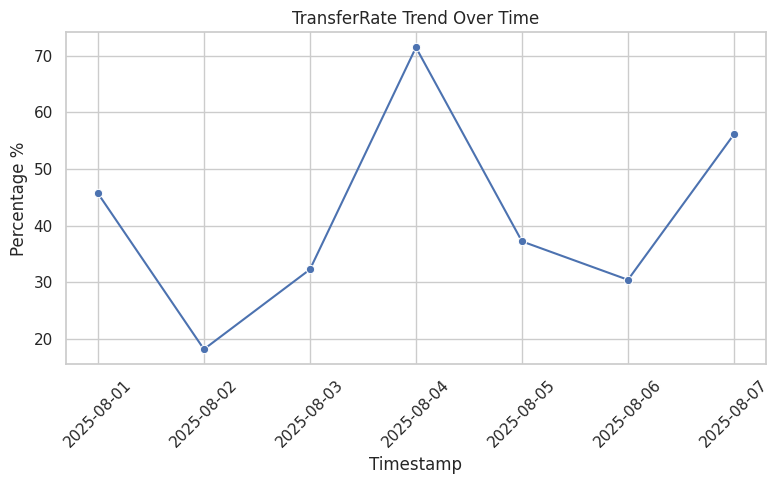

...

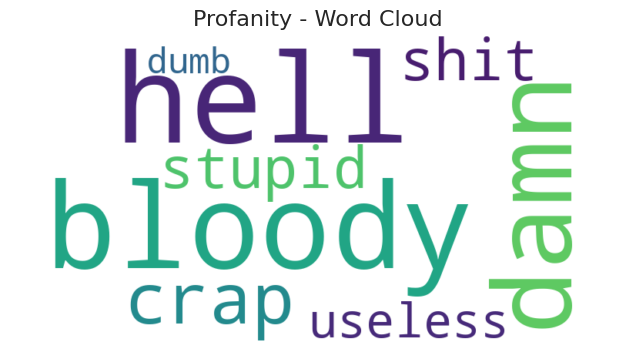

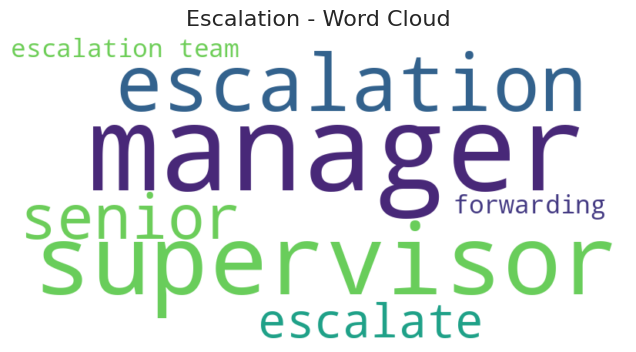

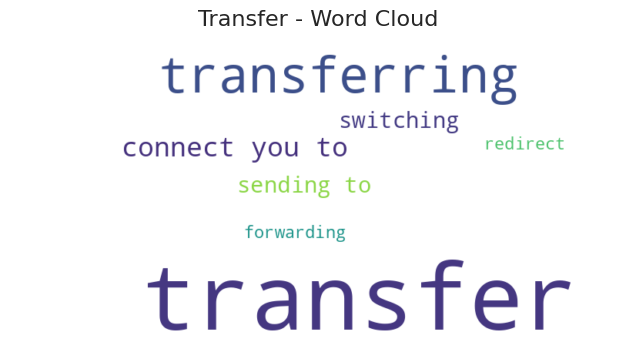

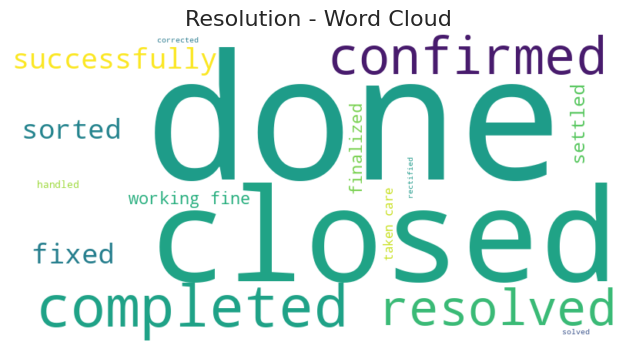

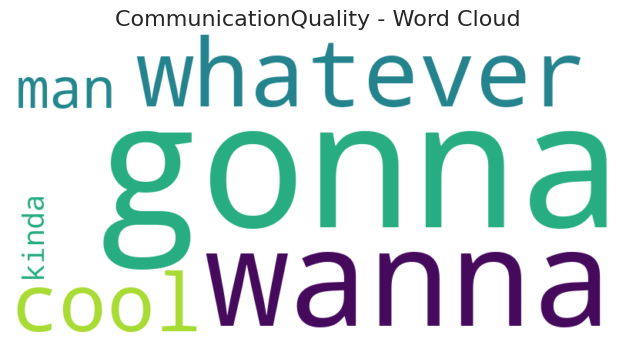

In [14]:
import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# --- 1. Load Data ---
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# Ensure timestamp is datetime
df["Timestamp"] = pd.to_datetime(df["Timestamp"]).dt.date

# --- 2. Lexicons ---
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly",
                   "certainly","of course","no problem","pleasure","grateful","obliged","anytime","respectfully","thanks","glad"],
    "Empathy": ["sorry","understand","i see","i realize","i know","empathize","apologize","concern","feel","trouble",
                "difficult","tough","hard","frustrating","i hear","i care","patience","bear with me","regret","inconvenience"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","dumb","useless","nonsense","bloody","bastard",
                  "jerk","sucks","shut up","fool","freak","wtf","garbage","moron","piss"],
    "Escalation": ["escalate","escalation","supervisor","manager","team lead","level 2","senior","forwarding","review escalation",
                   "lead escalation","tier 2","transfer to supervisor","call manager","raised ticket","escalation team","raised issue"],
    "Transfer": ["transfer","transferring","connect you to","redirecting","handing over","moving call","switching","redirect","forwarding",
                 "passing call","sending to","connecting to agent","connect department","call routed","line transfer","bridge call","handoff"],
    "Resolution": ["resolved","fixed","done","completed","issue closed","no further action","solved","sorted","corrected","finalized",
                   "taken care","handled","addressed","successfully","closed","rectified","confirmed","working fine","problem solved","settled"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","ain’t","lemme","dunno","buddy","ya","cool","man","bro",
                             "yo","nah","chill","dude","whatever","cuz","tho","bruh"]
}

# --- 3. Helper Functions ---
def contains_any(text, word_list):
    text = str(text).lower()
    return any(re.search(rf"\b{re.escape(w)}\b", text) for w in word_list)

def count_any(text, word_list):
    text = str(text).lower()
    return sum(len(re.findall(rf"\b{re.escape(w)}\b", text)) for w in word_list)

def get_word_frequencies(texts, word_list):
    freq = {}
    for text in texts.dropna():
        t = str(text).lower()
        for w in word_list:
            matches = len(re.findall(rf"\b{re.escape(w)}\b", t))
            if matches > 0:
                freq[w] = freq.get(w, 0) + matches
    return freq

# --- 4. Apply KPI Measures ---
df["PoliteCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Politeness"]))
df["EmpathyCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Empathy"]))
df["ProfanityCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Profanity"]))
df["Escalated"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Escalation"]))
df["Transferred"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Transfer"]))
df["Resolution"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Resolution"]))
df["JargonCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["CommunicationQuality"]))

# --- 5. Aggregate Daily KPI Scores ---
summary = df.groupby("Timestamp").agg(
    TotalCalls=("Transcript","count"),
    PolitenessRate=("PoliteCount","mean"),
    EmpathyRate=("EmpathyCount","mean"),
    ProfanityRate=("ProfanityCount","mean"),
    EscalationRate=("Escalated","mean"),
    TransferRate=("Transferred","mean"),
    FCRRate=("Resolution","mean"),
    CommunicationQuality=("JargonCount","mean")
).reset_index()

# Convert to percentages
for col in ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate"]:
    summary[col] = (summary[col]*100).round(2)

summary["CommunicationQuality"] = (100 - summary["CommunicationQuality"]).round(2)

print(summary.head())

# --- 6. Visualizations ---
sns.set(style="whitegrid")

# 6.1 Trend Lines for Daily KPIs
kpi_cols = ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate","CommunicationQuality"]
for col in kpi_cols:
    plt.figure(figsize=(8,5))
    sns.lineplot(data=summary, x="Timestamp", y=col, marker="o")
    plt.title(f"{col} Trend Over Time")
    plt.ylabel("Percentage %")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# 6.2 Word Clouds for Each Category
for category, words in lexicons.items():
    freqs = get_word_frequencies(df["Transcript"], words)
    if freqs:
        wc = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(freqs)
        plt.figure(figsize=(8,4))
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"{category} - Word Cloud", fontsize=16)
        plt.show()


    Timestamp      Agent Name  TotalCalls  PolitenessRate  EmpathyRate  \
0  2025-08-01  Ashley Stevens           3         2033.33       566.67   
1  2025-08-01   Cassie Mannix           5         2100.00       780.00   
2  2025-08-01    Jyoti Sharma          22          964.00       184.00   
3  2025-08-01  Nicholas Simic          13         3721.43       764.29   
4  2025-08-01     Saras Reddy          15         1600.00       318.75   

   ProfanityRate  EscalationRate  TransferRate  FCRRate  CommunicationQuality  
0           0.00           33.33         66.67   100.00                 95.33  
1         240.00           40.00         40.00    80.00                 94.60  
2           4.00            4.00         44.00    28.00                 98.84  
3          14.29           28.57         42.86    78.57                 96.86  
4          18.75            6.25         50.00    50.00                 98.94  


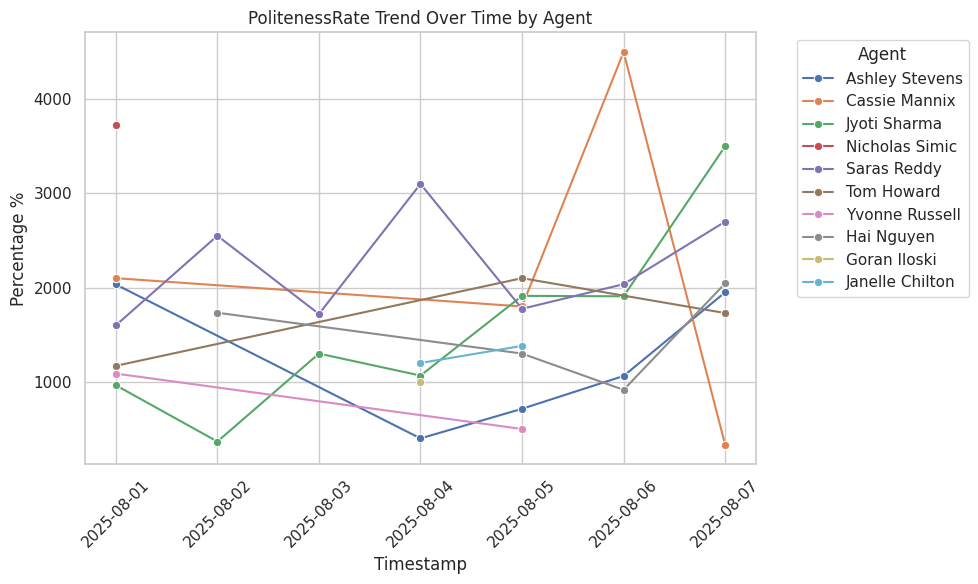

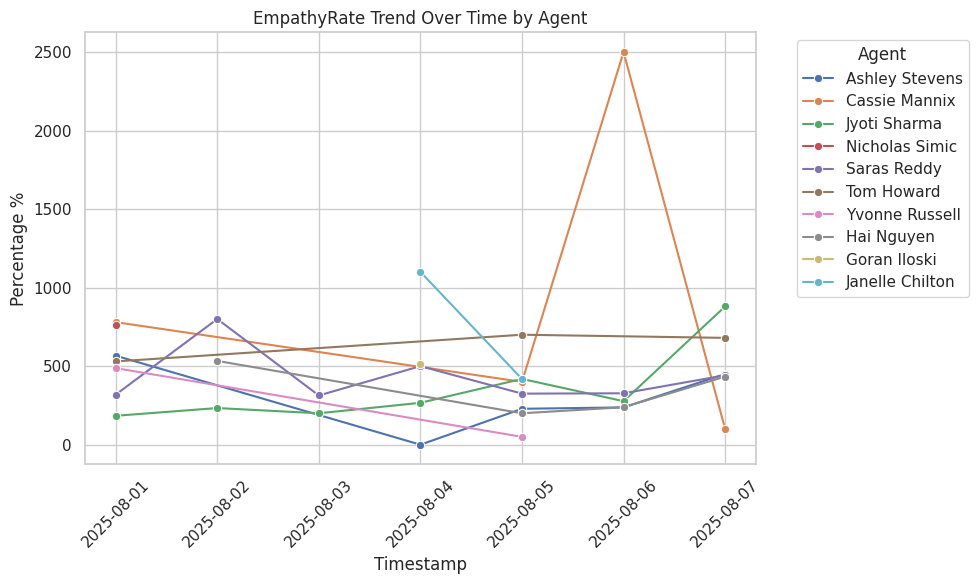

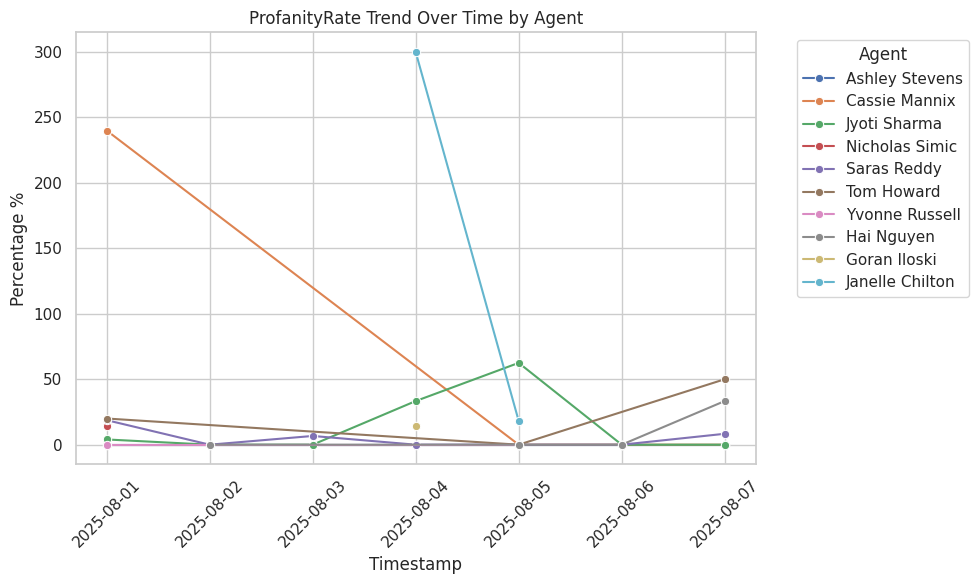

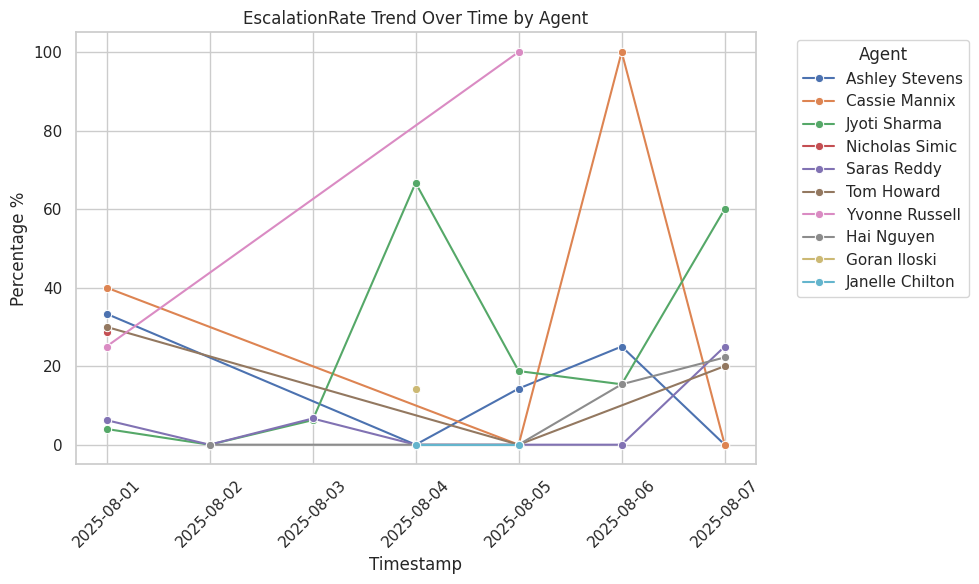

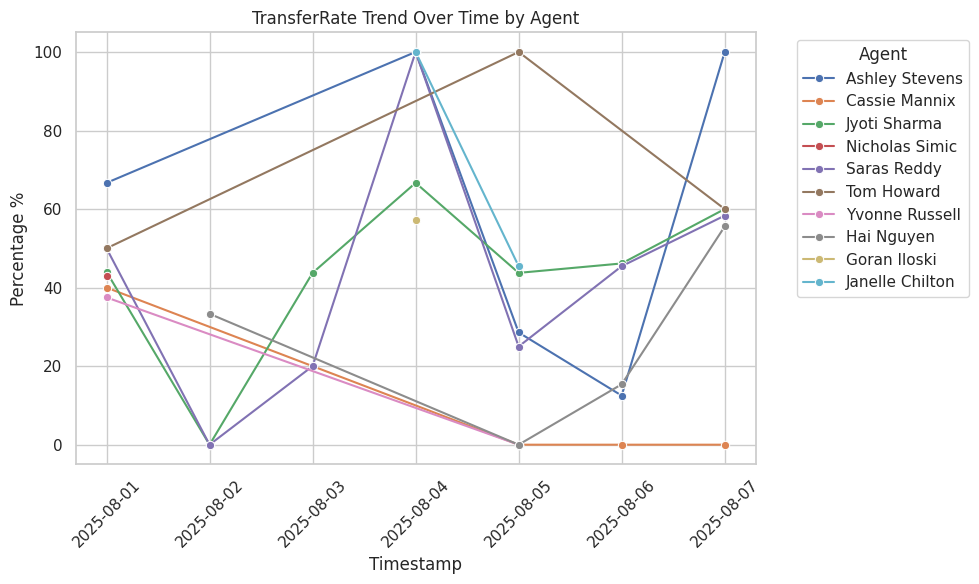

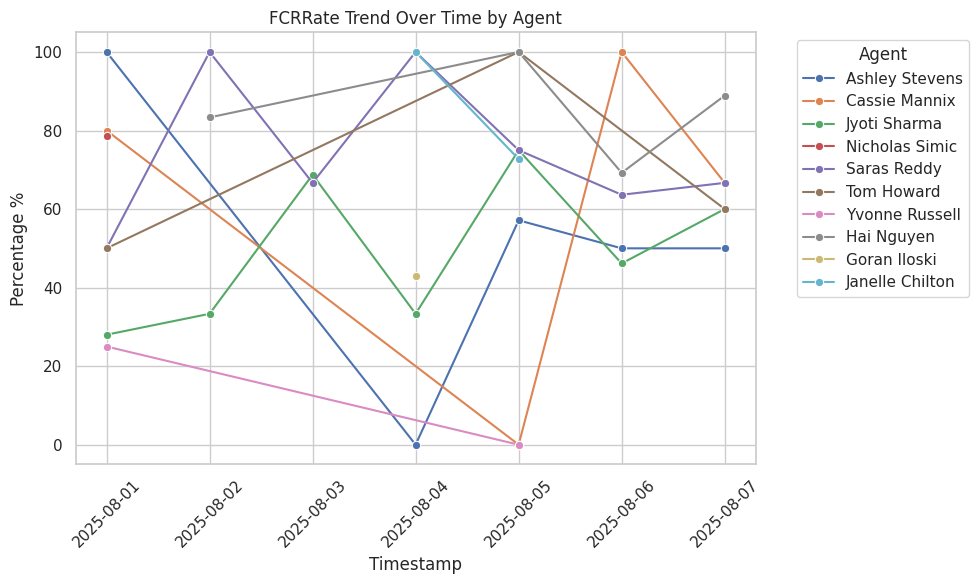

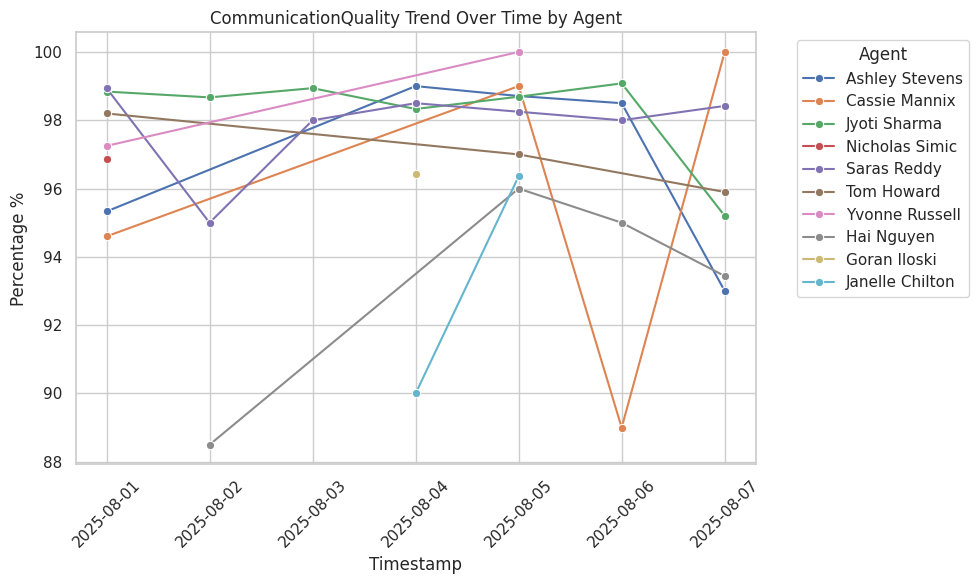

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


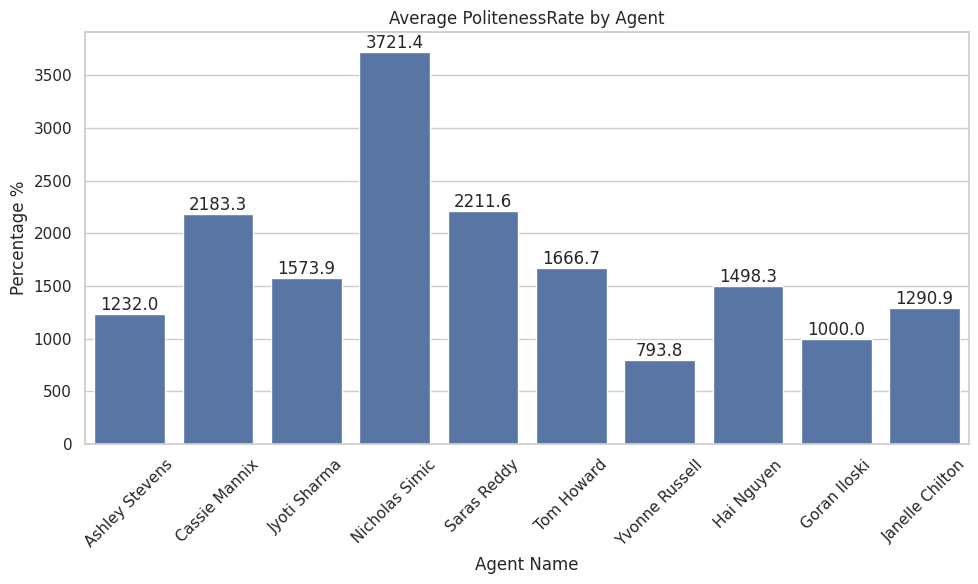

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


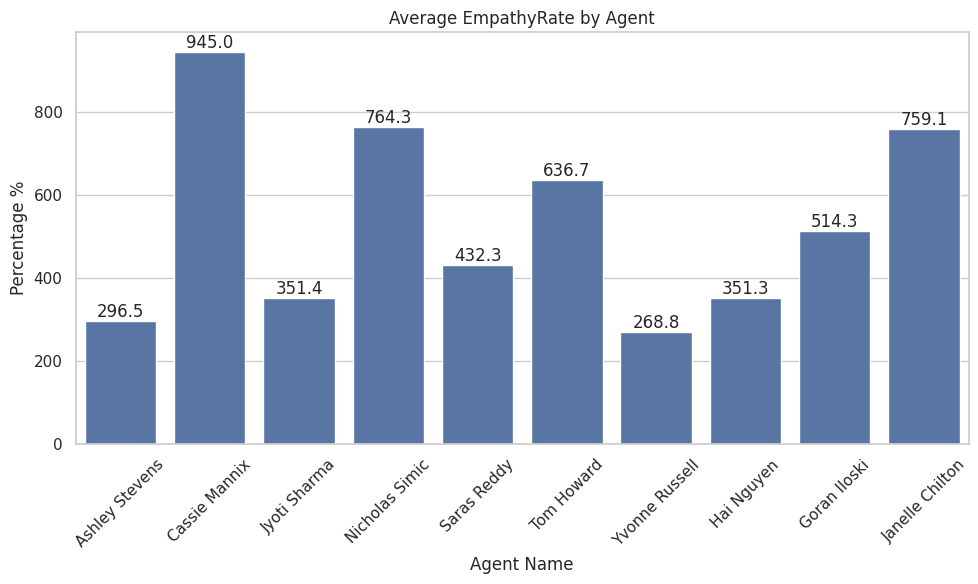

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


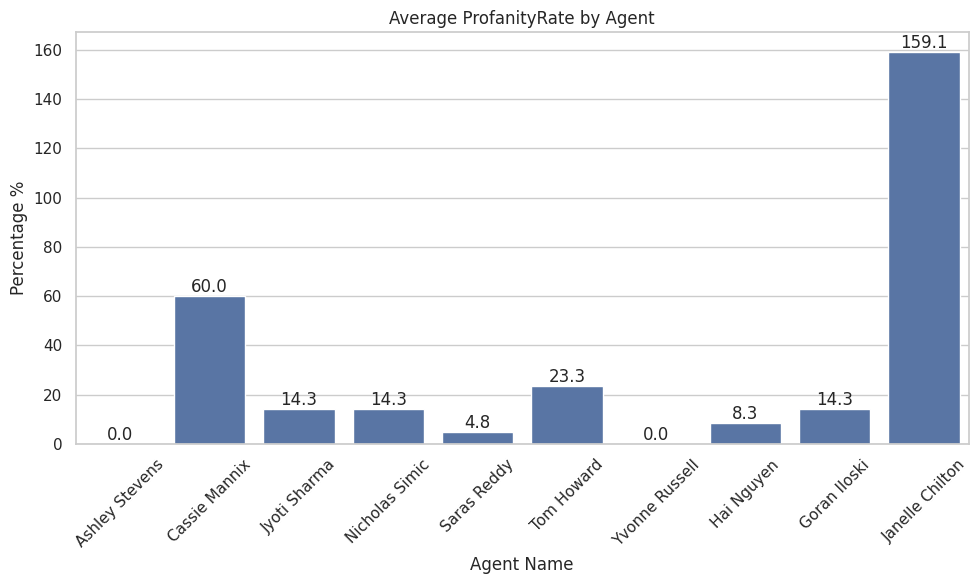

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


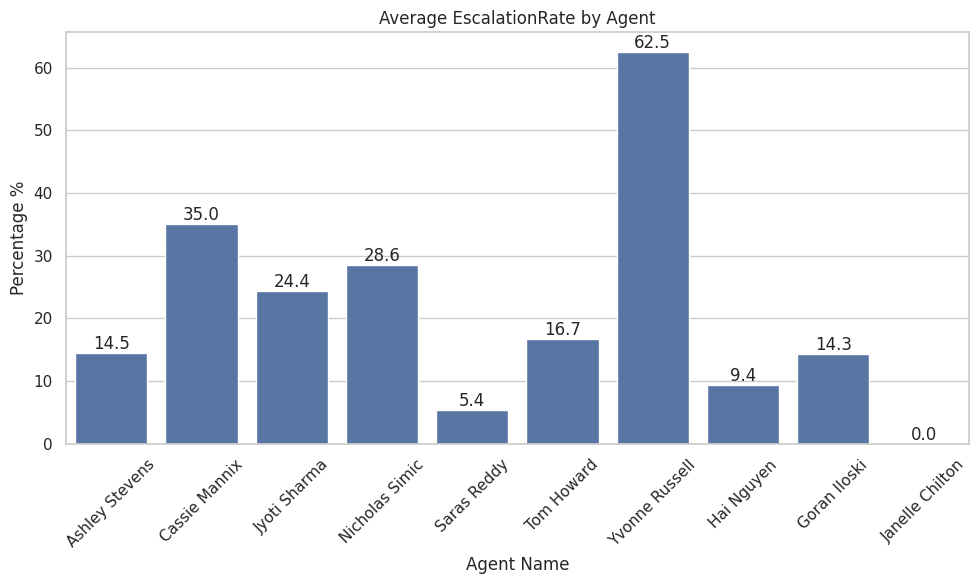

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


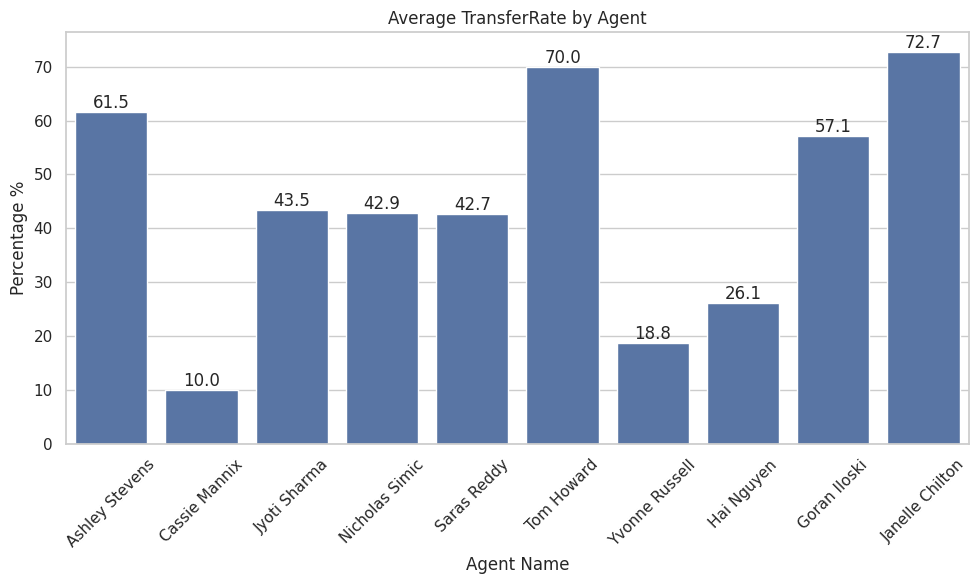

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


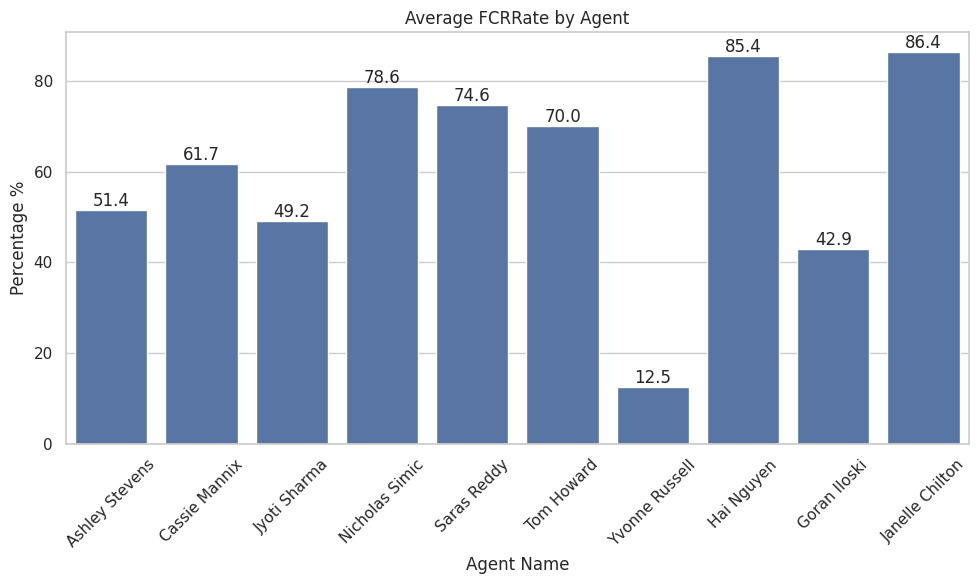

/tmp/ipython-input-2220544314.py:97: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)


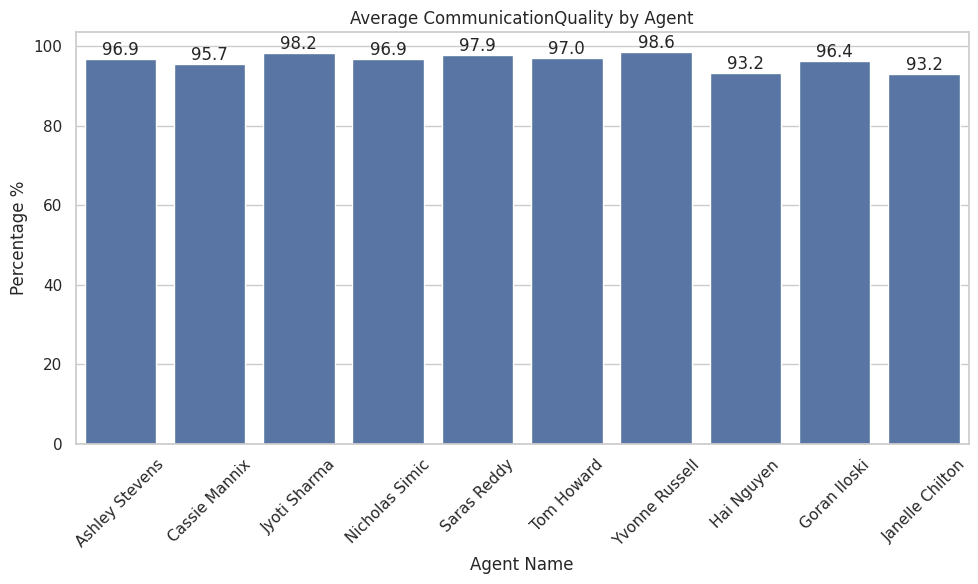

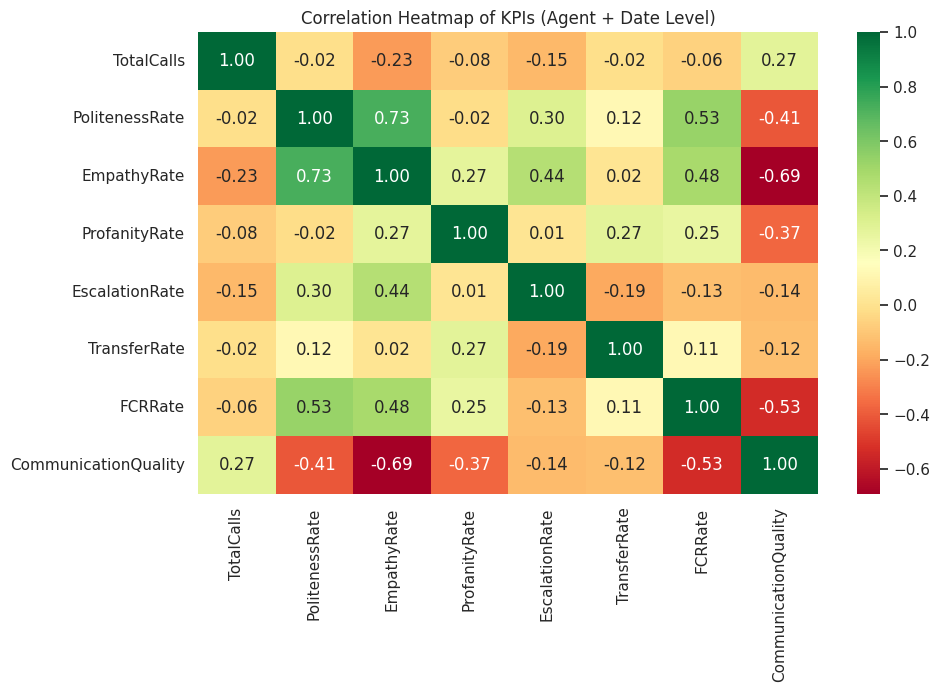

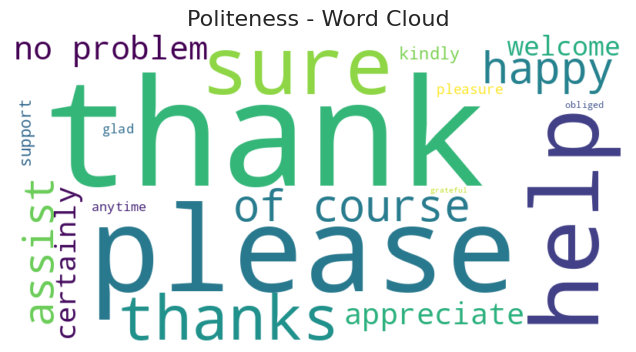

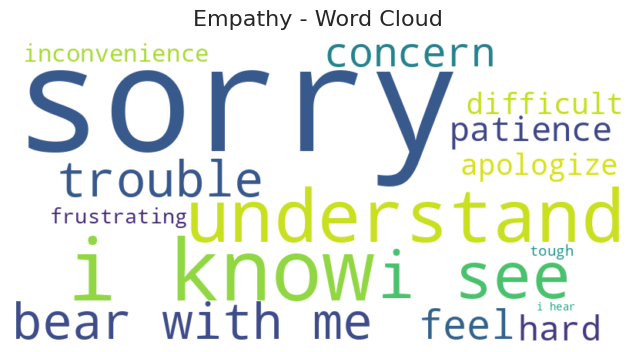

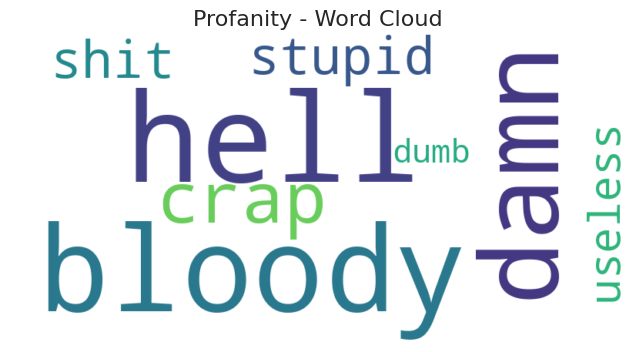

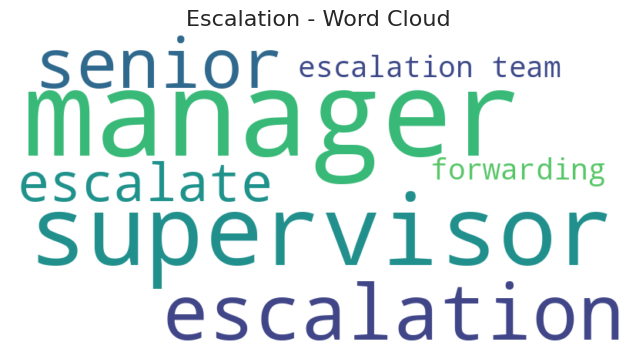

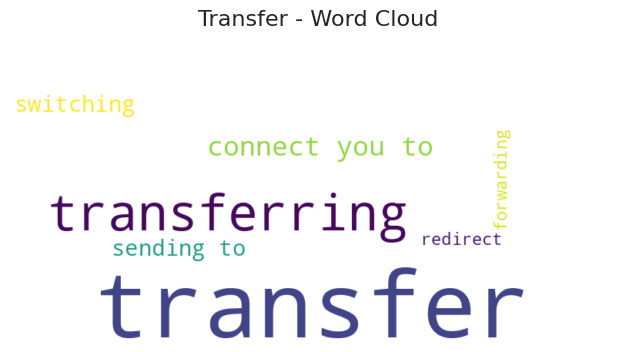

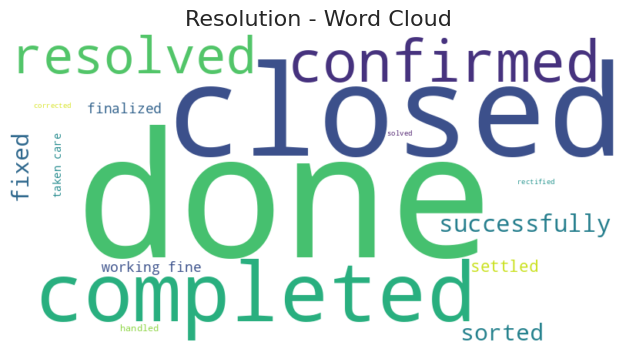

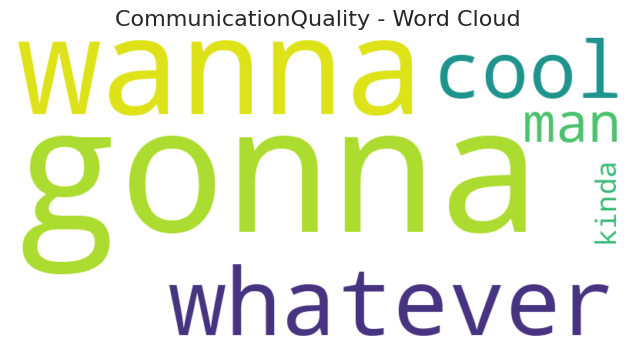

In [15]:
import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# --- 1. Load Data ---
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# Ensure timestamp is datetime
df["Timestamp"] = pd.to_datetime(df["Timestamp"]).dt.date

# --- 2. Lexicons for KPI Categories ---
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly",
                   "certainly","of course","no problem","pleasure","grateful","obliged","anytime","respectfully","thanks","glad"],
    "Empathy": ["sorry","understand","i see","i realize","i know","empathize","apologize","concern","feel","trouble",
                "difficult","tough","hard","frustrating","i hear","i care","patience","bear with me","regret","inconvenience"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","dumb","useless","nonsense","bloody","bastard",
                  "jerk","sucks","shut up","fool","freak","wtf","garbage","moron","piss"],
    "Escalation": ["escalate","escalation","supervisor","manager","team lead","level 2","senior","forwarding","review escalation",
                   "lead escalation","tier 2","transfer to supervisor","call manager","raised ticket","escalation team","raised issue"],
    "Transfer": ["transfer","transferring","connect you to","redirecting","handing over","moving call","switching","redirect","forwarding",
                 "passing call","sending to","connecting to agent","connect department","call routed","line transfer","bridge call","handoff"],
    "Resolution": ["resolved","fixed","done","completed","issue closed","no further action","solved","sorted","corrected","finalized",
                   "taken care","handled","addressed","successfully","closed","rectified","confirmed","working fine","problem solved","settled"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","ain’t","lemme","dunno","buddy","ya","cool","man","bro",
                             "yo","nah","chill","dude","whatever","cuz","tho","bruh"]
}

# --- 3. Helper Functions ---
def contains_any(text, word_list):
    text = str(text).lower()
    return any(re.search(rf"\b{re.escape(w)}\b", text) for w in word_list)

def count_any(text, word_list):
    text = str(text).lower()
    return sum(len(re.findall(rf"\b{re.escape(w)}\b", text)) for w in word_list)

def get_word_frequencies(texts, word_list):
    freq = {}
    for text in texts.dropna():
        t = str(text).lower()
        for w in word_list:
            matches = len(re.findall(rf"\b{re.escape(w)}\b", t))
            if matches > 0:
                freq[w] = freq.get(w, 0) + matches
    return freq

# --- 4. Apply KPI Measures ---
df["PoliteCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Politeness"]))
df["EmpathyCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Empathy"]))
df["ProfanityCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Profanity"]))
df["Escalated"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Escalation"]))
df["Transferred"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Transfer"]))
df["Resolution"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Resolution"]))
df["JargonCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["CommunicationQuality"]))

# --- 5. Aggregate KPI Scores (by Date & Agent) ---
summary = df.groupby(["Timestamp","Agent Name"]).agg(
    TotalCalls=("Transcript","count"),
    PolitenessRate=("PoliteCount","mean"),
    EmpathyRate=("EmpathyCount","mean"),
    ProfanityRate=("ProfanityCount","mean"),
    EscalationRate=("Escalated","mean"),
    TransferRate=("Transferred","mean"),
    FCRRate=("Resolution","mean"),
    CommunicationQuality=("JargonCount","mean")
).reset_index()

# Convert to percentages
for col in ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate"]:
    summary[col] = (summary[col]*100).round(2)

summary["CommunicationQuality"] = (100 - summary["CommunicationQuality"]).round(2)

print(summary.head())

# --- 6. Visualizations ---

sns.set(style="whitegrid")

# 6.1 Trend lines per agent
for col in ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate","CommunicationQuality"]:
    plt.figure(figsize=(10,6))
    sns.lineplot(data=summary, x="Timestamp", y=col, hue="Agent Name", marker="o")
    plt.title(f"{col} Trend Over Time by Agent")
    plt.ylabel("Percentage %")
    plt.xticks(rotation=45)
    plt.legend(title="Agent", bbox_to_anchor=(1.05,1), loc="upper left")
    plt.tight_layout()
    plt.show()

# 6.2 Agent vs KPI (bar chart)
for col in ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate","CommunicationQuality"]:
    plt.figure(figsize=(10,6))
    sns.barplot(data=summary, x="Agent Name", y=col, estimator="mean", ci=None)
    plt.title(f"Average {col} by Agent")
    plt.ylabel("Percentage %")
    plt.xticks(rotation=45)
    for c in plt.gca().containers:
        plt.bar_label(c, fmt="%.1f")
    plt.tight_layout()
    plt.show()

# 6.3 Correlation Heatmap (all KPI scores)
plt.figure(figsize=(10,6))
sns.heatmap(summary.drop(columns=["Timestamp","Agent Name"]).corr(), annot=True, cmap="RdYlGn", fmt=".2f")
plt.title("Correlation Heatmap of KPIs (Agent + Date Level)")
plt.show()

# 6.4 Word Clouds per KPI category
for category, words in lexicons.items():
    freqs = get_word_frequencies(df["Transcript"], words)
    if freqs:
        wc = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(freqs)
        plt.figure(figsize=(8,4))
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"{category} - Word Cloud", fontsize=16)
        plt.show()


✅ Final dataset saved as final_agent_kpis.csv


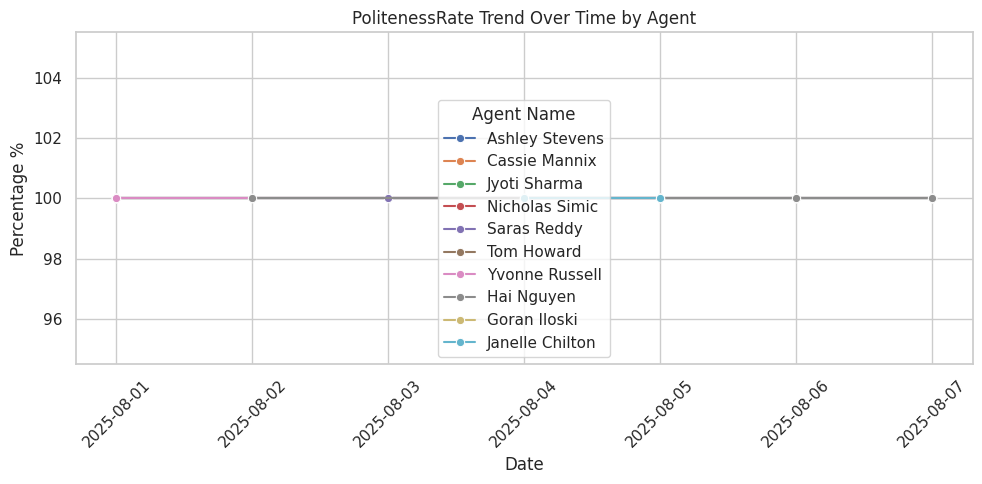

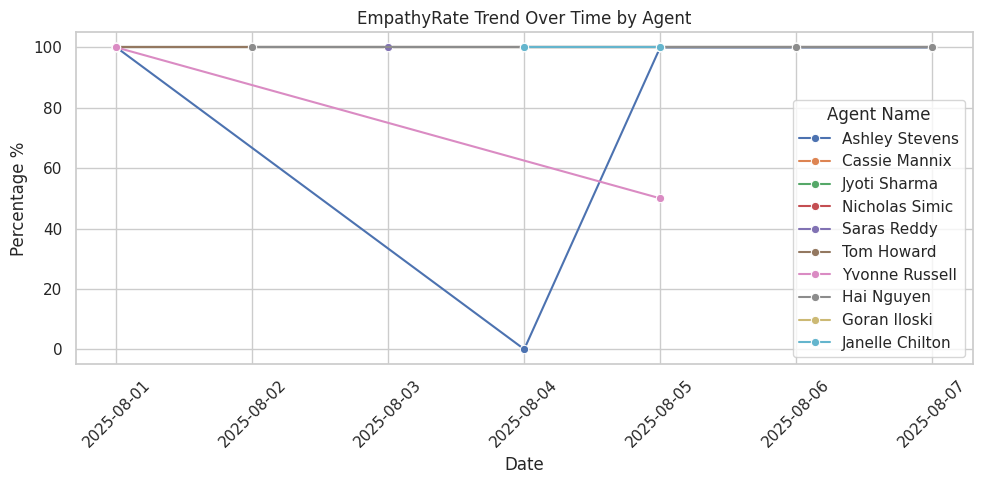

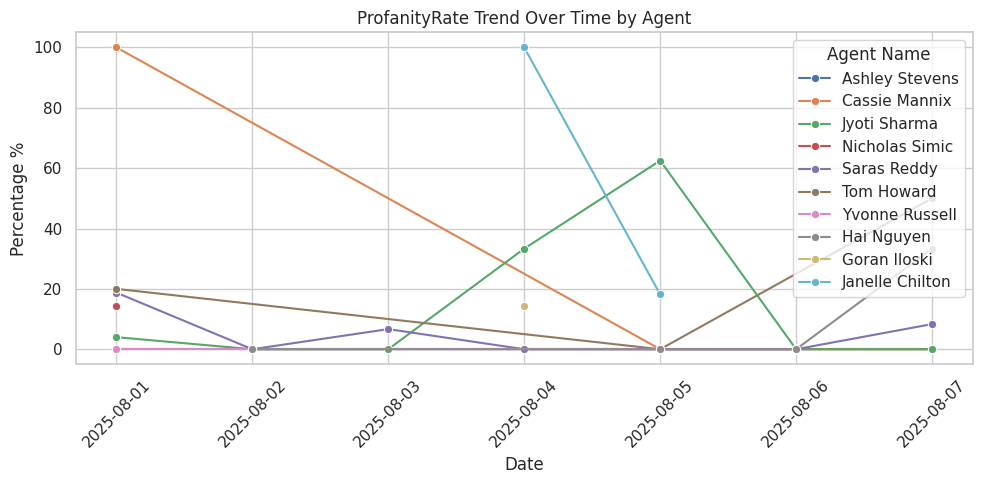

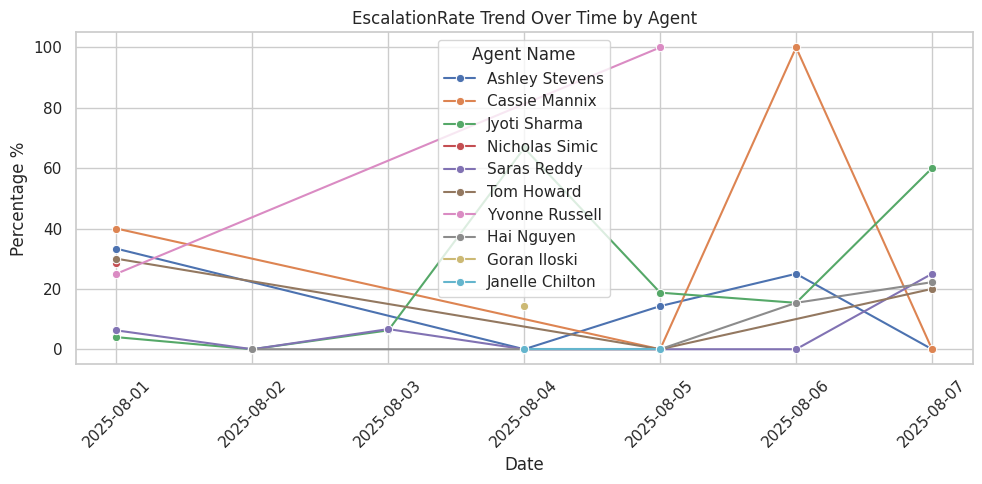

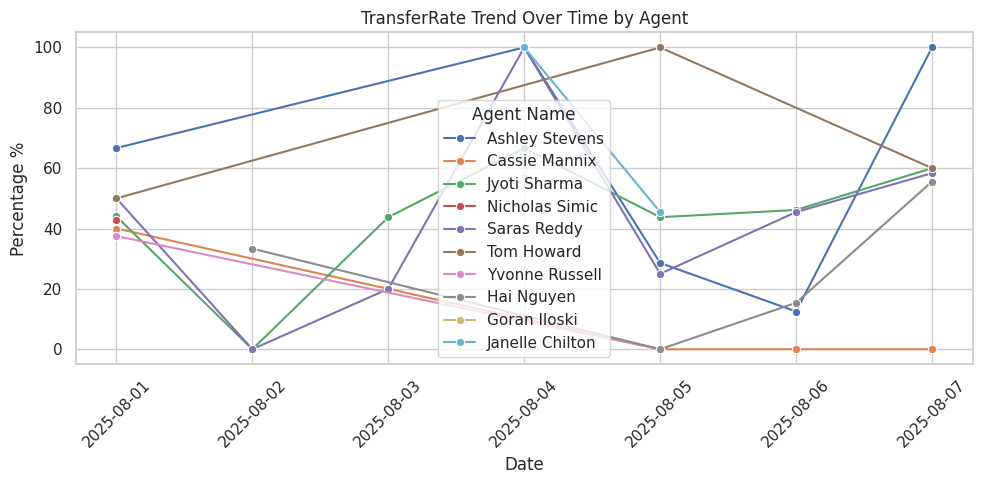

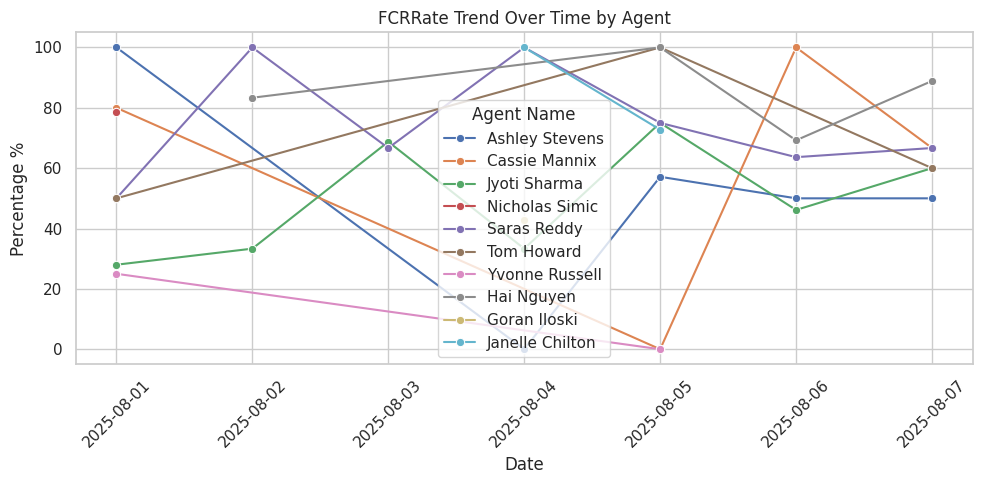

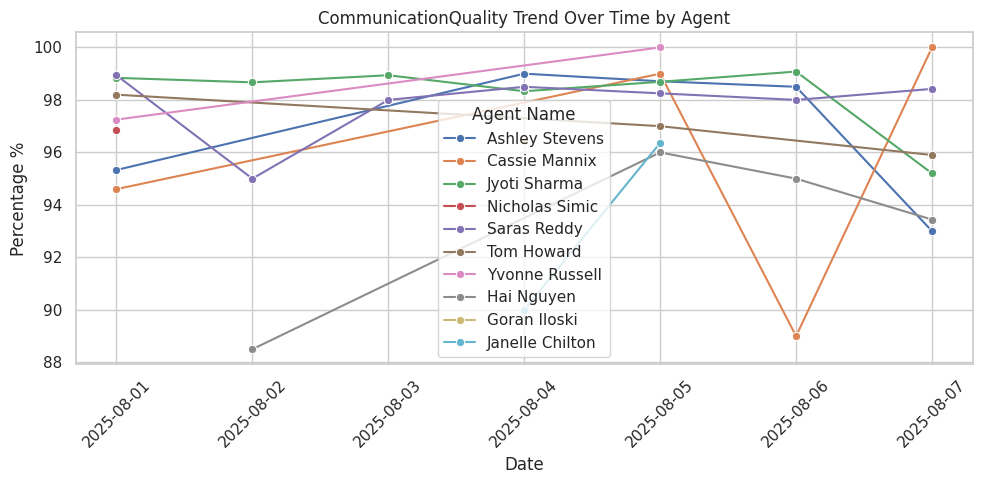

/tmp/ipython-input-2289068388.py:130: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=summary, x="Agent Name", y="PerfScore", ci=None)


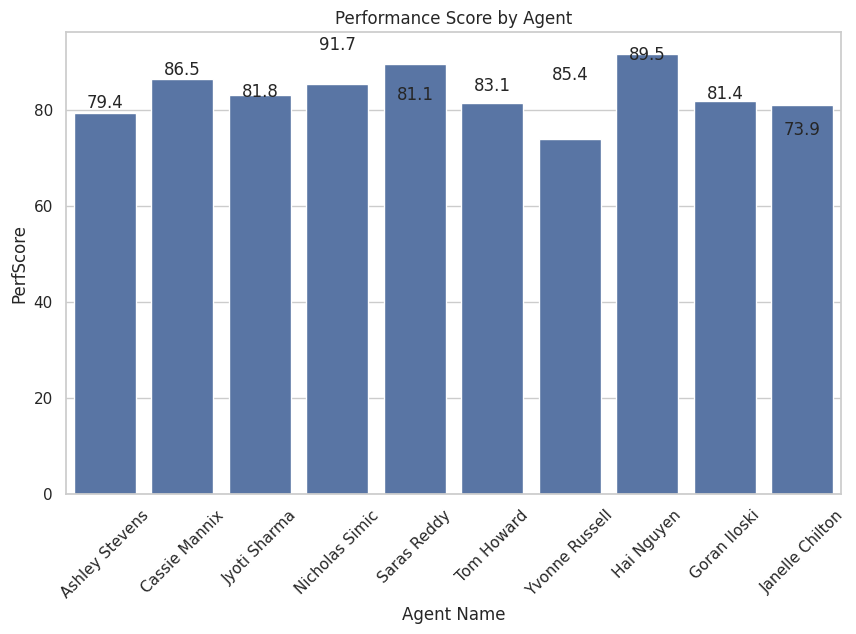

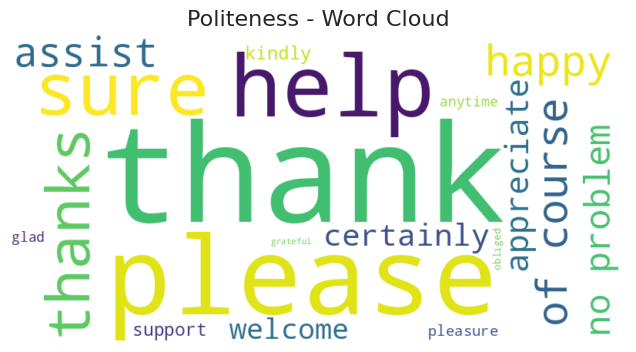

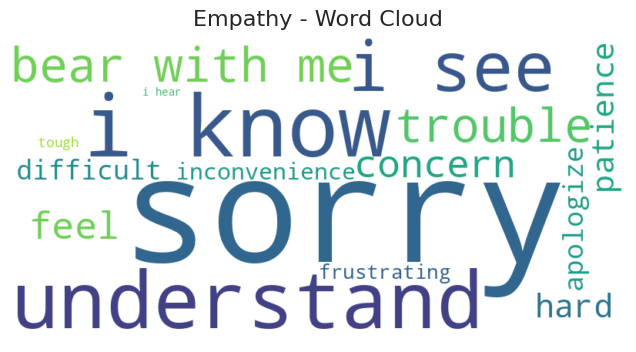

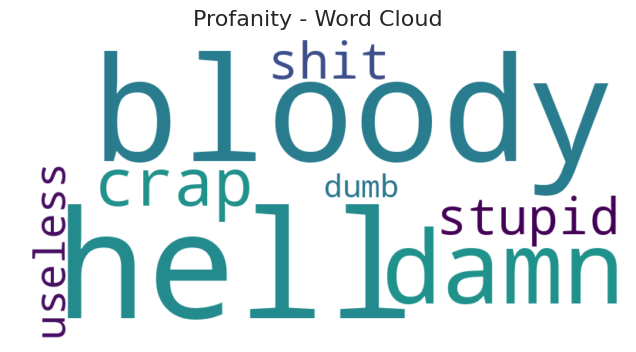

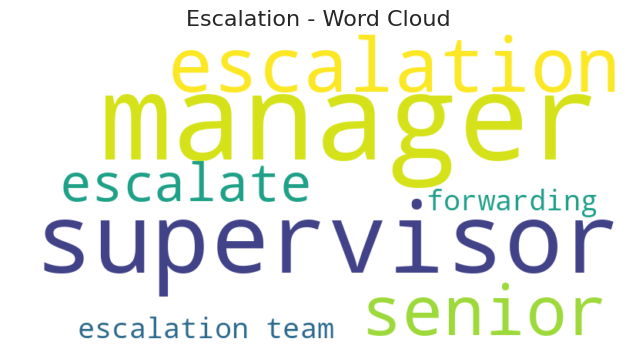

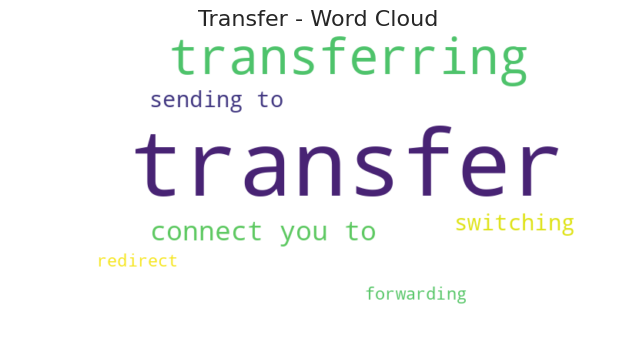

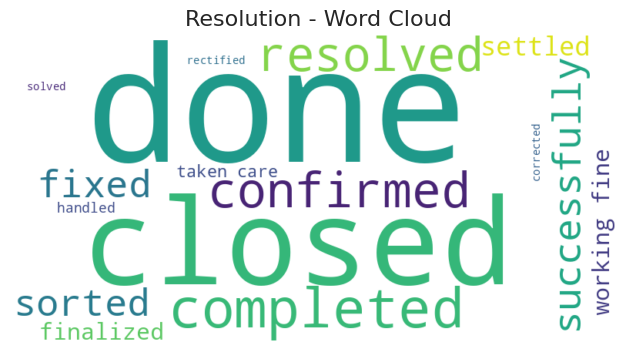

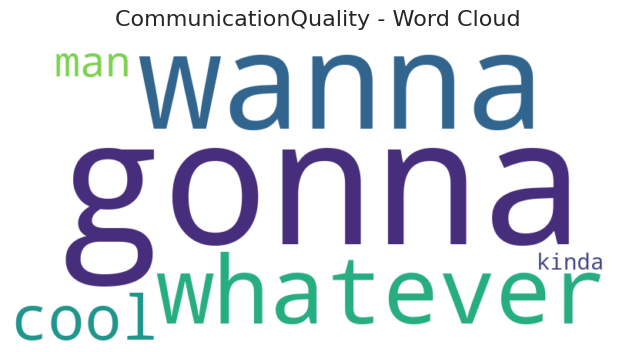

In [17]:
# ================================
# Final Transcript KPI Processing
# ================================

import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# ---------- 1. Load Data ----------
df = pd.read_csv("/content/final_preprocessed_dataset.csv")

# Ensure timestamp is proper datetime
df["Timestamp"] = pd.to_datetime(df["Timestamp"], errors="coerce")

# Extract Date (for daily trend)
df["Date"] = df["Timestamp"].dt.date

# ---------- 2. Lexicons for KPI Categories ----------
lexicons = {
    "Politeness": [
        "please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly",
        "certainly","of course","no problem","pleasure","grateful","obliged","anytime","respectfully","thanks","glad"
    ],
    "Empathy": [
        "sorry","understand","i see","i realize","i know","empathize","apologize","concern","feel","trouble",
        "difficult","tough","hard","frustrating","i hear","i care","patience","bear with me","regret","inconvenience"
    ],
    "Profanity": [
        "damn","hell","shit","crap","stupid","idiot","dumb","useless","nonsense","bloody","bastard",
        "jerk","sucks","shut up","fool","freak","wtf","garbage","moron","piss"
    ],
    "Escalation": [
        "escalate","escalation","supervisor","manager","team lead","level 2","senior","forwarding","review escalation",
        "lead escalation","tier 2","transfer to supervisor","call manager","raised ticket","escalation team","raised issue"
    ],
    "Transfer": [
        "transfer","transferring","connect you to","redirecting","handing over","moving call","switching","redirect","forwarding",
        "passing call","sending to","connecting to agent","connect department","call routed","line transfer","bridge call","handoff"
    ],
    "Resolution": [
        "resolved","fixed","done","completed","issue closed","no further action","solved","sorted","corrected","finalized",
        "taken care","handled","addressed","successfully","closed","rectified","confirmed","working fine","problem solved","settled"
    ],
    "CommunicationQuality": [
        "gonna","wanna","kinda","sorta","ain’t","lemme","dunno","buddy","ya","cool","man","bro",
        "yo","nah","chill","dude","whatever","cuz","tho","bruh"
    ]
}

# ---------- 3. Helper Functions ----------
def contains_any(text, word_list):
    text = str(text).lower()
    return any(re.search(rf"\b{re.escape(w)}\b", text) for w in word_list)

def count_any(text, word_list):
    text = str(text).lower()
    return sum(len(re.findall(rf"\b{re.escape(w)}\b", text)) for w in word_list)

def get_word_frequencies(texts, word_list):
    freq = {}
    for text in texts.dropna():
        t = str(text).lower()
        for w in word_list:
            matches = len(re.findall(rf"\b{re.escape(w)}\b", t))
            if matches > 0:
                freq[w] = freq.get(w, 0) + matches
    return freq

# ---------- 4. Apply KPI Measures ----------
df["PoliteCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Politeness"]))
df["EmpathyCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Empathy"]))
df["ProfanityCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Profanity"]))
df["Escalated"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Escalation"]))
df["Transferred"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Transfer"]))
df["Resolution"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Resolution"]))
df["JargonCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["CommunicationQuality"]))

# ---------- 5. Aggregate (Agent + Date Level) ----------
summary = df.groupby(["Date", "Agent Name"]).agg(
    TotalCalls=("Transcript","count"),
    PolitenessRate=("PoliteCount","mean"),
    EmpathyRate=("EmpathyCount","mean"),
    ProfanityRate=("ProfanityCount","mean"),
    EscalationRate=("Escalated","mean"),
    TransferRate=("Transferred","mean"),
    FCRRate=("Resolution","mean"),
    CommunicationQuality=("JargonCount","mean")
).reset_index()

# ---------- 6. Convert to Percentages (0–100) ----------
for col in ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate"]:
    summary[col] = (summary[col] * 100).clip(0,100).round(2)

# Communication quality: lower jargon = better score
summary["CommunicationQuality"] = (100 - summary["CommunicationQuality"]).clip(0,100).round(2)

# ---------- 7. Performance Score ----------
summary["PerfScore"] = (
    0.2 * summary["PolitenessRate"] +
    0.2 * summary["EmpathyRate"] +
    0.1 * (100 - summary["ProfanityRate"]) +
    0.15 * (100 - summary["EscalationRate"]) +
    0.15 * (100 - summary["TransferRate"]) +
    0.1 * summary["FCRRate"] +
    0.1 * summary["CommunicationQuality"]
).round(2)

# ---------- 8. Save Final CSV for Power BI ----------
summary.to_csv("final_agent_kpis.csv", index=False)
print("✅ Final dataset saved as final_agent_kpis.csv")

# ---------- 9. Example Visualizations ----------
sns.set(style="whitegrid")

# 9.1 Daily Trend for KPIs
kpi_cols = ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate","CommunicationQuality"]
for col in kpi_cols:
    plt.figure(figsize=(10,5))
    sns.lineplot(data=summary, x="Date", y=col, hue="Agent Name", marker="o")
    plt.title(f"{col} Trend Over Time by Agent")
    plt.ylabel("Percentage %")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# 9.2 Performance Score by Agent
plt.figure(figsize=(10,6))
sns.barplot(data=summary, x="Agent Name", y="PerfScore", ci=None)
plt.title("Performance Score by Agent")
plt.xticks(rotation=45)
for i, val in enumerate(summary.groupby("Agent Name")["PerfScore"].mean().values):
    plt.text(i, val+1, f"{val:.1f}", ha='center')
plt.show()

# 9.3 Word Clouds for Each KPI Category
for category, words in lexicons.items():
    freqs = get_word_frequencies(df["Transcript"], words)
    if freqs:
        wc = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(freqs)
        plt.figure(figsize=(8,4))
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"{category} - Word Cloud", fontsize=16)
        plt.show()


In [18]:
# ================================
# Final End-to-End Transcript KPI Processing
# ================================
import pandas as pd
import re

# ---------- 1. Load Data ----------
df = pd.read_csv("/content/final_preprocessed_dataset.csv")
df["Timestamp"] = pd.to_datetime(df["Timestamp"], errors="coerce")
df["Date"] = df["Timestamp"].dt.date

# ---------- 2. Lexicons ----------
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly",
                   "certainly","of course","no problem","pleasure","grateful","obliged","anytime","respectfully","thanks","glad"],
    "Empathy": ["sorry","understand","i see","i realize","i know","empathize","apologize","concern","feel","trouble",
                "difficult","tough","hard","frustrating","i hear","i care","patience","bear with me","regret","inconvenience"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","dumb","useless","nonsense","bloody","bastard",
                  "jerk","sucks","shut up","fool","freak","wtf","garbage","moron","piss"],
    "Escalation": ["escalate","escalation","supervisor","manager","team lead","level 2","senior","forwarding","review escalation",
                   "lead escalation","tier 2","transfer to supervisor","call manager","raised ticket","escalation team","raised issue"],
    "Transfer": ["transfer","transferring","connect you to","redirecting","handing over","moving call","switching","redirect","forwarding",
                 "passing call","sending to agent","connect department","call routed","line transfer","bridge call","handoff"],
    "Resolution": ["resolved","fixed","done","completed","issue closed","no further action","solved","sorted","corrected","finalized",
                   "taken care","handled","addressed","successfully","closed","rectified","confirmed","working fine","problem solved","settled"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","ain’t","lemme","dunno","buddy","ya","cool","man","bro",
                             "yo","nah","chill","dude","whatever","cuz","tho","bruh"],
    "EmotionPositive": ["great","good","happy","satisfied","excellent","fantastic","awesome","perfect","love","like",
                        "amazing","wonderful","nice","appreciate","enjoy","pleasure","cool","fine","positive","thanks"],
    "EmotionNegative": ["angry","frustrated","upset","bad","terrible","horrible","hate","dislike","annoyed","awful",
                        "worst","disappointed","sad","poor","negative","not happy","irritated","mad","problem","issue"],
    "EmotionNeutral": ["okay","alright","fine","normal","average","neutral","not bad","so-so","fair","decent",
                       "acceptable","reasonable","sufficient","standard","balanced","ordinary","ok","neither","medium","moderate"]
}

# ---------- 3. Helper Functions ----------
def contains_any(text, word_list):
    text = str(text).lower()
    return any(re.search(rf"\b{re.escape(w)}\b", text) for w in word_list)

def count_any(text, word_list):
    text = str(text).lower()
    return sum(len(re.findall(rf"\b{re.escape(w)}\b", text)) for w in word_list)

# ---------- 4. Apply KPI Calculations ----------
df["PoliteCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Politeness"]))
df["EmpathyCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Empathy"]))
df["ProfanityCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Profanity"]))
df["Escalated"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Escalation"]))
df["Transferred"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Transfer"]))
df["ResolutionFlag"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Resolution"]))
df["JargonCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["CommunicationQuality"]))
df["EmotionPos"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["EmotionPositive"]))
df["EmotionNeg"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["EmotionNegative"]))
df["EmotionNeu"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["EmotionNeutral"]))

# ---------- 5. Aggregate at Agent + Date ----------
summary = df.groupby(["Date", "Agent Name"]).agg(
    TotalCalls=("Transcript","count"),
    PolitenessRate=("PoliteCount","mean"),
    EmpathyRate=("EmpathyCount","mean"),
    ProfanityRate=("ProfanityCount","mean"),
    EscalationRate=("Escalated","mean"),
    TransferRate=("Transferred","mean"),
    FCRRate=("ResolutionFlag","mean"),
    CommunicationQuality=("JargonCount","mean"),
    EmotionPos=("EmotionPos","mean"),
    EmotionNeg=("EmotionNeg","mean"),
    EmotionNeu=("EmotionNeu","mean")
).reset_index()

# ---------- 6. Convert to Percentages ----------
cols_pct = ["PolitenessRate","EmpathyRate","ProfanityRate","EscalationRate","TransferRate","FCRRate",
            "CommunicationQuality","EmotionPos","EmotionNeg","EmotionNeu"]

for col in cols_pct:
    if col == "CommunicationQuality":
        summary[col] = (100 - summary[col]*100).clip(0,100).round(2)
    else:
        summary[col] = (summary[col]*100).clip(0,100).round(2)

# ---------- 7. Derived KPIs ----------
summary["AgentBehaviorScore"] = (summary["PolitenessRate"] + summary["EmpathyRate"] - summary["ProfanityRate"]).clip(0,100)
summary["EmotionBalance"] = (summary["EmotionPos"] - summary["EmotionNeg"]).clip(-100,100)

# Performance Score – weighted mix
summary["PerfScore"] = (
    0.15 * summary["PolitenessRate"] +
    0.15 * summary["EmpathyRate"] +
    0.1 * (100 - summary["ProfanityRate"]) +
    0.15 * (100 - summary["EscalationRate"]) +
    0.15 * (100 - summary["TransferRate"]) +
    0.15 * summary["FCRRate"] +
    0.15 * summary["CommunicationQuality"]
).round(2)

# ---------- 8. Save Final Dataset ----------
summary.to_csv("final_kpi_dataset.csv", index=False)
print("✅ Final dataset saved as final_kpi_dataset.csv")
print(summary.head())


✅ Final dataset saved as final_kpi_dataset.csv
         Date      Agent Name  TotalCalls  PolitenessRate  EmpathyRate  \
0  2025-08-01  Ashley Stevens           3           100.0        100.0   
1  2025-08-01   Cassie Mannix           5           100.0        100.0   
2  2025-08-01    Jyoti Sharma          22           100.0        100.0   
3  2025-08-01  Nicholas Simic          13           100.0        100.0   
4  2025-08-01     Saras Reddy          15           100.0        100.0   

   ProfanityRate  EscalationRate  TransferRate  FCRRate  CommunicationQuality  \
0           0.00           33.33         66.67   100.00                   0.0   
1         100.00           40.00         40.00    80.00                   0.0   
2           4.00            4.00         44.00    28.00                   0.0   
3          14.29           28.57         42.86    78.57                   0.0   
4          18.75            6.25         50.00    50.00                   0.0   

   EmotionPos  Emotio

In [19]:
import pandas as pd
import re

# Load your original final preprocessed dataset
df = pd.read_csv("/content/final_preprocessed_dataset.csv")
df["Timestamp"] = pd.to_datetime(df["Timestamp"], errors="coerce")
df["Date"] = df["Timestamp"].dt.date

# --- Define lexicons for transcript analysis ---
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly"],
    "Empathy": ["sorry","understand","i see","apologize","concern","feel","trouble","frustrating","regret","inconvenience"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","useless","nonsense","bastard","moron"],
    "Escalation": ["escalate","supervisor","manager","team lead","senior","raised ticket","escalation team"],
    "Transfer": ["transfer","connect you to","redirecting","handing over","moving call","switching"],
    "Resolution": ["resolved","fixed","completed","solved","closed","handled","addressed","rectified"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","lemme","dunno","buddy","yo","nah","bro"],
    "EmotionPositive": ["great","good","happy","excellent","awesome","perfect","love","like","amazing","thanks"],
    "EmotionNegative": ["angry","frustrated","upset","bad","terrible","hate","dislike","annoyed","worst","sad"],
    "EmotionNeutral": ["okay","alright","fine","average","neutral","not bad","fair","ok","decent","moderate"]
}

def contains_any(text, word_list):
    text = str(text).lower()
    return any(re.search(rf"\b{re.escape(w)}\b", text) for w in word_list)

def count_any(text, word_list):
    text = str(text).lower()
    return sum(len(re.findall(rf"\b{re.escape(w)}\b", text)) for w in word_list)

# --- Apply KPI measures at row level ---
df["PoliteCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Politeness"]))
df["EmpathyCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Empathy"]))
df["ProfanityCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["Profanity"]))
df["Escalated"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Escalation"]))
df["Transferred"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Transfer"]))
df["ResolutionFlag"] = df["Transcript"].apply(lambda x: contains_any(x, lexicons["Resolution"]))
df["JargonCount"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["CommunicationQuality"]))
df["EmotionPos"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["EmotionPositive"]))
df["EmotionNeg"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["EmotionNegative"]))
df["EmotionNeu"] = df["Transcript"].apply(lambda x: count_any(x, lexicons["EmotionNeutral"]))

# --- Convert into normalized percentages at row level ---
df["PolitenessRate"] = (df["PoliteCount"]>0).astype(int) * 100
df["EmpathyRate"] = (df["EmpathyCount"]>0).astype(int) * 100
df["ProfanityRate"] = (df["ProfanityCount"]>0).astype(int) * 100
df["EscalationRate"] = df["Escalated"].astype(int) * 100
df["TransferRate"] = df["Transferred"].astype(int) * 100
df["FCRRate"] = df["ResolutionFlag"].astype(int) * 100
df["CommunicationQuality"] = (100 - df["JargonCount"].clip(0,1)*100).astype(int)
df["EmotionPosRate"] = (df["EmotionPos"]>0).astype(int) * 100
df["EmotionNegRate"] = (df["EmotionNeg"]>0).astype(int) * 100
df["EmotionNeuRate"] = (df["EmotionNeu"]>0).astype(int) * 100

# --- Derived KPIs ---
df["AgentBehaviorScore"] = ((df["PolitenessRate"] + df["EmpathyRate"] - df["ProfanityRate"])/2).clip(0,100)
df["EmotionBalance"] = (df["EmotionPosRate"] - df["EmotionNegRate"]).clip(-100,100)
df["PerfScore"] = (
    0.15 * df["PolitenessRate"] +
    0.15 * df["EmpathyRate"] +
    0.1 * (100 - df["ProfanityRate"]) +
    0.15 * (100 - df["EscalationRate"]) +
    0.15 * (100 - df["TransferRate"]) +
    0.15 * df["FCRRate"] +
    0.15 * df["CommunicationQuality"]
).round(2)

# --- Save the merged dataset ---
df.to_csv("final_preprocessed_with_kpis.csv", index=False)
print("✅ Final dataset with KPIs saved as final_preprocessed_with_kpis.csv")
print(df.head())


✅ Final dataset with KPIs saved as final_preprocessed_with_kpis.csv
   Cx One Call id                     Timestamp        Date      Agent Name  \
0    679695635456 2025-08-01 00:03:48.243979880  2025-08-01    Jyoti Sharma   
1    679695654222 2025-08-01 00:05:28.074597872  2025-08-01  Nicholas Simic   
2    679695671596 2025-08-01 00:13:45.768230834  2025-08-01      Tom Howard   
3    679695675624 2025-08-01 00:15:24.734531064  2025-08-01    Jyoti Sharma   
4    679695692080 2025-08-01 00:20:16.464455825  2025-08-01    Jyoti Sharma   

   Lan Id  Phone Number Caller Type  Quality Score  \
0  SRMJI2  +61417371666    Customer           94.0   
1  SMCNSA  +61422680588    Customer          100.0   
2  HRDTSC  +61407600885    Customer           94.0   
3  SRMJI2  +61435607678    Customer            NaN   
4  SRMJI2  +61428468800    Customer           94.0   

                                       Summary Title            Call Outcome  \
0  Customer needed help accessing MyAMP app after...

In [20]:
import pandas as pd
import re
import string

# --- 1. Load Dataset ---
df = pd.read_csv("/content/final_preprocessed_dataset.csv")
df["Timestamp"] = pd.to_datetime(df["Timestamp"], errors="coerce")
df["Date"] = df["Timestamp"].dt.date

# --- 2. Lexicons for Categories ---
lexicons = {
    "Politeness": ["please","thank","appreciate","welcome","sure","happy","assist","support","help","kindly","glad"],
    "Empathy": ["sorry","understand","apologize","concern","feel","trouble","frustrating","regret","inconvenience","care"],
    "Profanity": ["damn","hell","shit","crap","stupid","idiot","useless","nonsense","bastard","moron"],
    "Escalation": ["escalate","supervisor","manager","team lead","senior","raised ticket","escalation team"],
    "Transfer": ["transfer","connect you to","redirecting","handing over","moving call","switching","routed"],
    "Resolution": ["resolved","fixed","completed","solved","closed","handled","addressed","rectified"],
    "CommunicationQuality": ["gonna","wanna","kinda","sorta","lemme","dunno","buddy","yo","nah","bro"],
    "EmotionPositive": ["great","good","happy","excellent","awesome","perfect","love","like","amazing","thanks"],
    "EmotionNegative": ["angry","frustrated","upset","bad","terrible","hate","annoyed","worst","sad","disappointed"],
    "EmotionNeutral": ["okay","alright","fine","average","neutral","not bad","fair","ok","decent","moderate"]
}

# --- 3. Helper Functions ---
def clean_text(text):
    text = str(text).lower().translate(str.maketrans("", "", string.punctuation))
    return text.split()

def word_rate(words, lexicon):
    if not words: return 0
    count = sum(w in lexicon for w in words)
    return (count / len(words)) * 100

def contains_flag(words, lexicon):
    return int(any(w in lexicon for w in words))

# --- 4. Apply Calculations ---
df["Words"] = df["Transcript"].apply(clean_text)

df["PolitenessRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["Politeness"]))
df["EmpathyRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["Empathy"]))
df["ProfanityRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["Profanity"]))
df["EscalationFlag"] = df["Words"].apply(lambda x: contains_flag(x, lexicons["Escalation"]))
df["TransferFlag"] = df["Words"].apply(lambda x: contains_flag(x, lexicons["Transfer"]))
df["FCRFlag"] = df["Words"].apply(lambda x: contains_flag(x, lexicons["Resolution"]))
df["JargonRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["CommunicationQuality"]))
df["EmotionPosRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["EmotionPositive"]))
df["EmotionNegRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["EmotionNegative"]))
df["EmotionNeuRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["EmotionNeutral"]))

# --- 5. Derived Scores ---
df["AgentBehaviorScore"] = ((df["PolitenessRate"] + df["EmpathyRate"]) - df["ProfanityRate"]).clip(0,100)
df["EmotionBalance"] = (df["EmotionPosRate"] - df["EmotionNegRate"]).clip(-100,100)
df["PerfScore"] = (
    0.15 * df["PolitenessRate"] +
    0.15 * df["EmpathyRate"] +
    0.1 * (100 - df["ProfanityRate"]) +
    0.15 * (100 - df["EscalationFlag"]*100) +
    0.15 * (100 - df["TransferFlag"]*100) +
    0.15 * (df["FCRFlag"]*100) +
    0.15 * (100 - df["JargonRate"])
).round(2)

# --- 6. Save Final Dataset ---
df.drop(columns=["Words"], inplace=True)
df.to_csv("final_dataset_with_transcript_kpis.csv", index=False)

print("✅ Final dataset saved: final_dataset_with_transcript_kpis.csv")
print(df.head())


✅ Final dataset saved: final_dataset_with_transcript_kpis.csv
   Cx One Call id                     Timestamp        Date      Agent Name  \
0    679695635456 2025-08-01 00:03:48.243979880  2025-08-01    Jyoti Sharma   
1    679695654222 2025-08-01 00:05:28.074597872  2025-08-01  Nicholas Simic   
2    679695671596 2025-08-01 00:13:45.768230834  2025-08-01      Tom Howard   
3    679695675624 2025-08-01 00:15:24.734531064  2025-08-01    Jyoti Sharma   
4    679695692080 2025-08-01 00:20:16.464455825  2025-08-01    Jyoti Sharma   

   Lan Id  Phone Number Caller Type  Quality Score  \
0  SRMJI2  +61417371666    Customer           94.0   
1  SMCNSA  +61422680588    Customer          100.0   
2  HRDTSC  +61407600885    Customer           94.0   
3  SRMJI2  +61435607678    Customer            NaN   
4  SRMJI2  +61428468800    Customer           94.0   

                                       Summary Title            Call Outcome  \
0  Customer needed help accessing MyAMP app after...  Reso

In [21]:
import pandas as pd
import re
import string

# --- 1. Load Dataset ---
df = pd.read_csv("/content/final_preprocessed_dataset.csv")
df["Timestamp"] = pd.to_datetime(df["Timestamp"], errors="coerce")
df["Date"] = df["Timestamp"].dt.date

# --- 2. Expanded Lexicons ---
lexicons = {
    "Politeness": [
        "please","thank","thanks","thank you","much obliged","grateful","kindly","would you mind",
        "appreciate","with respect","warm regards","always happy to","assist","support","sure",
        "welcome","no problem","pleasure","glad","obliged","certainly","absolutely","my honor",
        "let me help","i’ll be glad","delighted","cheers","respectfully","happy to","service",
        "you’re welcome","it’s fine","gladly","honored","gracefully"
    ],
    "Empathy": [
        "sorry","apologies","i understand","i see","i realize","i know","empathize","concern",
        "i hear you","trouble","difficult","tough","frustrating","i care","patience","bear with me",
        "regret","inconvenience","my apologies","we understand","it must be hard","that sounds frustrating",
        "i totally get","acknowledge","thank you for waiting","i can imagine","understood","we appreciate",
        "sorry to hear","thanks for your patience","i recognize","i admit","we care","compassion","empathy"
    ],
    "Profanity": [
        "damn","hell","shit","crap","stupid","idiot","useless","nonsense","bastard","moron",
        "dumb","jerk","sucks","shut up","fool","freak","wtf","garbage","piss","ass","bloody",
        "fuck","douche","loser","pathetic","trash","worthless","imbecile","scumbag","arse",
        "bugger","prick","twat","bollocks","screw you","jackass","fuck off","bitch","cunt","dick"
    ],
    "Escalation": [
        "escalate","escalation","supervisor","manager","team lead","senior","level 2","tier 2","tier 3",
        "forwarding","review escalation","lead escalation","transfer to supervisor","call manager","raised ticket",
        "escalation team","raise issue","case escalation","higher level","handover to lead","manager approval",
        "ticket escalation","reporting higher","complaint manager","forward manager","send to senior",
        "request manager","case manager","need approval","push escalation"
    ],
    "Transfer": [
        "transfer","transferring","connect you to","redirecting","handing over","moving call","switching",
        "redirect","forwarding","passing call","sending to","connecting to agent","connect department",
        "call routed","line transfer","bridge call","handoff","switch line","redirect line","pass on",
        "shifted","put you through","connect manager","connect team","join call","route call","handover",
        "internal transfer","queue transfer","conference call","switch department"
    ],
    "Resolution": [
        "resolved","fixed","done","completed","issue closed","no further action","solved","sorted",
        "corrected","finalized","taken care","handled","addressed","successfully","closed","rectified",
        "confirmed","working fine","problem solved","settled","restored","patched","completed task",
        "case resolved","finished","wrap up","close issue","resolution provided","repaired",
        "corrected issue","confirmed solution"
    ],
    "CommunicationQuality": [
        "gonna","wanna","kinda","sorta","lemme","dunno","buddy","ya","cool","man","bro","yo","nah",
        "chill","dude","whatever","cuz","tho","bruh","sup","ain’t","fam","lit","savage","dope","vibe",
        "omg","idk","lol","ikr","btw","rofl","smh","np","gr8","meh"
    ],
    "EmotionPositive": [
        "great","good","happy","excellent","awesome","perfect","love","like","amazing","thanks","glad",
        "fantastic","brilliant","outstanding","superb","wonderful","appreciated","positive","cool","best",
        "nice","sweet","helpful","pleasure","enjoy","satisfied","comfort","relief","safe","trusted","smooth"
    ],
    "EmotionNegative": [
        "angry","frustrated","upset","bad","terrible","hate","annoyed","worst","sad","disappointed",
        "disgusted","horrible","awful","useless","not working","problem","pain","unhappy","complain",
        "failure","sucks","rude","offended","displeased","helpless","poor","stress","delay","injustice",
        "waste","nonsense","confused","ignored","cheated","fraud"
    ],
    "EmotionNeutral": [
        "okay","alright","fine","average","neutral","not bad","fair","ok","decent","moderate","acceptable",
        "ordinary","regular","standard","nothing special","plain","simple","workable","tolerable","basic",
        "functional","common","as expected","not sure","in between"
    ]
}

# --- 3. Helper Functions ---
def clean_text(text):
    text = str(text).lower().translate(str.maketrans("", "", string.punctuation))
    return text.split()

def word_rate(words, lexicon):
    if not words: return 0
    count = sum(w in lexicon for w in words)
    return (count / len(words)) * 100

def contains_flag(words, lexicon):
    return int(any(w in lexicon for w in words))

# --- 4. Apply Calculations at Row-Level ---
df["Words"] = df["Transcript"].apply(clean_text)

df["PolitenessRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["Politeness"]))
df["EmpathyRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["Empathy"]))
df["ProfanityRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["Profanity"]))
df["EscalationFlag"] = df["Words"].apply(lambda x: contains_flag(x, lexicons["Escalation"]))
df["TransferFlag"] = df["Words"].apply(lambda x: contains_flag(x, lexicons["Transfer"]))
df["FCRFlag"] = df["Words"].apply(lambda x: contains_flag(x, lexicons["Resolution"]))
df["JargonRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["CommunicationQuality"]))
df["EmotionPosRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["EmotionPositive"]))
df["EmotionNegRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["EmotionNegative"]))
df["EmotionNeuRate"] = df["Words"].apply(lambda x: word_rate(x, lexicons["EmotionNeutral"]))

# --- 5. Derived Scores ---
df["AgentBehaviorScore"] = ((df["PolitenessRate"] + df["EmpathyRate"]) - df["ProfanityRate"]).clip(0,100)
df["EmotionBalance"] = (df["EmotionPosRate"] - df["EmotionNegRate"]).clip(-100,100)
df["PerfScore"] = (
    0.15 * df["PolitenessRate"] +
    0.15 * df["EmpathyRate"] +
    0.10 * (100 - df["ProfanityRate"]) +
    0.15 * (100 - df["EscalationFlag"]*100) +
    0.15 * (100 - df["TransferFlag"]*100) +
    0.15 * (df["FCRFlag"]*100) +
    0.15 * (100 - df["JargonRate"])
).clip(0,100).round(2)

# --- 6. Aggregated (Agent + Date) ---
agg = df.groupby(["Agent Name","Date"]).agg(
    TotalCalls=("Transcript","count"),
    PolitenessRate=("PolitenessRate","mean"),
    EmpathyRate=("EmpathyRate","mean"),
    ProfanityRate=("ProfanityRate","mean"),
    EscalationRate=("EscalationFlag","mean"),
    TransferRate=("TransferFlag","mean"),
    FCRRate=("FCRFlag","mean"),
    JargonRate=("JargonRate","mean"),
    EmotionPosRate=("EmotionPosRate","mean"),
    EmotionNegRate=("EmotionNegRate","mean"),
    EmotionNeuRate=("EmotionNeuRate","mean"),
    AgentBehaviorScore=("AgentBehaviorScore","mean"),
    EmotionBalance=("EmotionBalance","mean"),
    PerfScore=("PerfScore","mean")
).reset_index()

# Convert binary flags to %
for col in ["EscalationRate","TransferRate","FCRRate"]:
    agg[col] = (agg[col]*100).round(2)

# Round all others
for col in agg.columns[3:]:
    agg[col] = agg[col].round(2)

# --- 7. Save Final Datasets ---
df.drop(columns=["Words"]).to_csv("final_transcript_kpis_rowlevel.csv", index=False)
agg.to_csv("final_transcript_kpis_agent_date.csv", index=False)

print("✅ Final datasets saved!")
print(" - Row-level dataset: final_transcript_kpis_rowlevel.csv")
print(" - Agent+Date dataset: final_transcript_kpis_agent_date.csv")


✅ Final datasets saved!
 - Row-level dataset: final_transcript_kpis_rowlevel.csv
 - Agent+Date dataset: final_transcript_kpis_agent_date.csv
